# new RNN

In [1]:
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
import seaborn as sns
import random 
import sys
from preprocessing import merge_dataset
# Load the NetCDF file
#nc_file = 'data/derivatives/dataset_MOTOR_60_subjects_both.nc' # hrf convoluted + block, if we want to denoise data
nc_file = 'data/derivatives/dataset_MOTOR_60_subjects_both_noncens.nc'
merged = merge_dataset([
    xr.load_dataset("/media/RCPNAS/Data2/CS-433-ML4S/data/derivatives/dataset_LANGUAGE_1_subjects_normed.nc"),
    xr.load_dataset("/media/RCPNAS/Data2/CS-433-ML4S/data/derivatives/dataset_EMOTION_1_subjects_normed.nc"),
    xr.load_dataset("/media/RCPNAS/Data2/CS-433-ML4S/data/derivatives/dataset_WM_1_subjects_normed.nc"),
    xr.load_dataset("/media/RCPNAS/Data2/CS-433-ML4S/data/derivatives/dataset_RELATIONAL_1_subjects_normed.nc"),
])
np.random.seed(459345)
dataset = xr.open_dataset(nc_file)
device = torch.device("cuda:2" if torch.cuda.is_available() else "cpu")

TR=0.72

# Print dataset to inspect the contents
print(dataset)



/media/RCPNAS/Data2/CS-433-ML4S/preprocessing.py:223: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  max_len = max(ds.dims['time'] for ds in datasets)
/media/RCPNAS/Data2/CS-433-ML4S/preprocessing.py:227: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  if ds.dims['time'] < max_len:
/media/RCPNAS/Data2/CS-433-ML4S/preprocessing.py:228: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  pad_idx = np.a

<xarray.Dataset> Size: 813MB
Dimensions:  (subject: 60, voxel: 1989, time: 284)
Coordinates:
  * voxel    (voxel) int64 16kB 0 1 2 3 4 5 6 ... 1983 1984 1985 1986 1987 1988
  * time     (time) int64 2kB 0 1 2 3 4 5 6 7 ... 277 278 279 280 281 282 283
  * subject  (subject) <U9 2kB '118932_RL' '113619_LR' ... '148335_LR'
    task     <U5 20B ...
Data variables:
    X        (subject, voxel, time) float64 271MB ...
    Y        (subject, voxel, time) float64 271MB ...
    Y_conv   (subject, voxel, time) float64 271MB ...
Attributes:
    description:  Dataset for subject 118932, task MOTOR, acquisition RL


In [2]:
def scramble_blocks(tensor, block_size):
    """
    Scrambles the timepoints in the tensor by swapping two blocks of the given size.

    Parameters:
    - tensor: A tensor of shape (n_samples, n_timepoints)
    - block_size: The size of the blocks to swap

    Returns:
    - A tensor with scrambled blocks
    """
    n_samples, n_timepoints = tensor.shape
    
    if block_size * 2 > n_timepoints:
        raise ValueError("Block size is too large for the number of timepoints.")

    # Randomly select two block start indices
    idx1 = torch.randint(0, n_timepoints - block_size + 1, (1,)).item()
    idx2 = torch.randint(0, n_timepoints - block_size + 1, (1,)).item()

    # Ensure the two indices are distinct
    while abs(idx1 - idx2) < block_size:
        idx2 = torch.randint(0, n_timepoints - block_size + 1, (1,)).item()

    # Extract blocks
    block1 = tensor[:, idx1:idx1 + block_size]
    block2 = tensor[:, idx2:idx2 + block_size]

    # Create scrambled tensor
    scrambled = tensor.clone()  # Clone the input tensor to preserve original data
    scrambled[:, idx1:idx1 + block_size] = block2
    scrambled[:, idx2:idx2 + block_size] = block1

    return scrambled, (idx1, idx2)


In [116]:
def temporal_scale(X, y, scale_range=(0.8, 1.2), ratio=0.3, keep_len=True):
    n_voxels, time_points, _ = X.shape
    
    if not keep_len:
        new_length = int(time_points * np.random.uniform(*scale_range))
        print("new_length", new_length)
        scaled_X = torch.nn.functional.interpolate(X.transpose(1,2), size=new_length).transpose(1,2)
        scaled_y = torch.nn.functional.interpolate(y.unsqueeze(1), size=new_length).squeeze(1)
    else:
        scaled_X, scaled_y = X.clone(), y.clone()
    
    for vox_idx in np.random.choice(range(n_voxels), size=int(n_voxels * ratio), replace=False):
        new_length = int(time_points * np.random.uniform(*scale_range)) if keep_len else scaled_X.shape[1]
        x_interp = torch.nn.functional.interpolate(X[vox_idx].T.unsqueeze(0), size=new_length).squeeze().T.unsqueeze(-1)
        y_interp = torch.nn.functional.interpolate(y[vox_idx].unsqueeze(0).unsqueeze(0), size=new_length).squeeze()
        
        if keep_len:
            if new_length < time_points:
                repeats = int(np.ceil(time_points / new_length))
                x_interp = x_interp.repeat(repeats, 1)[:time_points]
                y_interp = y_interp.repeat(repeats)[:time_points]
            else:
                x_interp = x_interp[:time_points]  # Only trim if longer
                y_interp = y_interp[:time_points]
            scaled_X[vox_idx] = x_interp
            scaled_y[vox_idx] = y_interp
        else:
            scaled_X[vox_idx] = x_interp
            scaled_y[vox_idx] = y_interp
            
    return scaled_X, scaled_y


def augment_data(X_train, Y_train, shift_range=(-20, +20), amplitude_range=(0.5, 2), noise_std=(0.1,0.1), stretch_ratio=0.6,plot_times=True):
    """
    Augment the data by shifting and scaling the time series data.
    
    Parameters:
    - X_train, Y_train Tensors for the BOLD signal and predicted signals (Y).
    - shift_range: Tuple defining the range for temporal shifts (in number of time steps).
    - amplitude_range: Tuple defining the range for amplitude scaling (scaling factor).
    
    Returns:
    - Augmented tensors for X, Y
    """
    print("Data augmentation")
    # Apply time shifts and amplitude scaling to the training set
    augmented_X = []
    augmented_Y = []
    num_samples = X_train.shape[0]
    if plot_times:
        x,y = X_train[0,:],Y_train[0,:]
        plt.plot(x,label="original")
        plt.plot(y,label='block')
        plt.title("Original signal")

        plt.legend()
        plt.show()

    for i in range(num_samples):
        # 1. Apply random time shift
        shift = np.random.randint(shift_range[0], shift_range[1] + 1)
        shifted_X = torch.roll(X_train[i], shifts=shift, dims=0)
        shifted_Y = torch.roll(Y_train[i], shifts=shift, dims=0)
        if plot_times:

            x,y = shifted_X,shifted_Y
            plt.plot(x,label="original")
            plt.plot(y,label='block')            
            plt.title("Signal after shift")

            plt.legend()
            plt.show()
        

        # 2. Apply random amplitude scaling
        scale_factor = np.random.uniform(amplitude_range[0], amplitude_range[1])
        scaled_X = shifted_X * scale_factor
        scaled_Y = shifted_Y * scale_factor
        if plot_times:

            x,y = scaled_X,scaled_Y
            plt.plot(x,label="original")
            plt.plot(y,label='block')
            plt.title("Signal after scaling")
            plt.legend()
            plt.show()
                
        # 4. Add Gaussian noise
        noise_level=np.random.uniform(noise_std[0], noise_std[1])
        noise_std_value = noise_level*torch.max(scaled_Y).item()
        noise_X = torch.normal(mean=0, std=noise_std_value, size=scaled_X.shape, device=scaled_X.device)
        noisy_X = scaled_X + noise_X
        if plot_times:

            x,y = noisy_X,scaled_Y
            plt.plot(x,label="original")
            plt.plot(y,label='block')
            plt.title(f"Signal with added noise, new SNR: {-20*np.log10((noise_level**2/torch.mean(scaled_X**2).item())):.4f}, noise lev{noise_level:.4f}")

            plt.legend()
            plt.show()
            plot_times-=1
        # Store augmented samples
        augmented_X.append(noisy_X)
        augmented_Y.append(scaled_Y)

    # Convert lists back to tensors
    augmented_X_tensor = torch.stack(augmented_X)
    augmented_Y_tensor = torch.stack(augmented_Y)
    
    return augmented_X_tensor, augmented_Y_tensor


def preprocess_subject_data(subject_data):
    """
    Preprocess the data for a given subject, including normalization, 
    handling missing values, and applying temporal shifts.

    Parameters:
    - subject_data: The data for a single subject.

    Returns:
    - X_tensor, Y_tensor: Preprocessed tensors for the BOLD signal and predicted signals.
    """
    print("Data preprocess")
    
    X_subject = subject_data['X']  # Shape: [voxels, time]
    Y_subject = subject_data['Y']  # Shape: [voxels, time]

    # Access time series for all voxels
    X_vals = X_subject.values
    Y_vals = Y_subject.values

    # Remove rows with NaNs in any voxel time series
    print("Remove rows with NaNs in any voxel time series")
    valid_mask = ~np.isnan(X_vals).any(axis=1)
    X_vals = X_vals[valid_mask]
    Y_vals = Y_vals[valid_mask]

    # Normalize BOLD signal (X)
    print("Normalize BOLD signal (X)")
    X_vals = (X_vals - np.mean(X_vals, axis=1, keepdims=True)) / np.std(X_vals, axis=1, keepdims=True)
    Y_vals = (Y_vals - np.mean(Y_vals, axis=1, keepdims=True)) / np.std(Y_vals, axis=1, keepdims=True)

    # Convert to PyTorch tensors
    print("Convert to PyTorch tensors")
    X_tensor = torch.tensor(X_vals, dtype=torch.float32)
    Y_tensor = torch.tensor(Y_vals, dtype=torch.float32)

    return X_tensor, Y_tensor

    #reversed_X_train = torch.flip(X_tensor, dims=[1])
    #reversed_Y_train = torch.flip(Y_tensor, dims=[1])

    #return reversed_X_train, reversed_Y_train


def concat_data(all_X_train, all_X_val, all_X_test, all_Y_train, all_Y_val, all_Y_test):
    """
    Concatenate the data from all subjects into one large dataset.

    Parameters:
    - all_X_train: List of tensors, each containing training data for a subject.
    - all_X_val: List of tensors, each containing validation data for a subject.
    - all_X_test: List of tensors, each containing test data for a subject.
    - all_Y_train: List of tensors, each containing labels for a subject.
    - all_Y_val: List of tensors, each containing labels for a subject.
    - all_Y_test: List of tensors, each containing labels for a subject.

    Returns:
    - Concatenated tensors for training, validation, and test sets.
    """

    # Concatenate lists into tensors
    X_train_def = torch.cat(all_X_train, dim=0)
    X_val_def = torch.cat(all_X_val, dim=0)
    X_test_def = torch.cat(all_X_test, dim=0).unsqueeze(-1)
    Y_train_def = torch.cat(all_Y_train, dim=0).unsqueeze(-1)
    Y_val_def = torch.cat(all_Y_val, dim=0).unsqueeze(-1)
    Y_test_def = torch.cat(all_Y_test, dim=0).unsqueeze(-1)

    return X_train_def, X_val_def, X_test_def, Y_train_def, Y_val_def, Y_test_def



In [117]:
def custom_progress_bar(current, total, description="Processing"):
    percent = int((current / total) * 100)
    bar = f"[{'#' * (percent // 2)}{'-' * (50 - percent // 2)}] {percent}%"
    sys.stdout.write(f"\r{description}: {bar}")
    sys.stdout.flush()
def get_data_tensors(subject_ids):

    # Shuffle subject IDs
    random.seed(42)  # Set seed for reproducibility
    shuffled_subjects = subject_ids.copy()
    random.shuffle(shuffled_subjects)
    
    # Compute split indices based on percentages
    total_subjects = len(shuffled_subjects)
    train_end = int(0.6 * total_subjects)
    val_end = int(0.8 * total_subjects)
    
    # Split subjects into train, val, and test
    train_subjects = shuffled_subjects[:train_end]
    val_subjects = shuffled_subjects[train_end:val_end]
    test_subjects = shuffled_subjects[val_end:]

    all_X_train, all_X_val, all_X_test = [], [], []
    all_Y_train, all_Y_val, all_Y_test = [], [], []
    print("\nProcessing Train Subjects:")

    # Process train subjects
    for idx, train_subj in enumerate(train_subjects, 1):
        subject_data = dataset.sel(subject=train_subj)  # Extract subject data
        X_train_tensor, Y_train_tensor = preprocess_subject_data(subject_data)
        # Augment training data
        X_train_aug, Y_train_aug = augment_data(X_train_tensor, Y_train_tensor)
        # Apply temporal scaling to the augmented data
        X_train_aug, Y_train_aug = temporal_scale(X_train_aug.unsqueeze(-1), Y_train_aug)
        X_train_aug = (X_train_aug-torch.mean(X_train_aug,axis=1,keepdim=True))/torch.std(X_train_aug,axis=1,keepdim=True)
        Y_train_aug = (Y_train_aug-torch.mean(Y_train_aug,axis=1,keepdim=True))/torch.std(Y_train_aug,axis=1,keepdim=True)
        all_X_train.append(X_train_aug)
        all_Y_train.append(Y_train_aug)
        custom_progress_bar(idx, len(train_subjects))

    print("\nProcessing Validation Subjects:")
    for idx, val_subj in enumerate(val_subjects, 1):
        subject_data = dataset.sel(subject=val_subj)  # Extract subject data
        X_val_tensor, Y_val_tensor = preprocess_subject_data(subject_data)
        # Augment training data
        X_val_aug, Y_val_aug = augment_data(X_val_tensor, Y_val_tensor)
        # Apply temporal scaling to the augmented data
        X_val_aug, Y_val_aug = temporal_scale(X_val_aug.unsqueeze(-1), Y_val_aug)
        X_val_aug = (X_val_aug-torch.mean(X_val_aug,axis=1,keepdim=True))/torch.std(X_val_aug,axis=1,keepdim=True)
        Y_val_aug = (Y_val_aug-torch.mean(Y_val_aug,axis=1,keepdim=True))/torch.std(Y_val_aug,axis=1,keepdim=True)
        
        all_X_val.append(X_val_aug)
        all_Y_val.append(Y_val_aug)
        custom_progress_bar(idx, len(val_subjects))

    print("\nProcessing Test Subjects:")
    for idx, test_subj in enumerate(test_subjects, 1):
        subject_data = dataset.sel(subject=test_subj)  # Extract subject data
        X_test_tensor, Y_test_tensor = preprocess_subject_data(subject_data)
        all_X_test.append(X_test_tensor)
        all_Y_test.append(Y_test_tensor)
        custom_progress_bar(idx, len(test_subjects))

    # Concatenate data for all subjects
    X_train_def, X_val_def, X_test_def,Y_train_def, Y_val_def ,Y_test_def = concat_data(
        all_X_train, all_X_val, all_X_test, all_Y_train, all_Y_val, all_Y_test)
    print()
    print("X_train",X_train_def.shape)
    print("X_val",X_val_def.shape)
    print("X_test",X_test_def.shape)
    print("Y_train",Y_train_def.shape)
    print("Y_val",Y_val_def.shape)
    print("Y_test",Y_test_def.shape)

    return X_train_def, Y_train_def, X_test_def, Y_test_def, X_val_def, Y_val_def



Processing Train Subjects:
Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


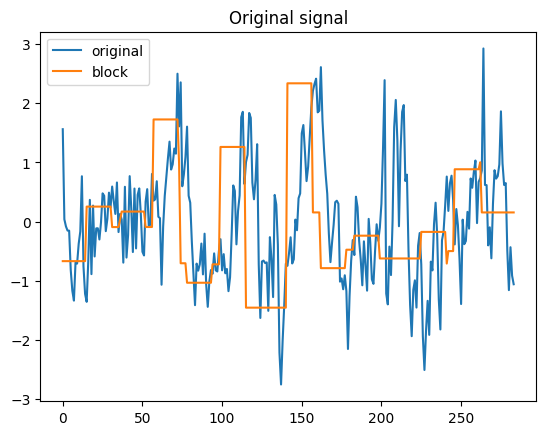

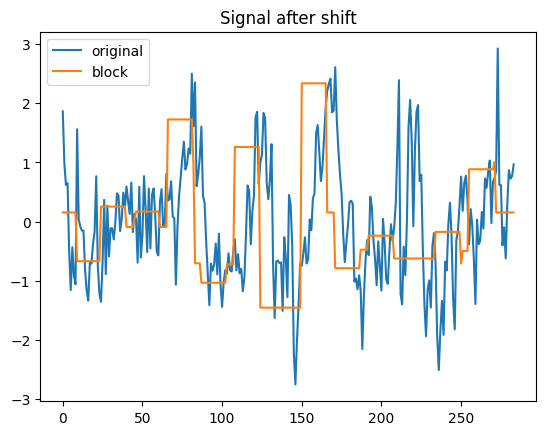

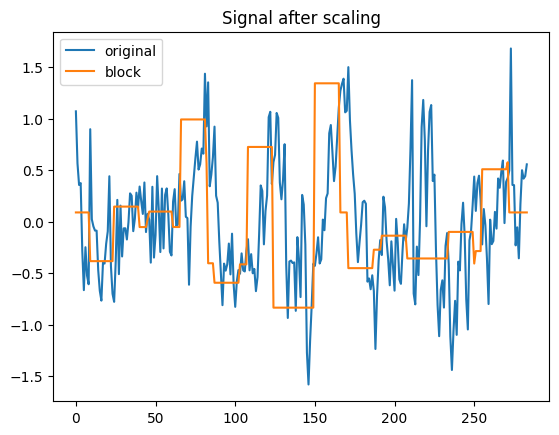

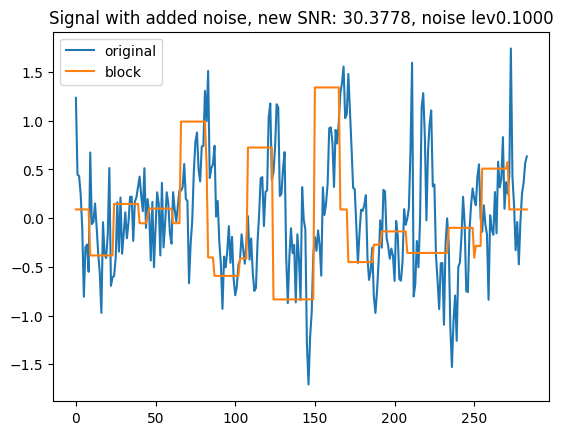

Processing: [#-------------------------------------------------] 2%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


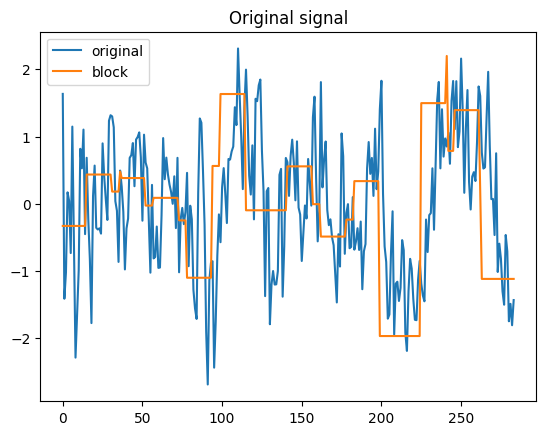

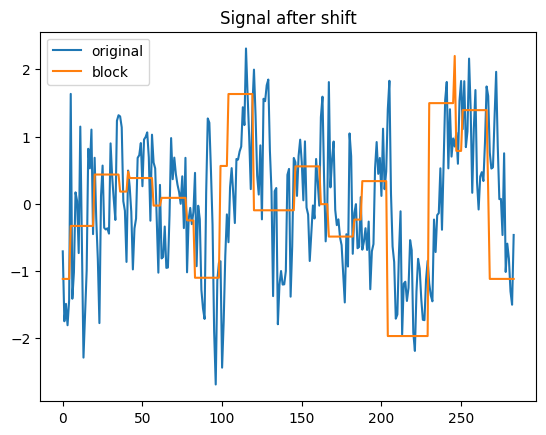

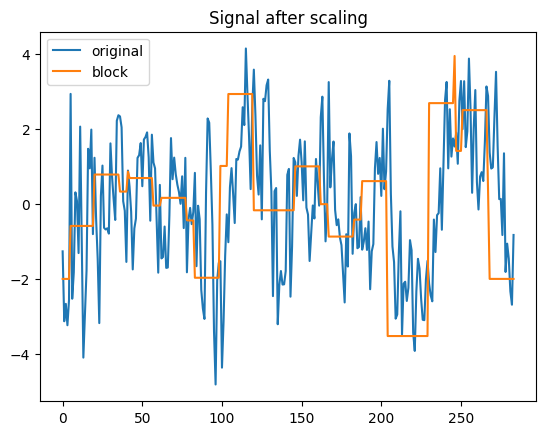

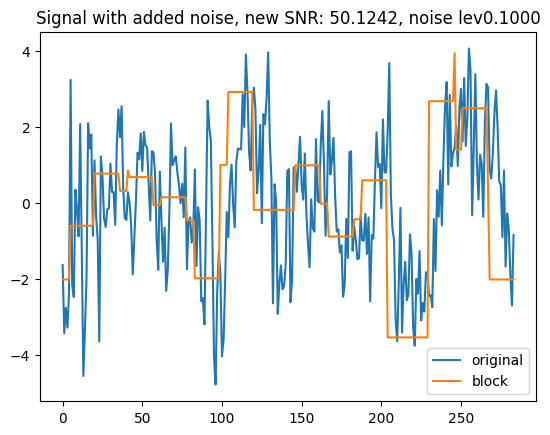

Processing: [##------------------------------------------------] 5%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


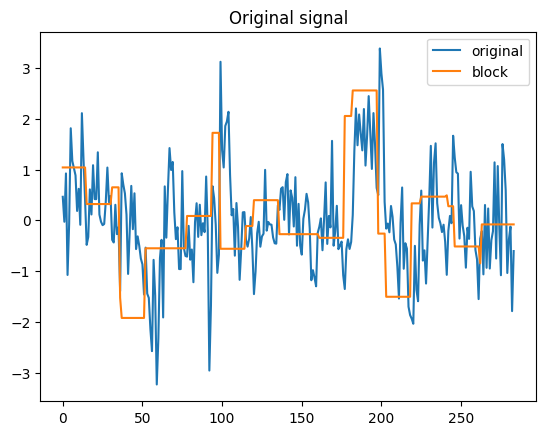

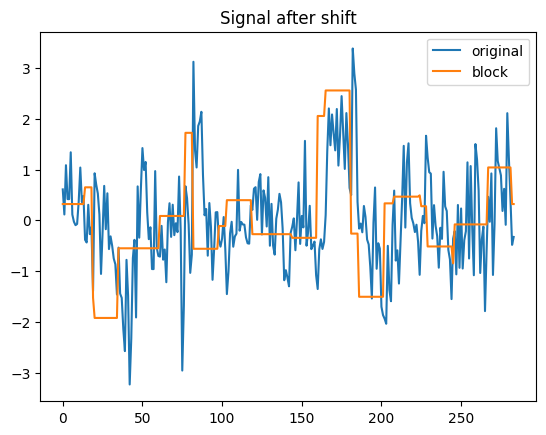

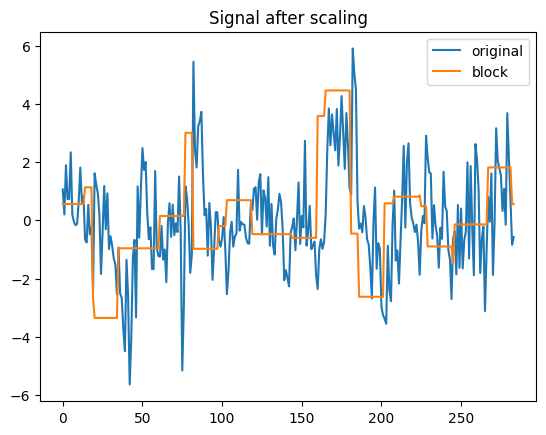

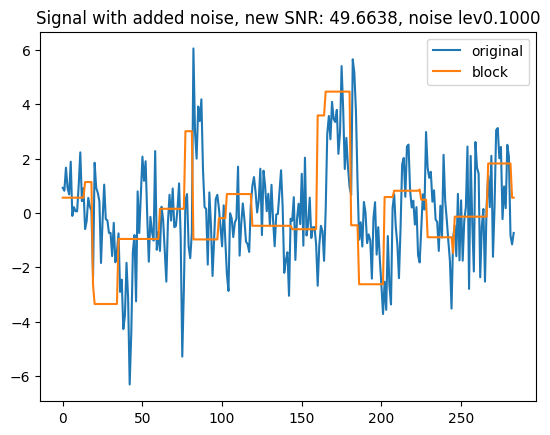

Processing: [####----------------------------------------------] 8%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


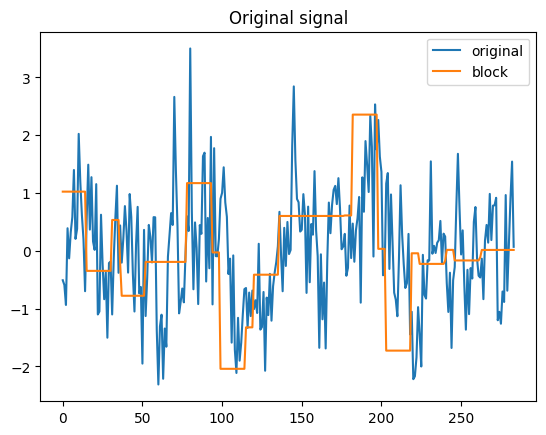

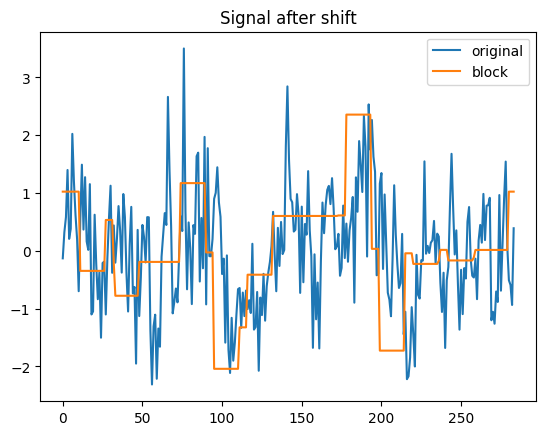

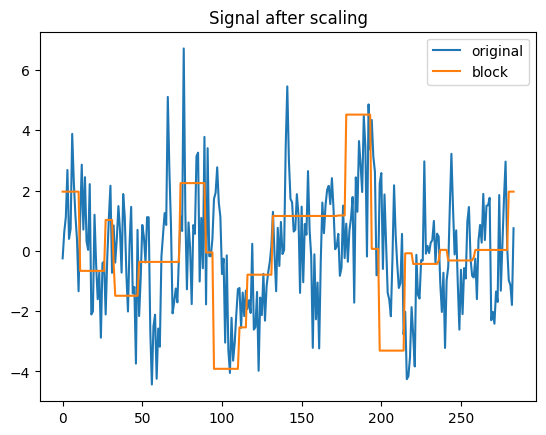

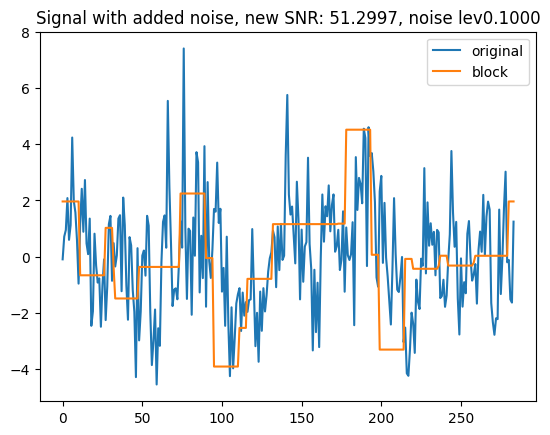

Processing: [#####---------------------------------------------] 11%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


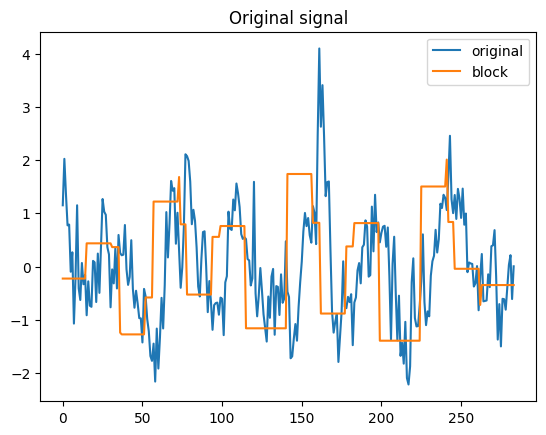

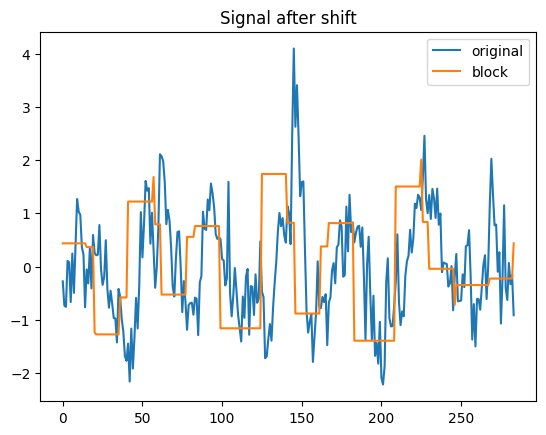

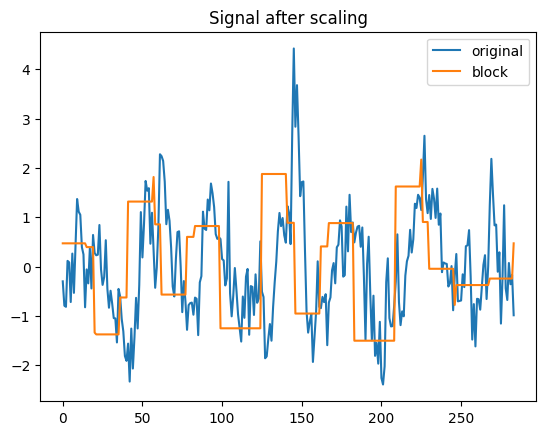

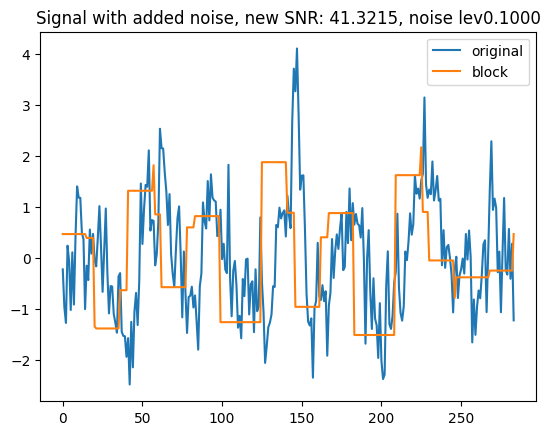

Processing: [######--------------------------------------------] 13%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


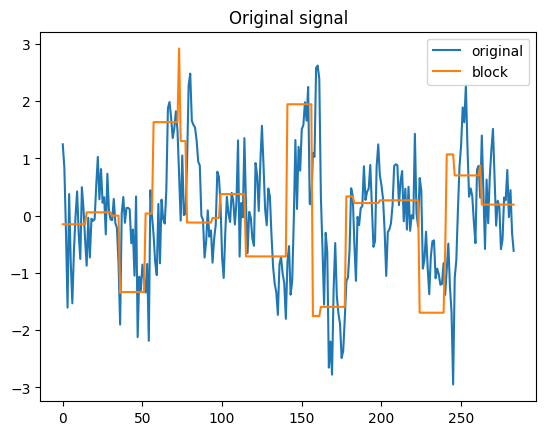

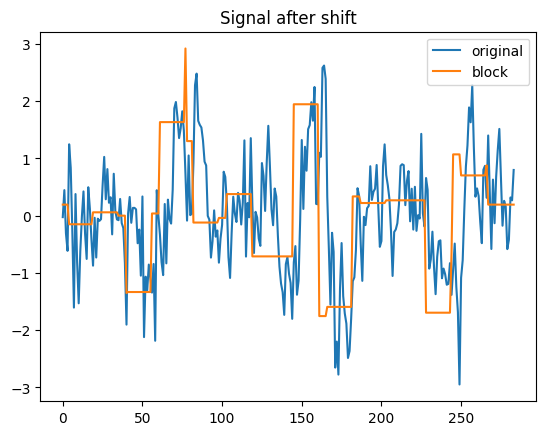

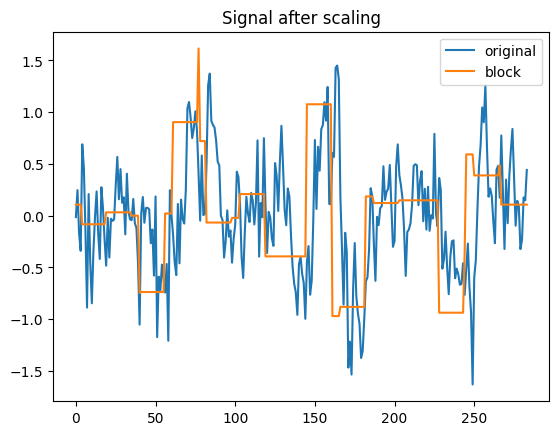

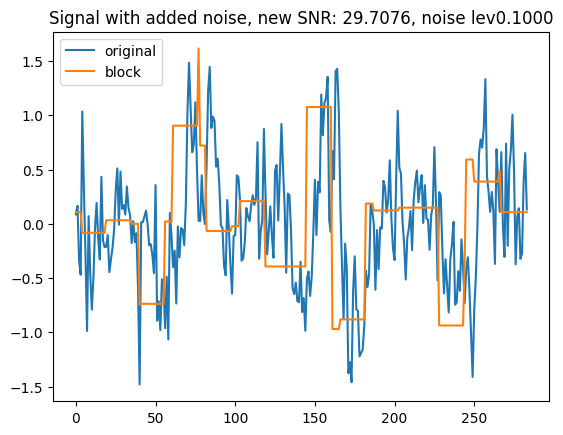

Processing: [########------------------------------------------] 16%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


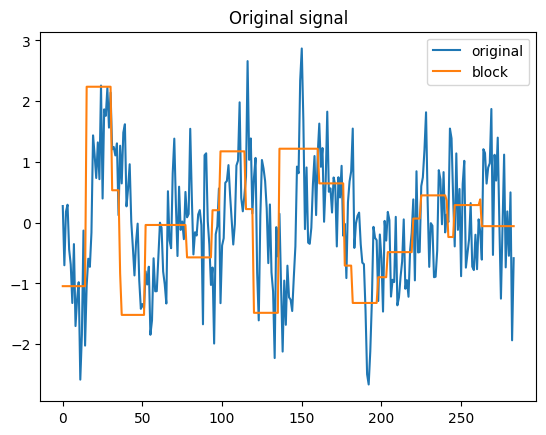

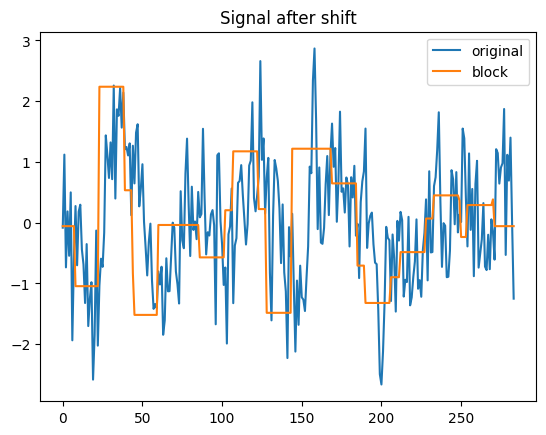

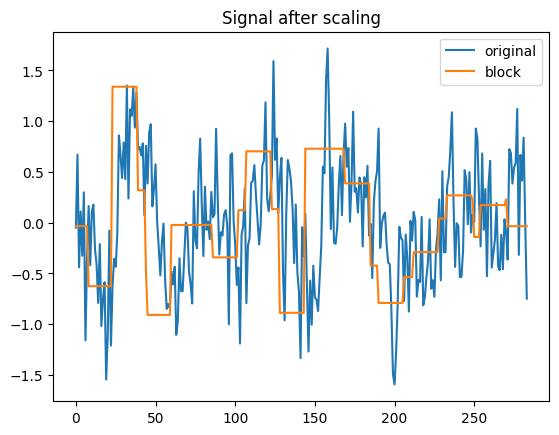

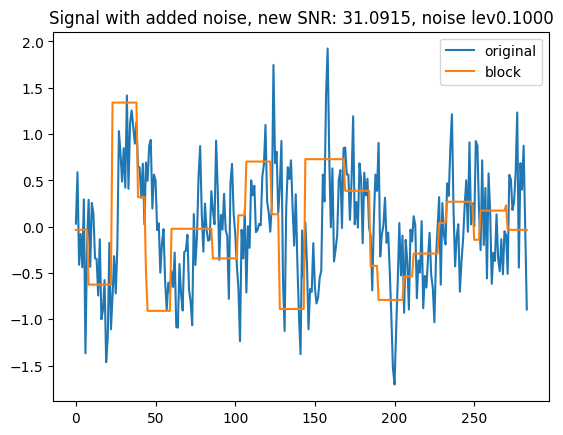

Processing: [#########-----------------------------------------] 19%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


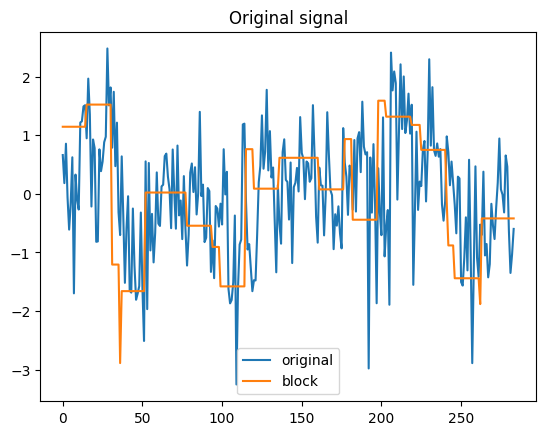

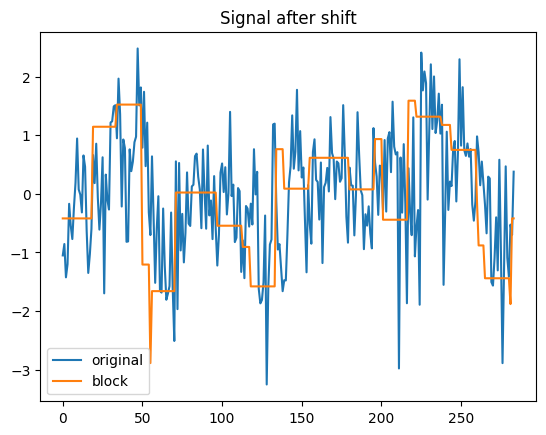

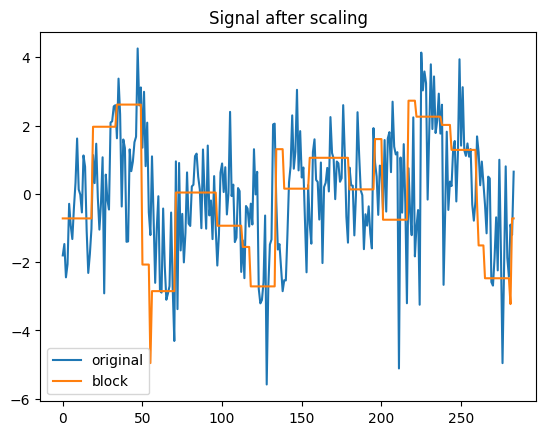

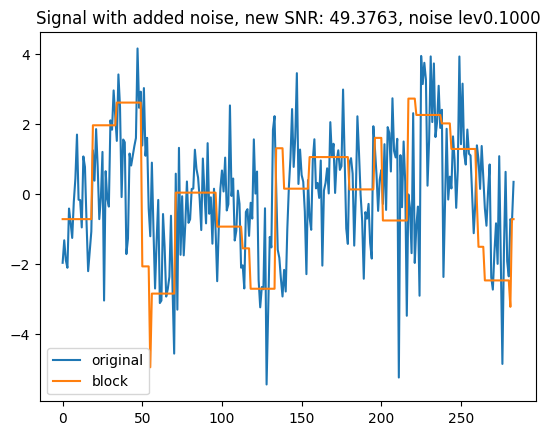

Processing: [###########---------------------------------------] 22%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


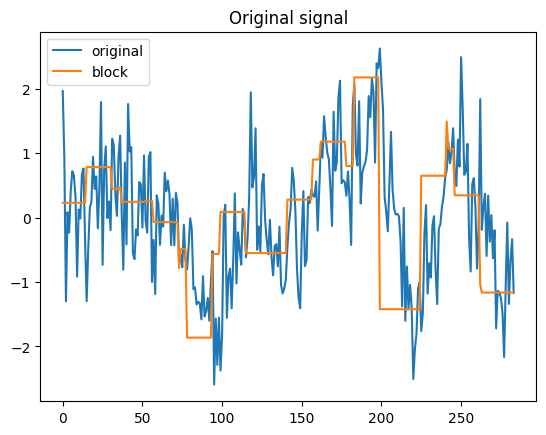

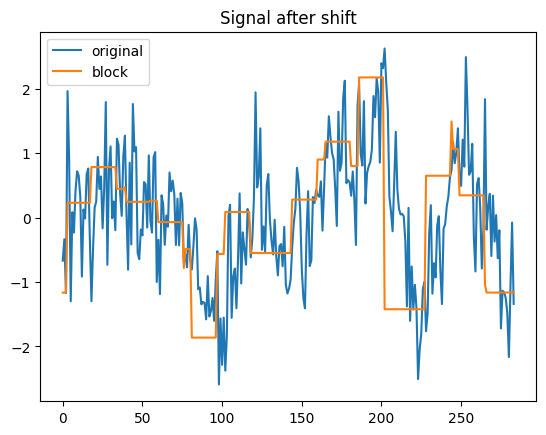

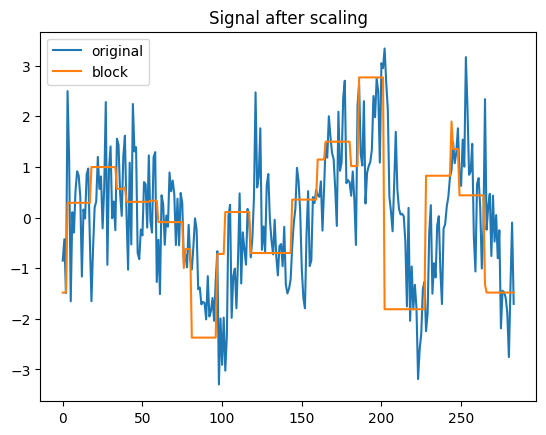

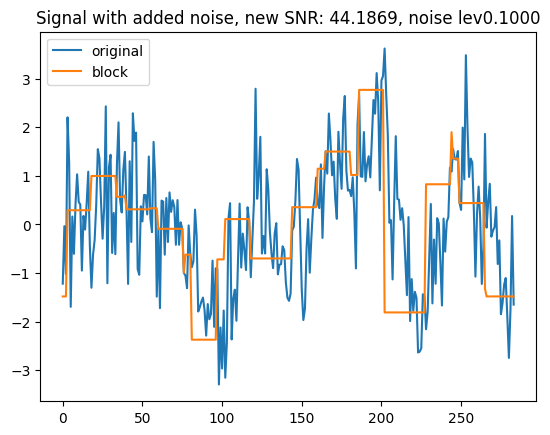

Processing: [############--------------------------------------] 25%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


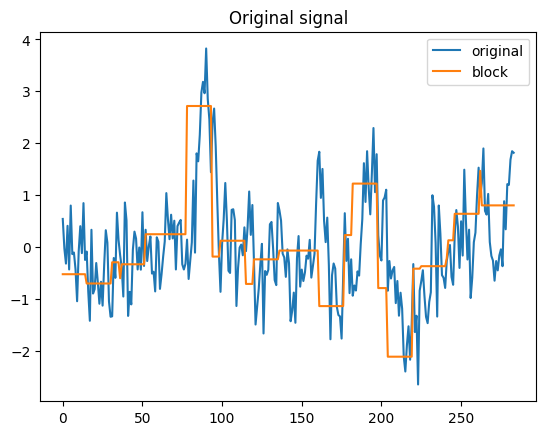

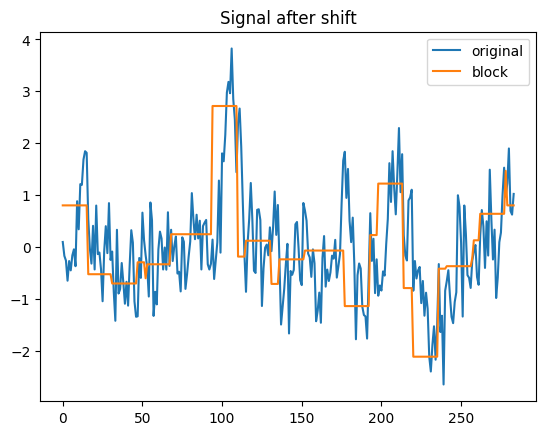

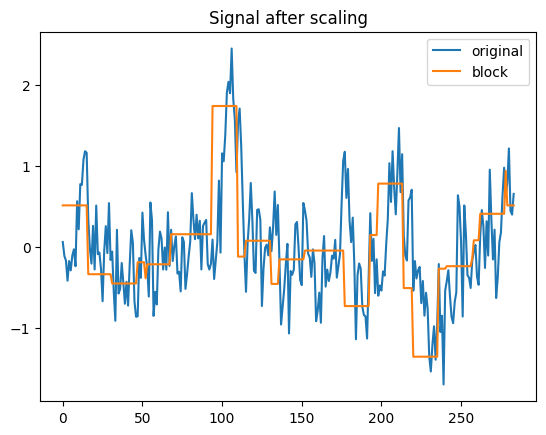

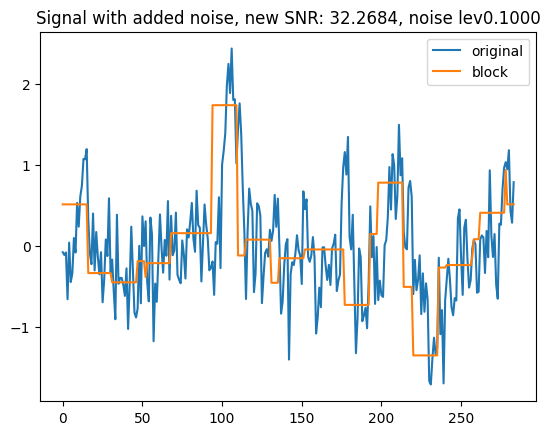

Processing: [#############-------------------------------------] 27%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


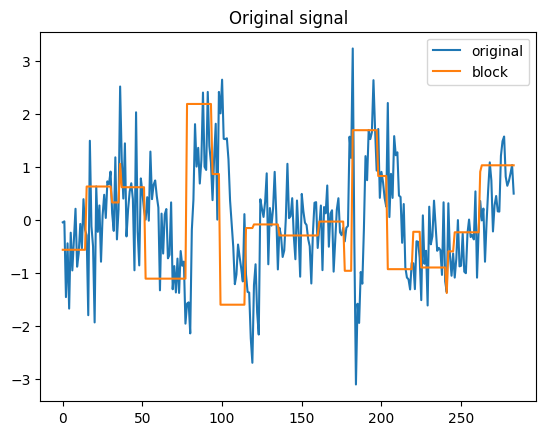

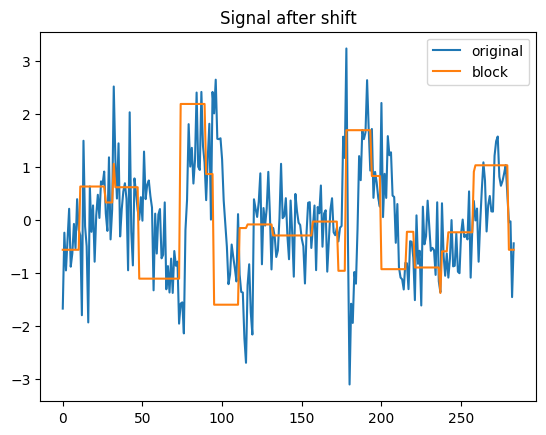

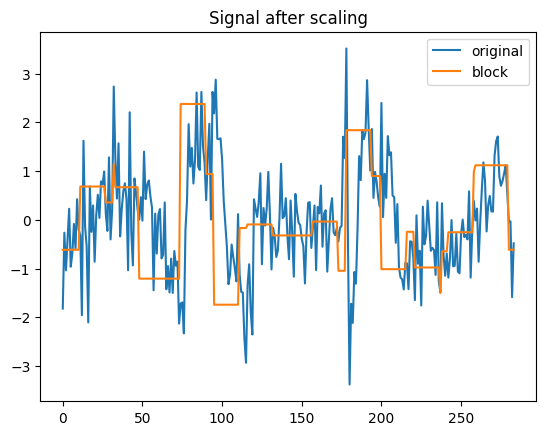

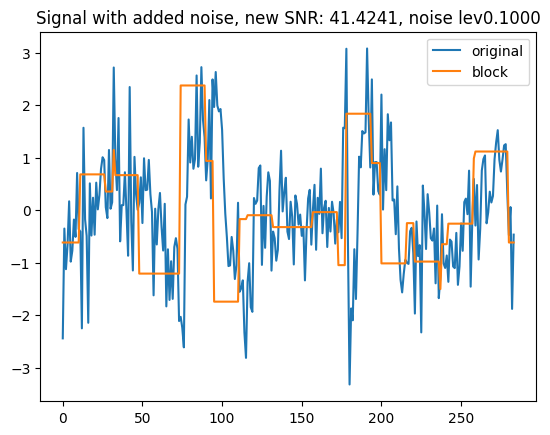

Processing: [###############-----------------------------------] 30%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


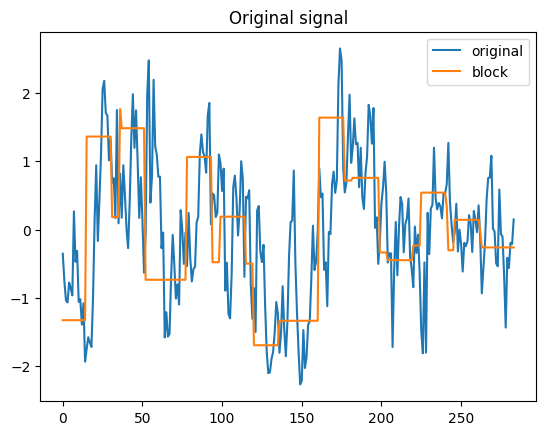

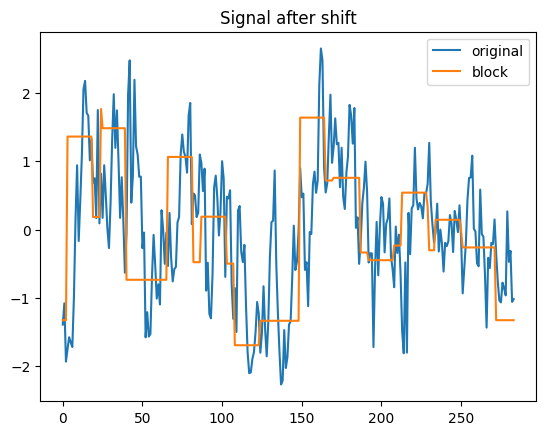

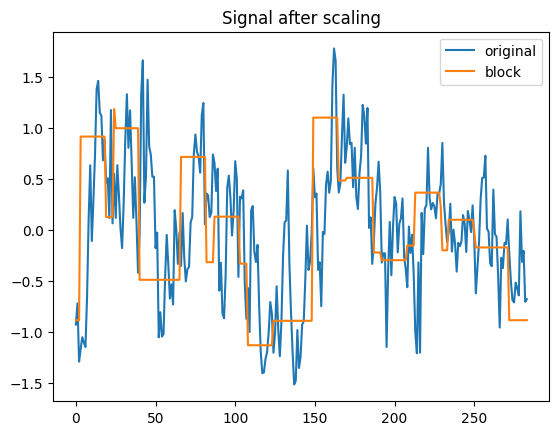

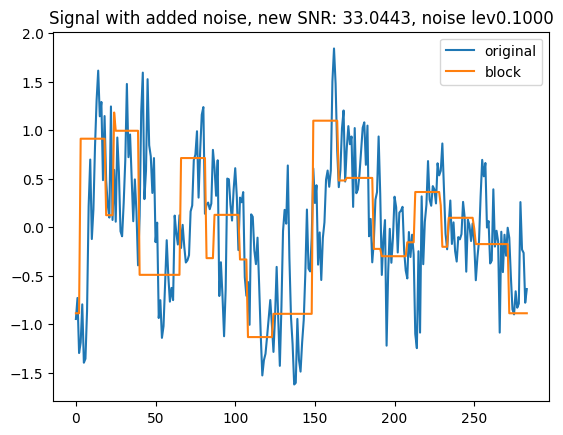

Processing: [################----------------------------------] 33%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


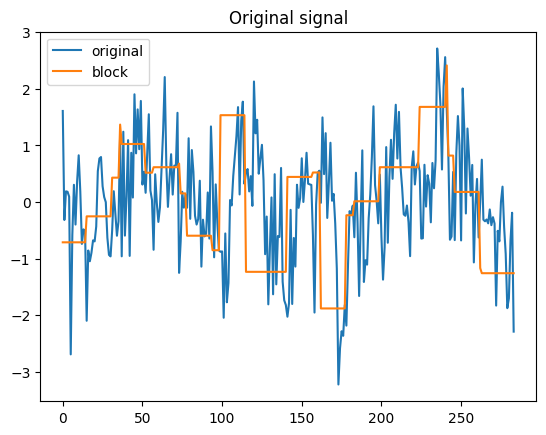

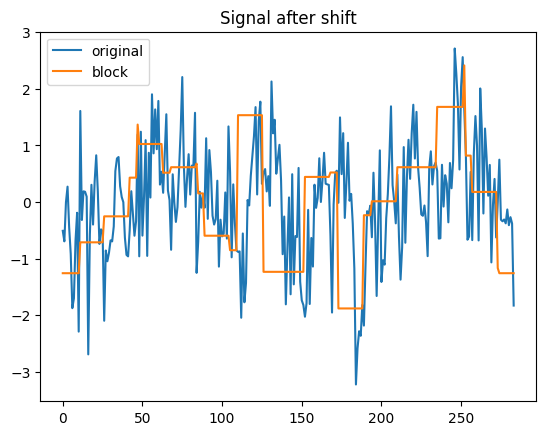

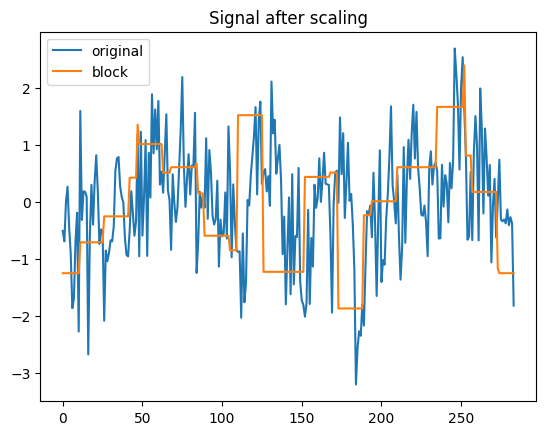

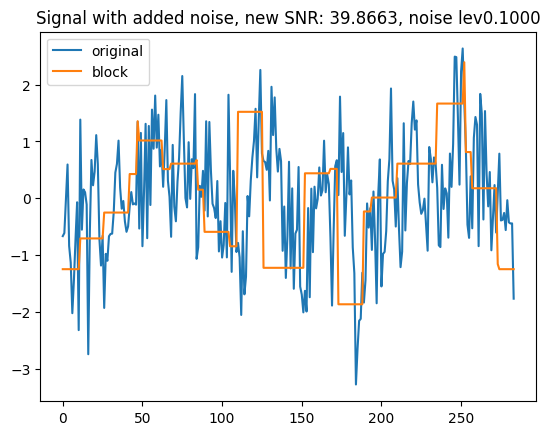

Processing: [##################--------------------------------] 36%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


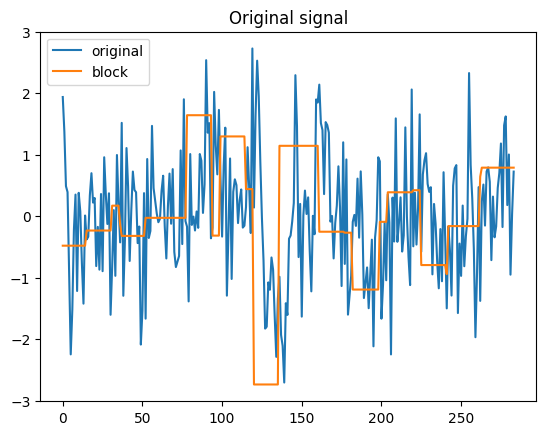

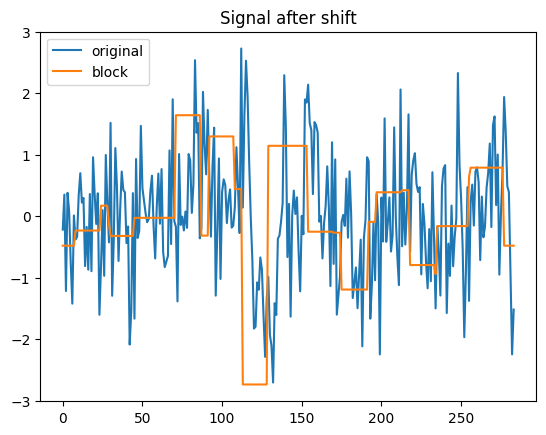

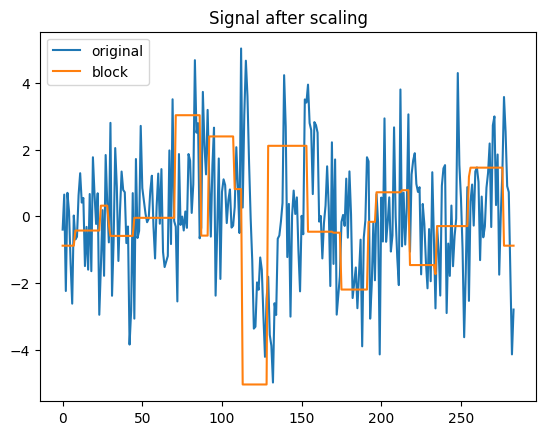

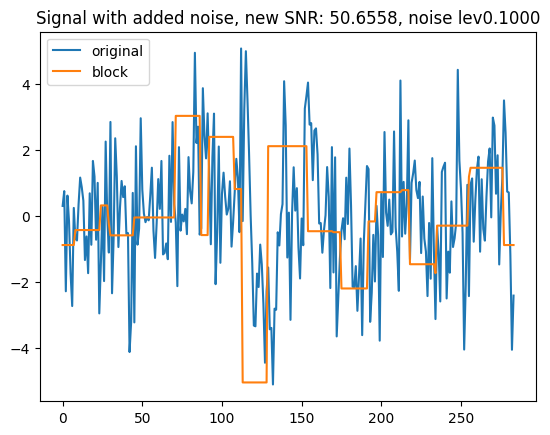

Processing: [###################-------------------------------] 38%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


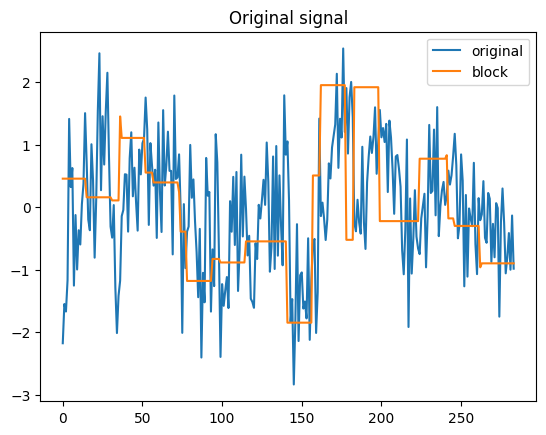

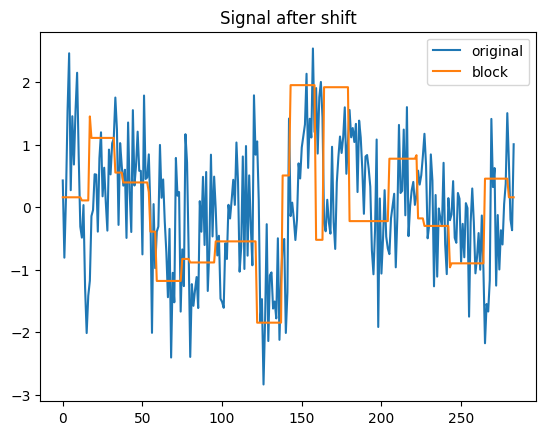

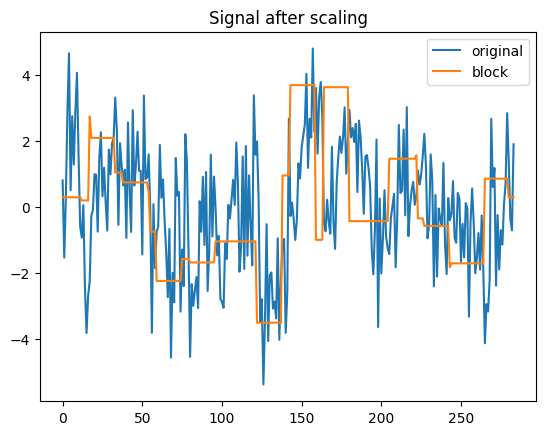

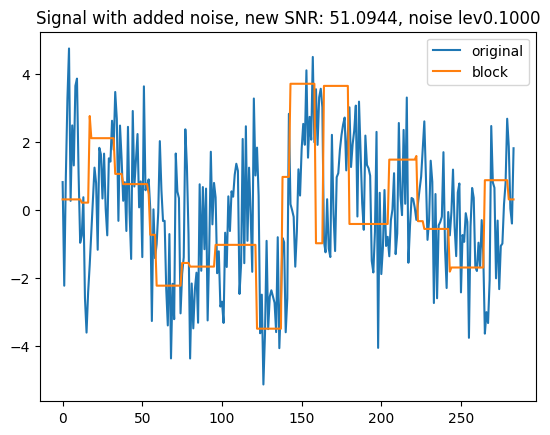

Processing: [####################------------------------------] 41%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


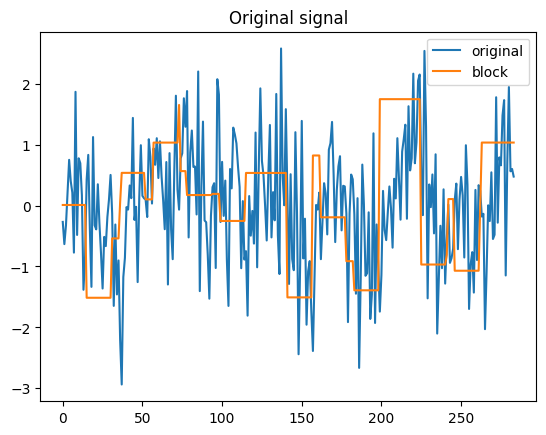

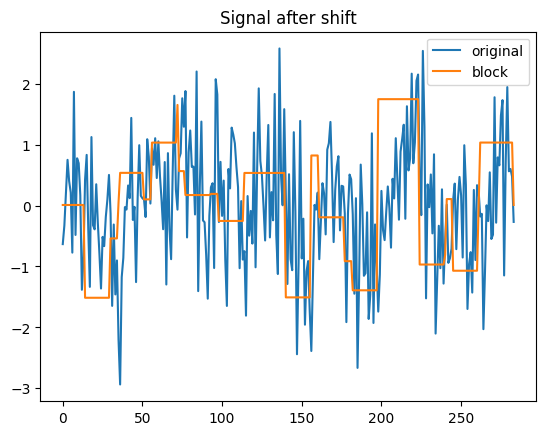

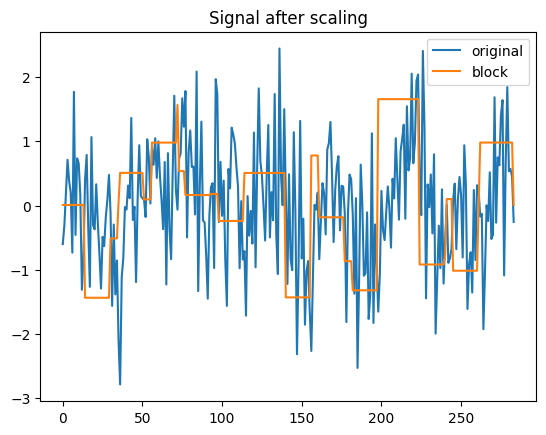

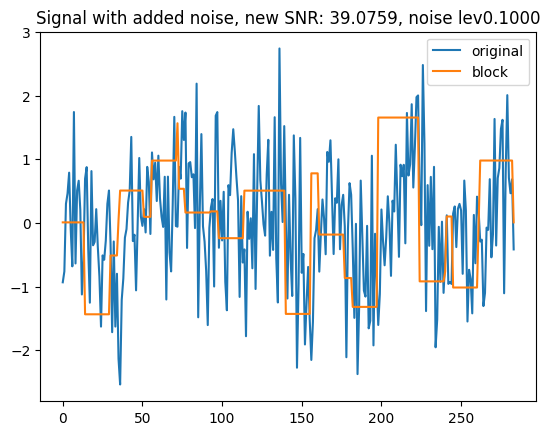

Processing: [######################----------------------------] 44%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


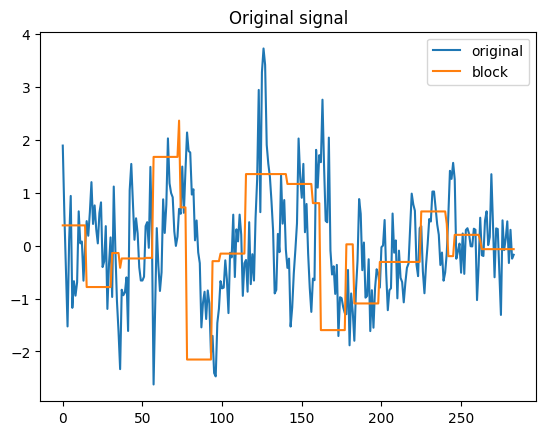

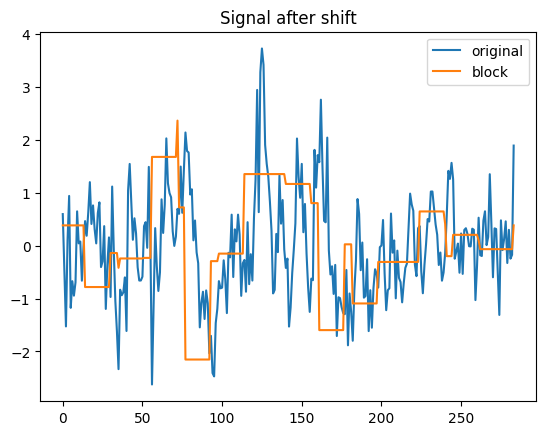

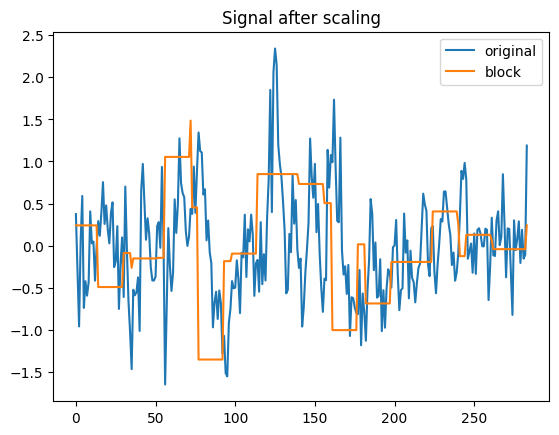

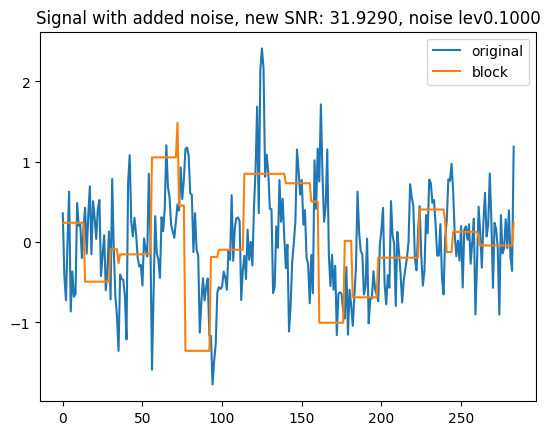

Processing: [#######################---------------------------] 47%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


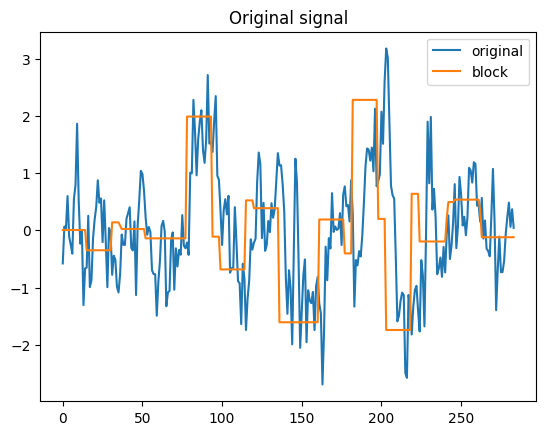

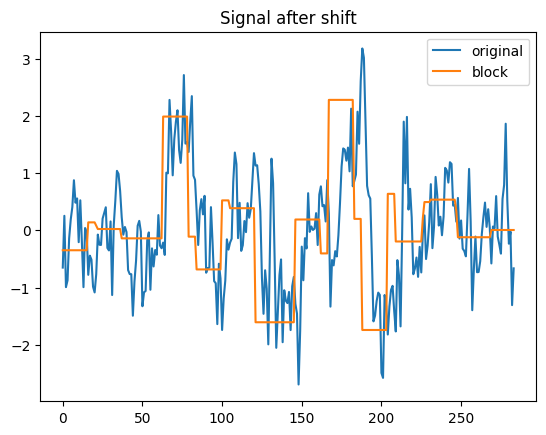

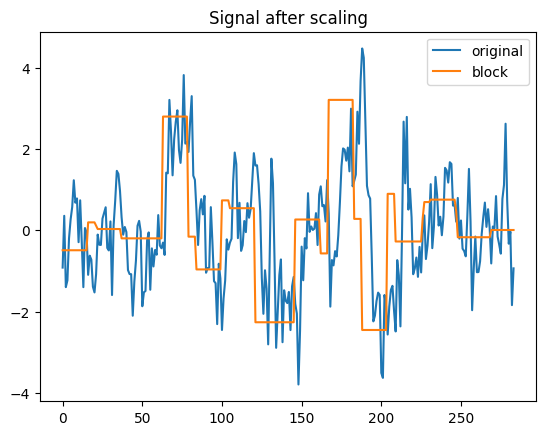

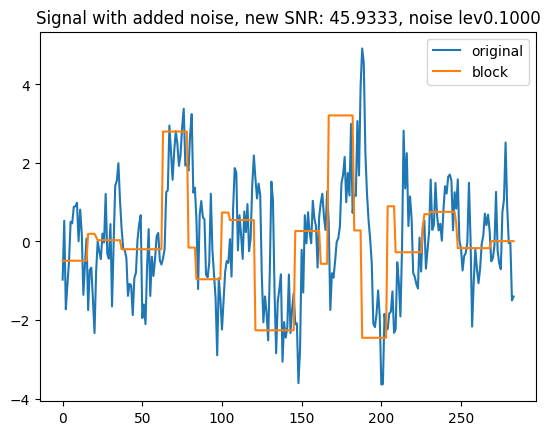

Processing: [#########################-------------------------] 50%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


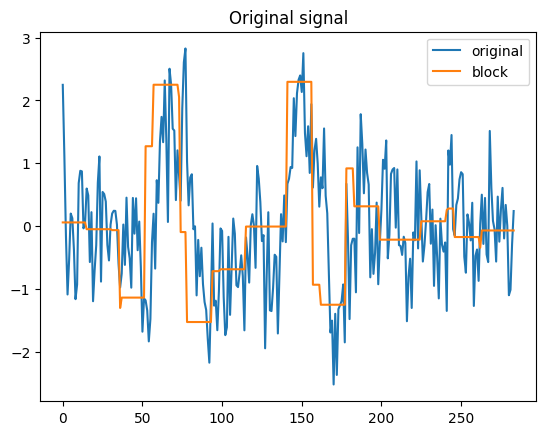

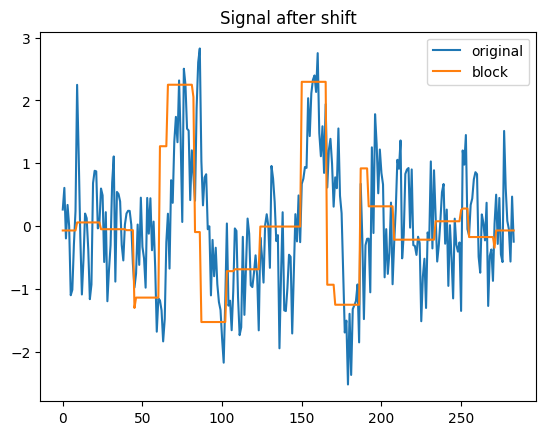

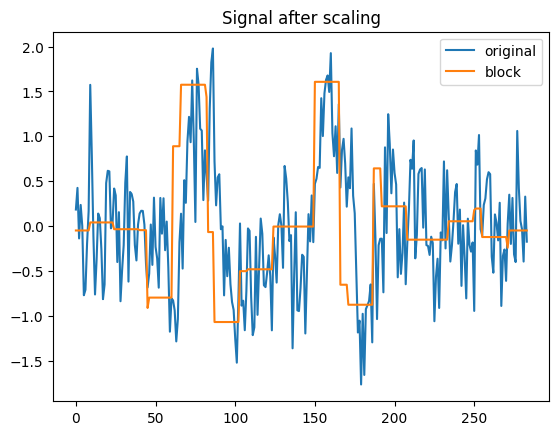

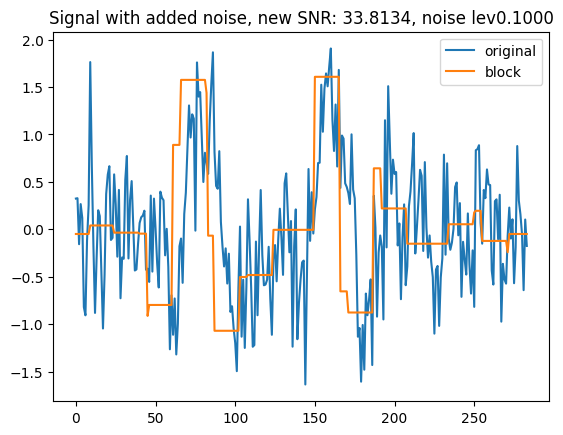

Processing: [##########################------------------------] 52%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


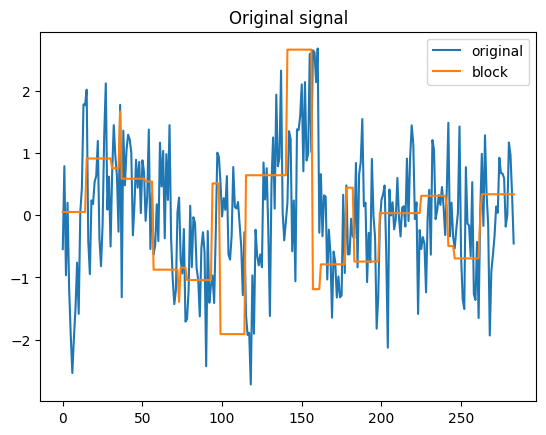

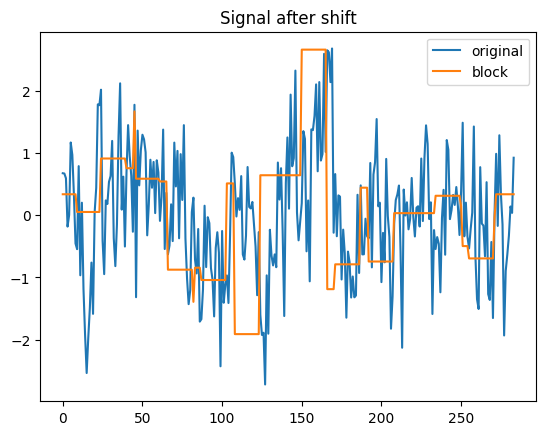

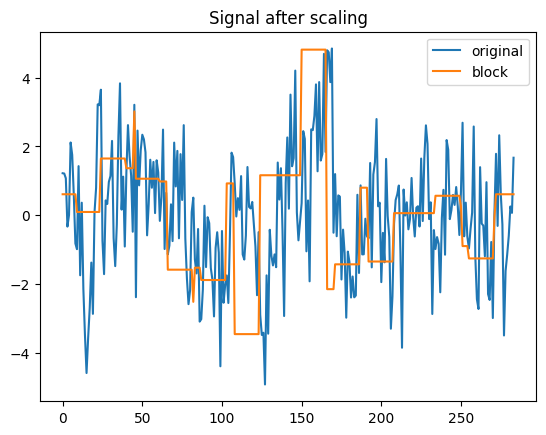

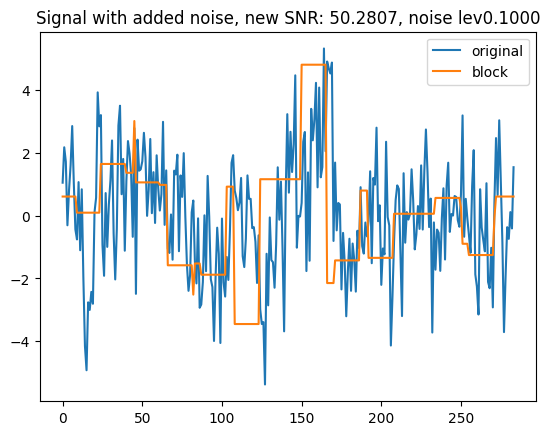

Processing: [###########################-----------------------] 55%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


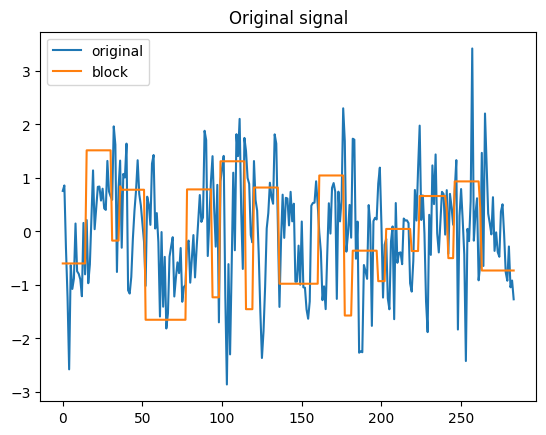

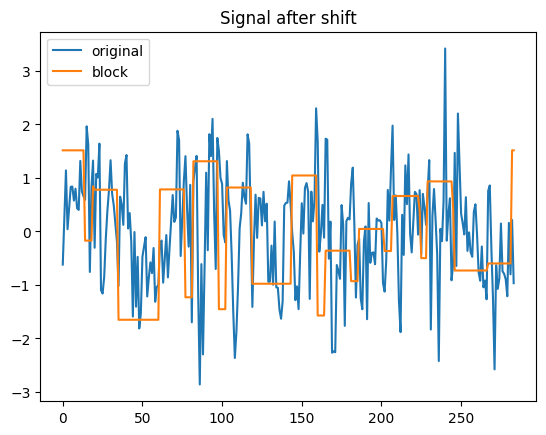

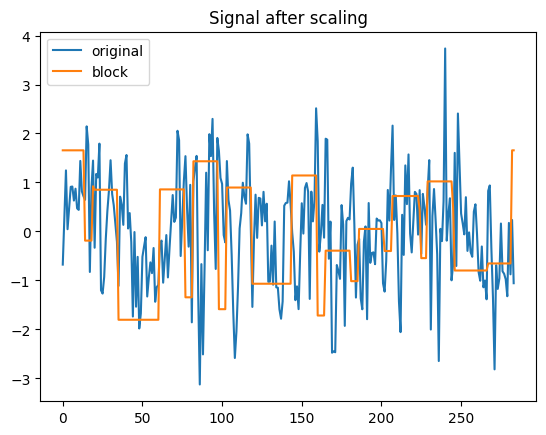

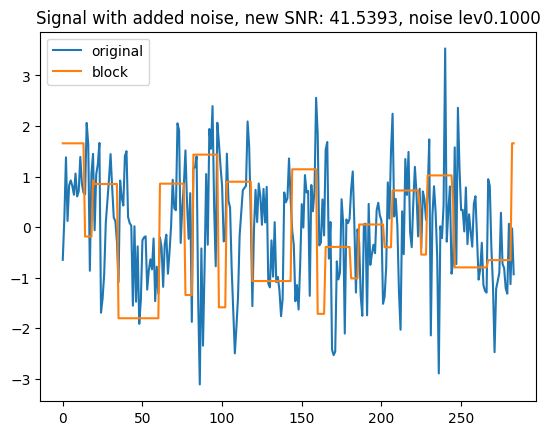

Processing: [#############################---------------------] 58%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


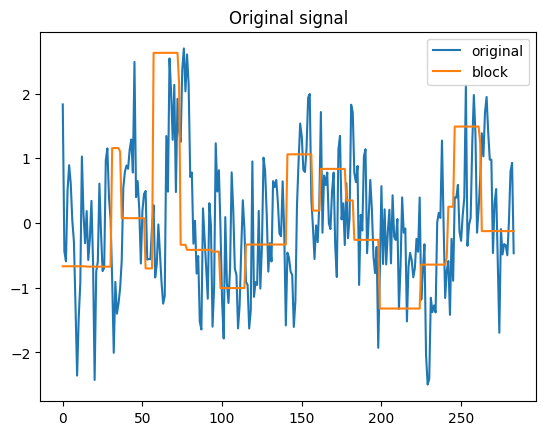

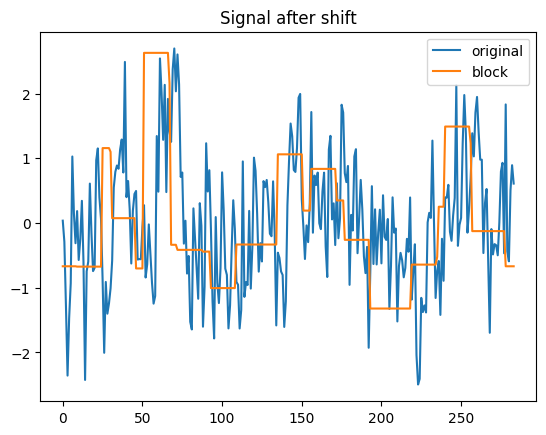

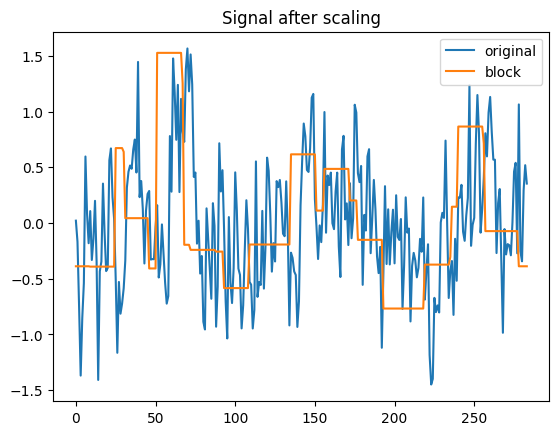

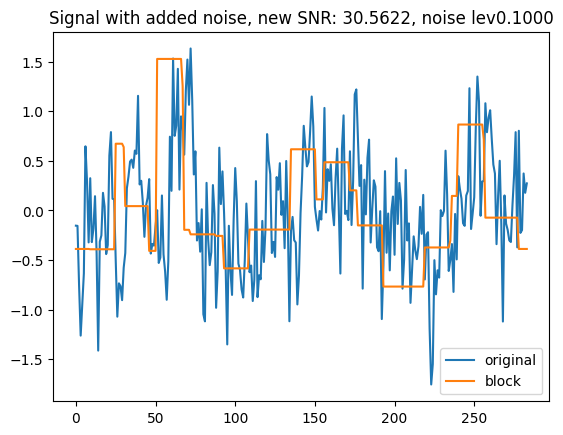

Processing: [##############################--------------------] 61%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


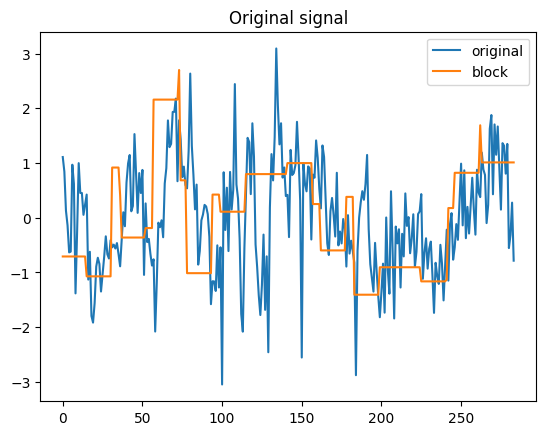

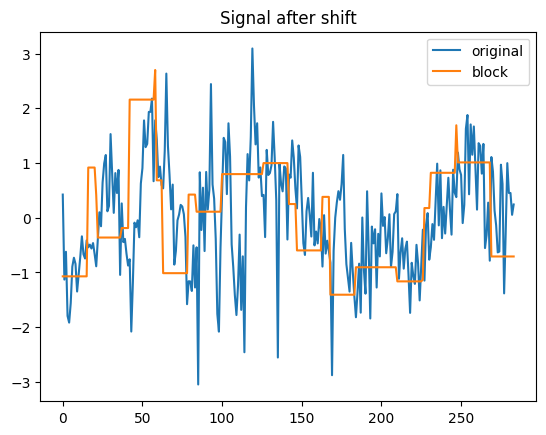

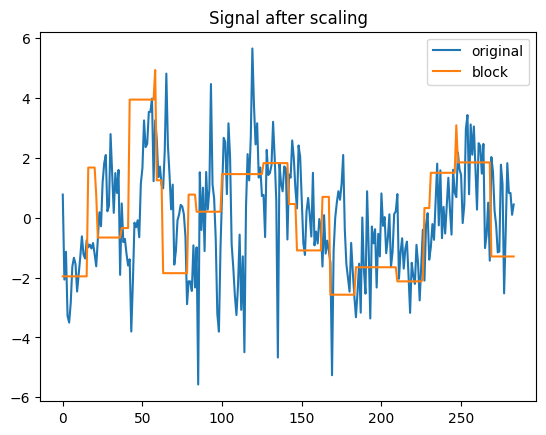

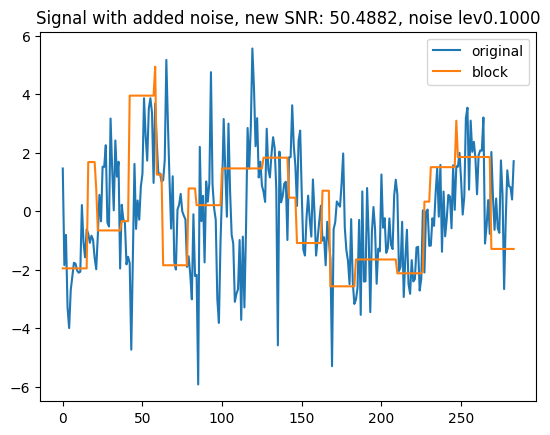

Processing: [###############################-------------------] 63%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


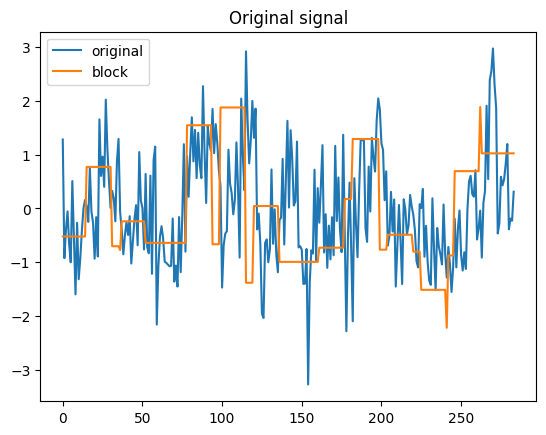

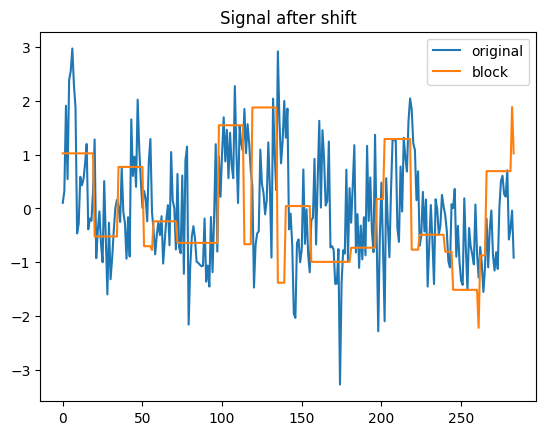

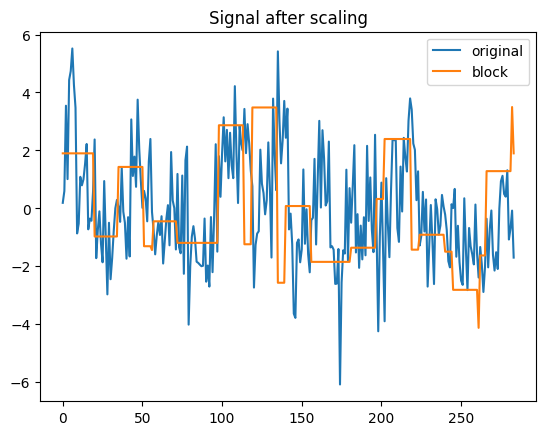

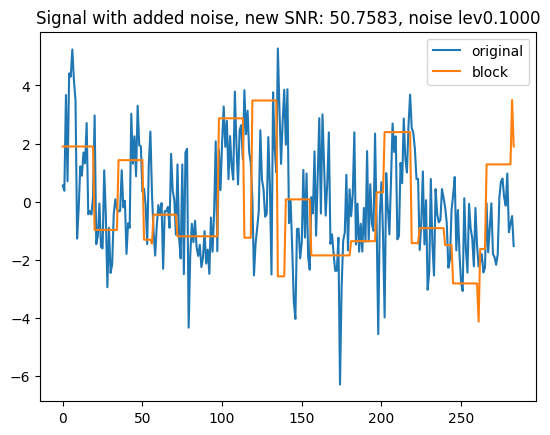

Processing: [#################################-----------------] 66%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


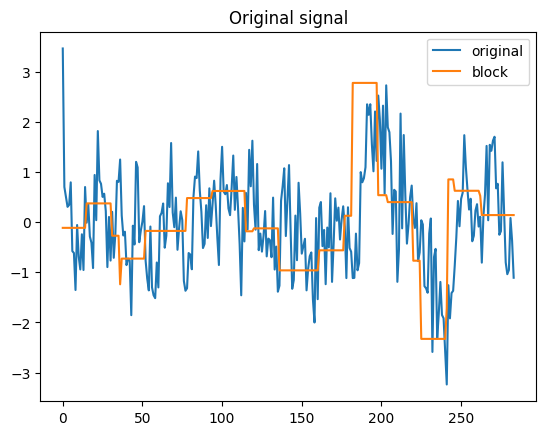

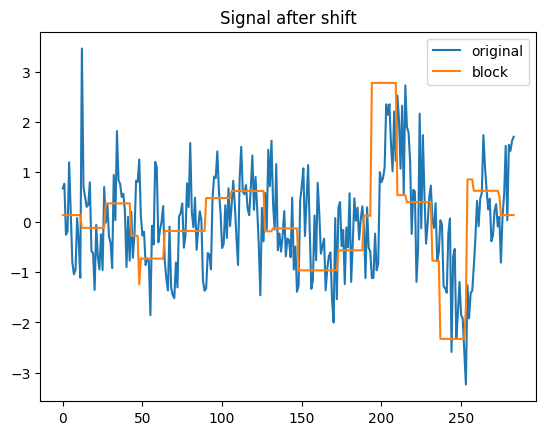

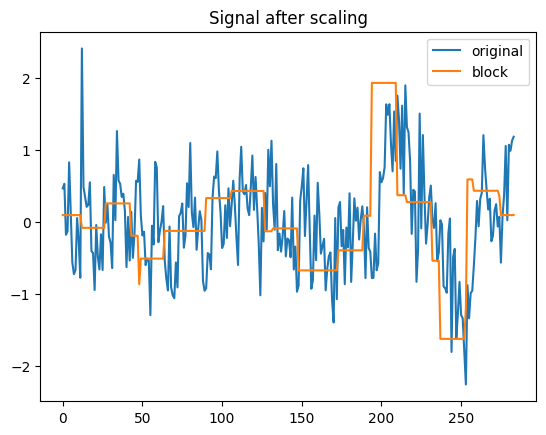

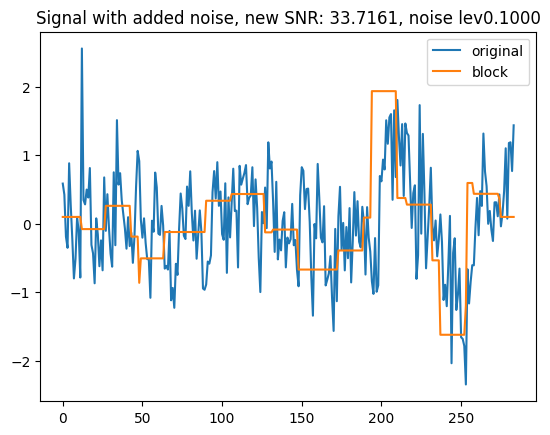

Processing: [##################################----------------] 69%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


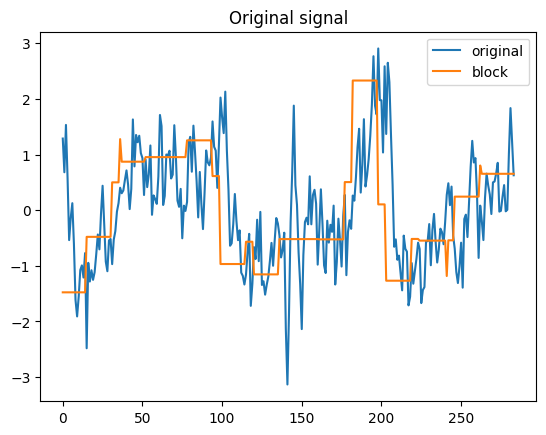

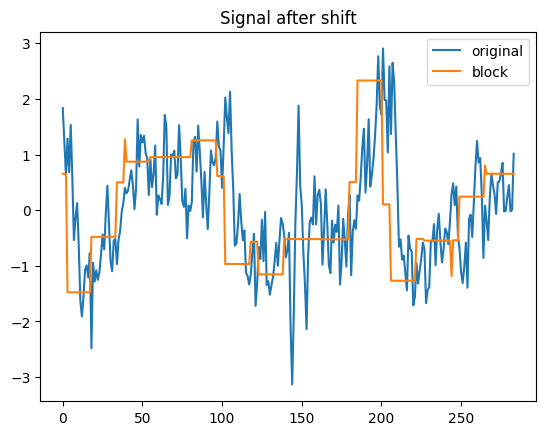

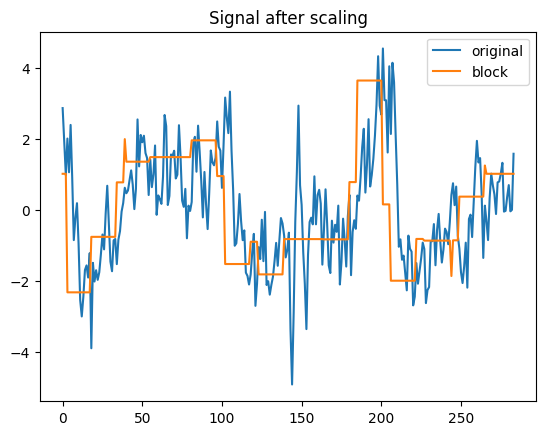

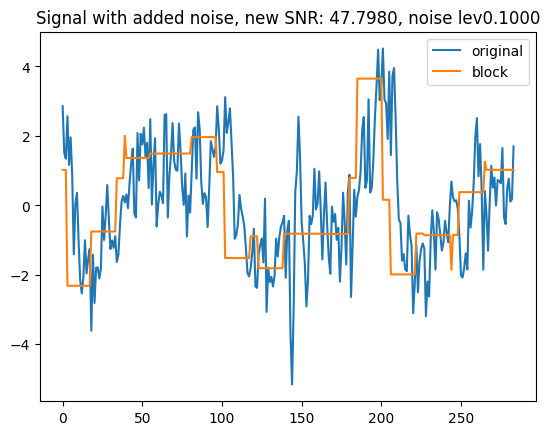

Processing: [####################################--------------] 72%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


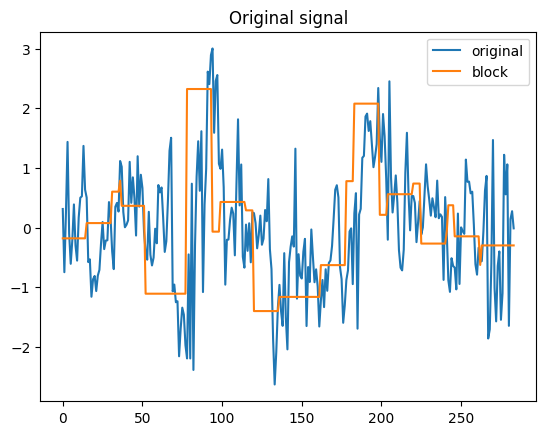

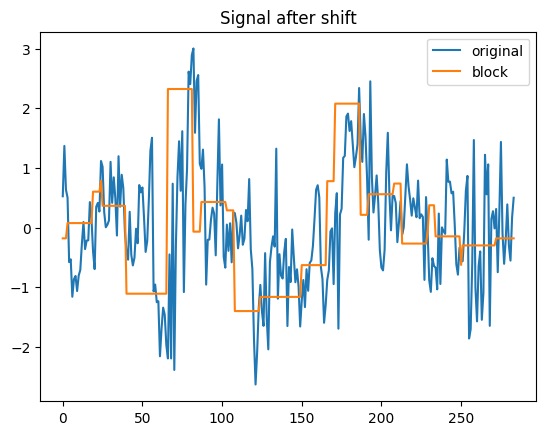

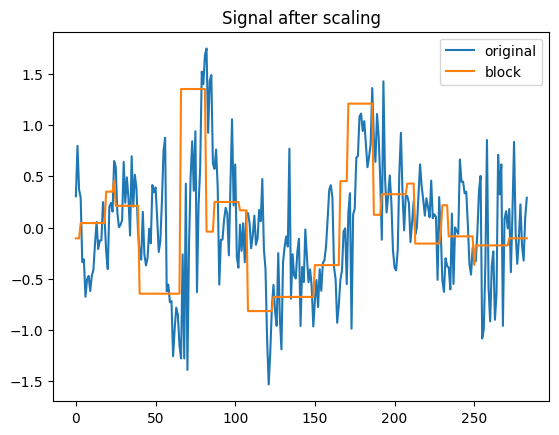

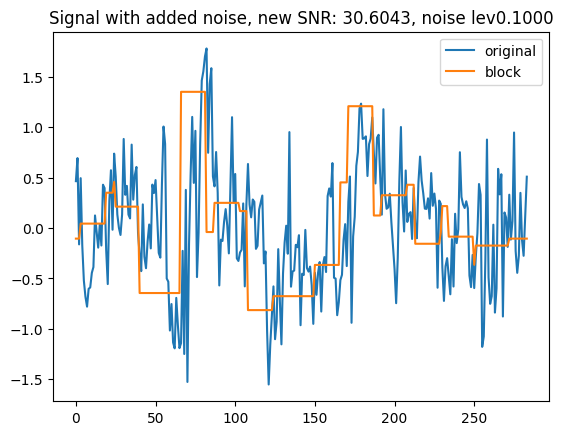

Processing: [#####################################-------------] 75%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


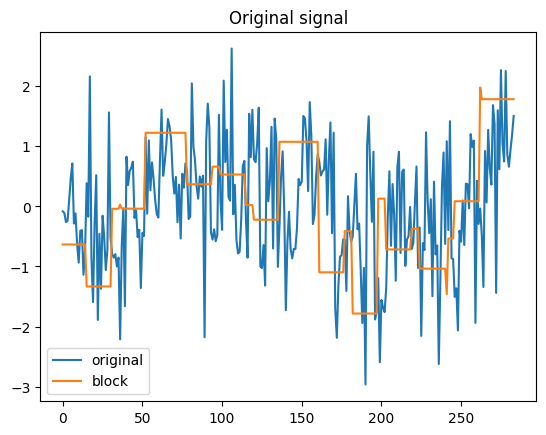

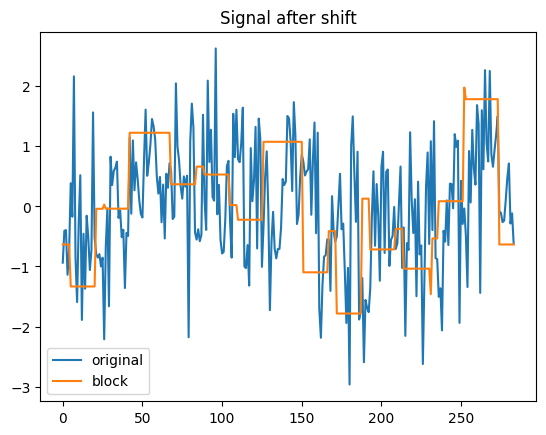

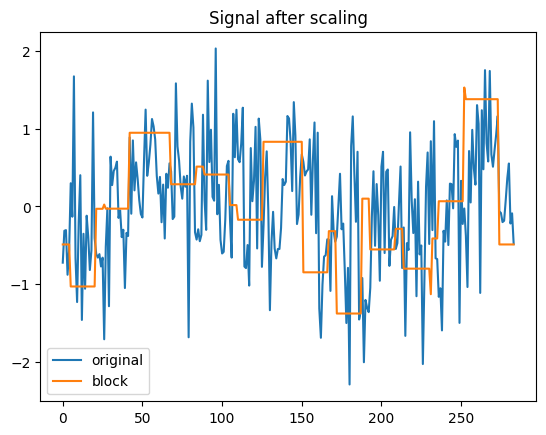

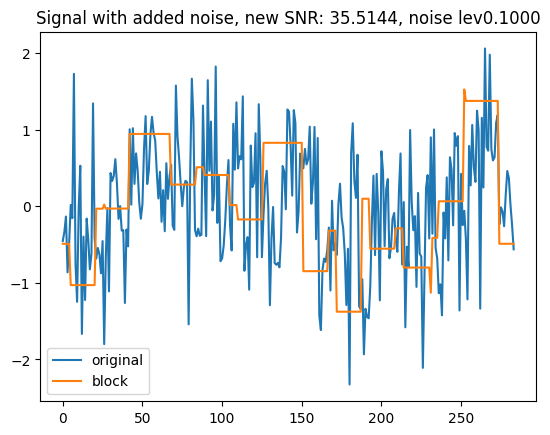

Processing: [######################################------------] 77%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


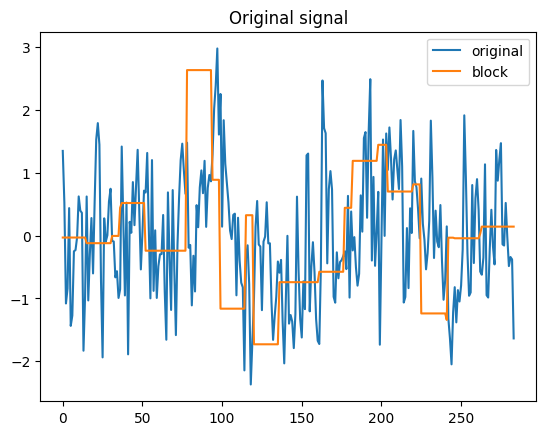

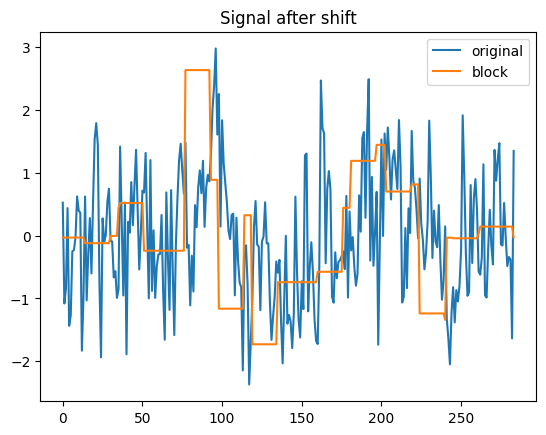

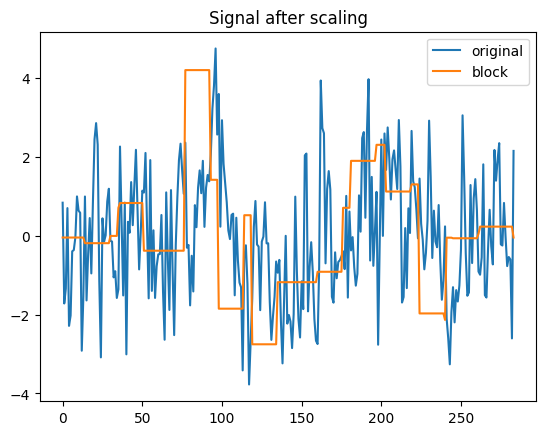

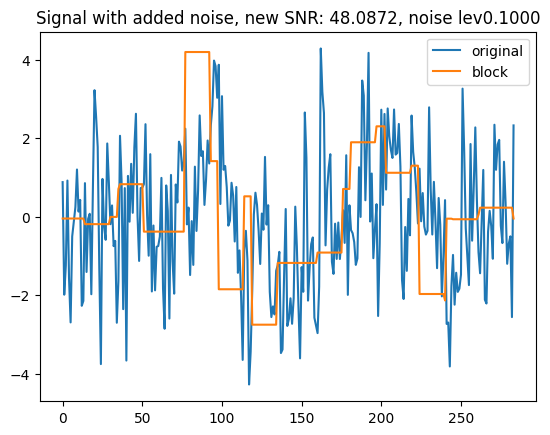

Processing: [########################################----------] 80%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


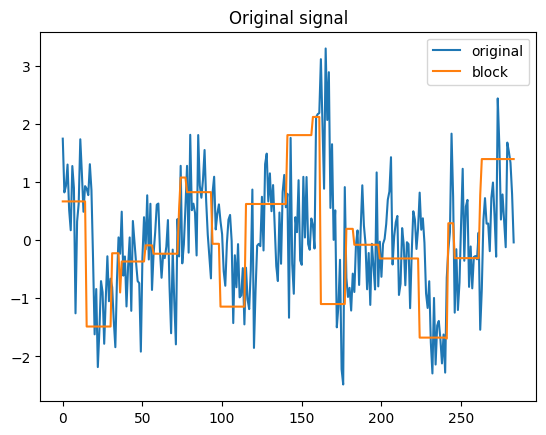

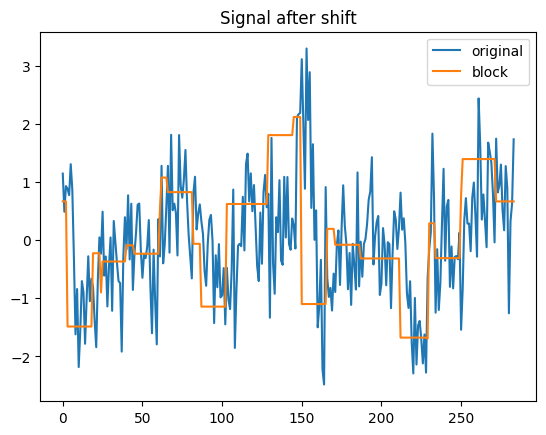

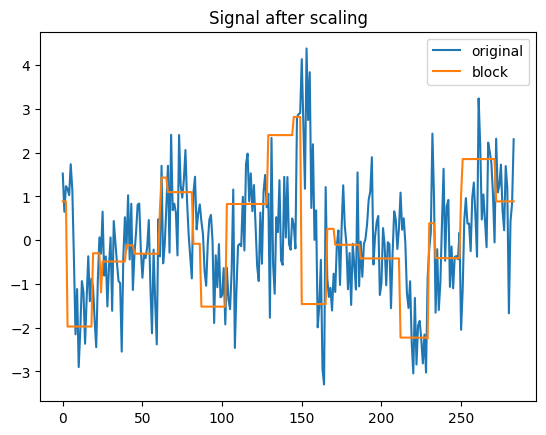

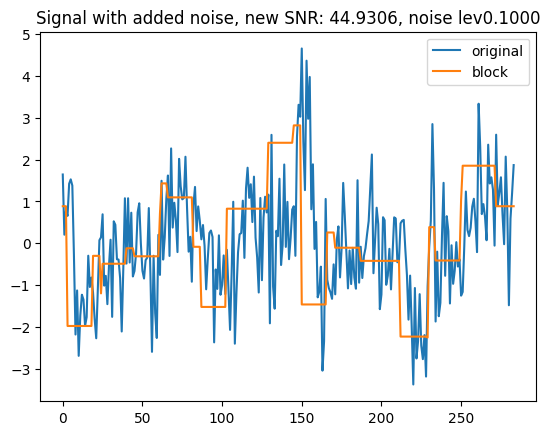

Processing: [#########################################---------] 83%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


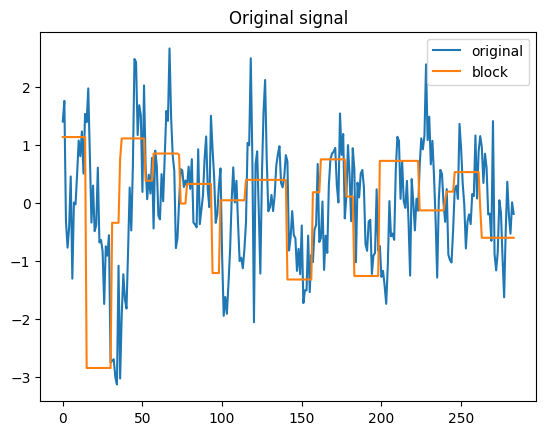

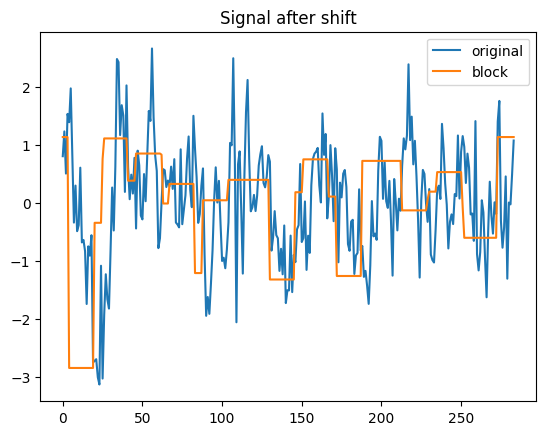

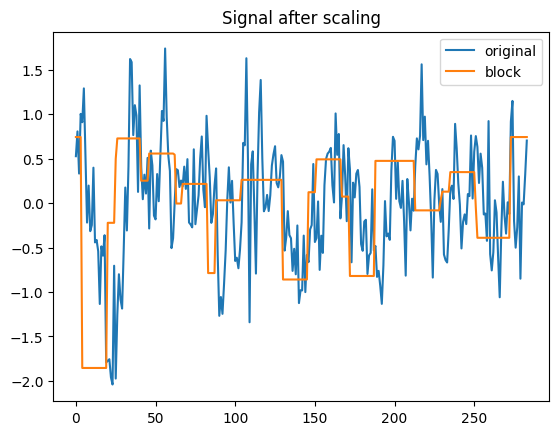

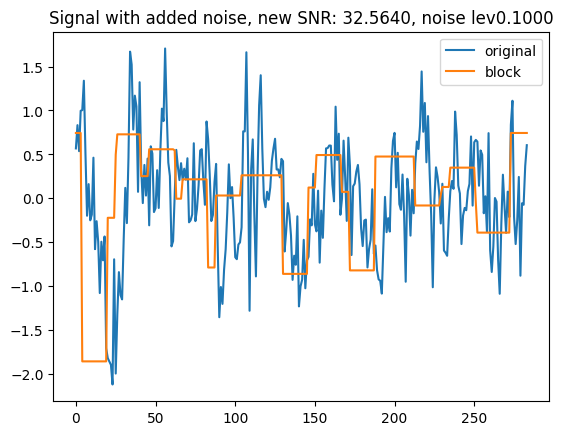

Processing: [###########################################-------] 86%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


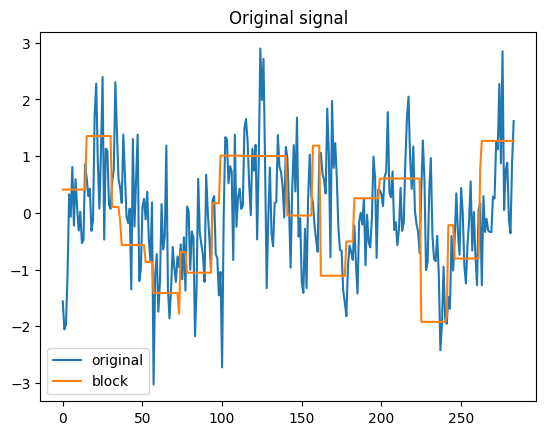

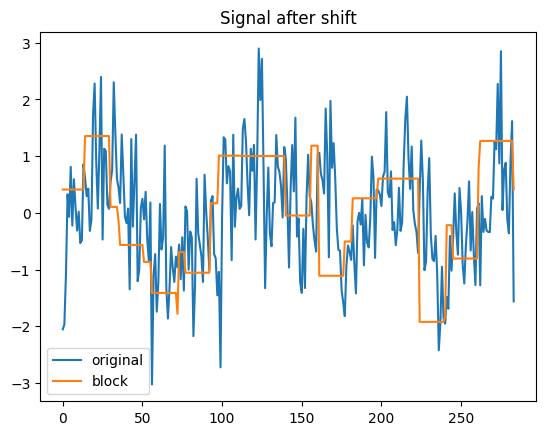

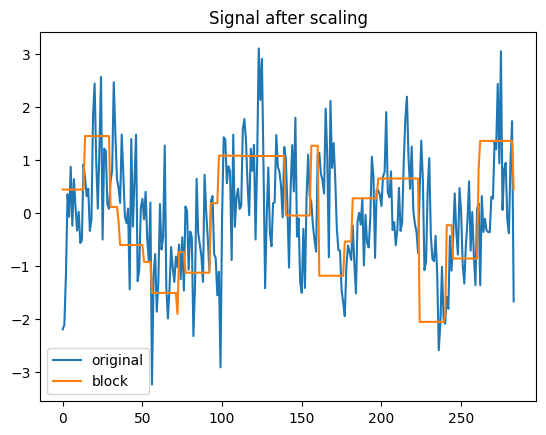

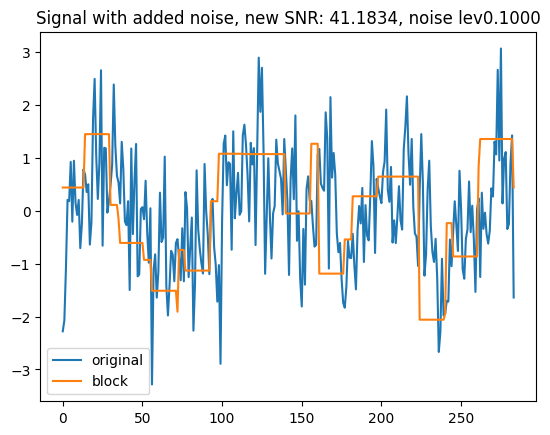

Processing: [############################################------] 88%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


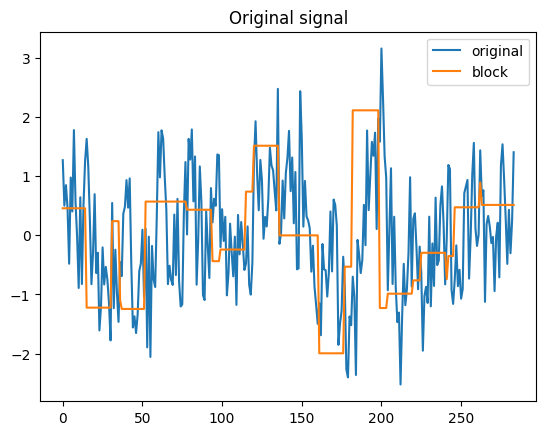

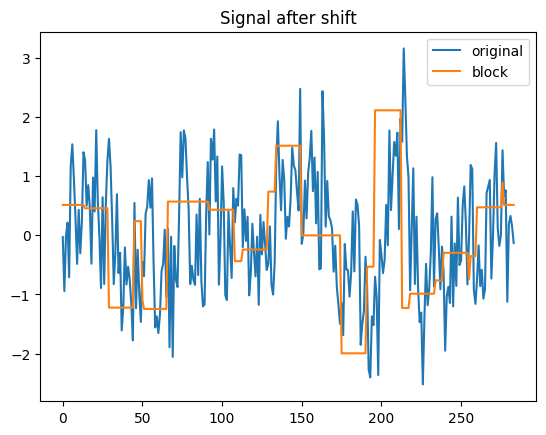

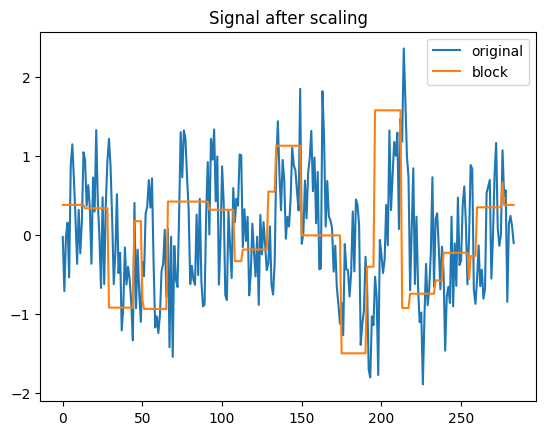

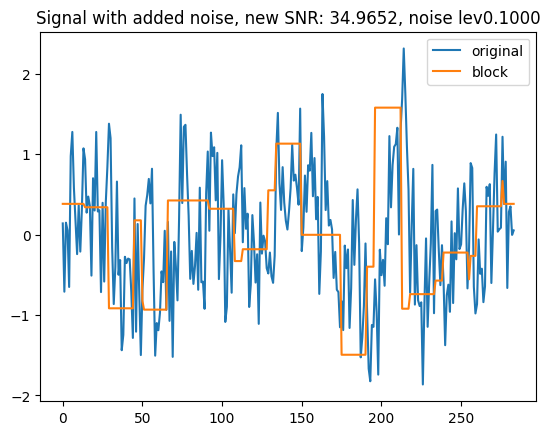

Processing: [#############################################-----] 91%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


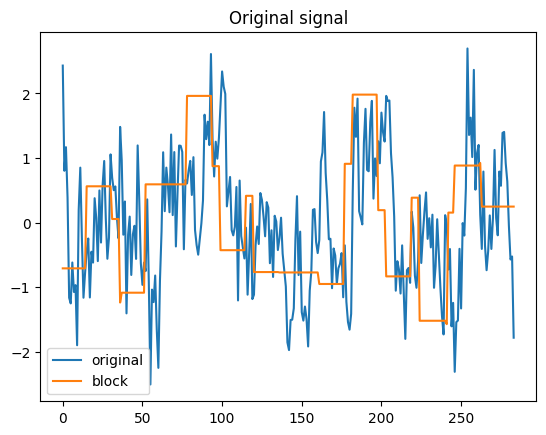

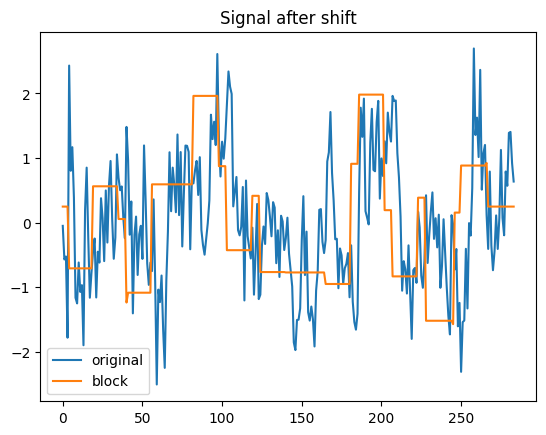

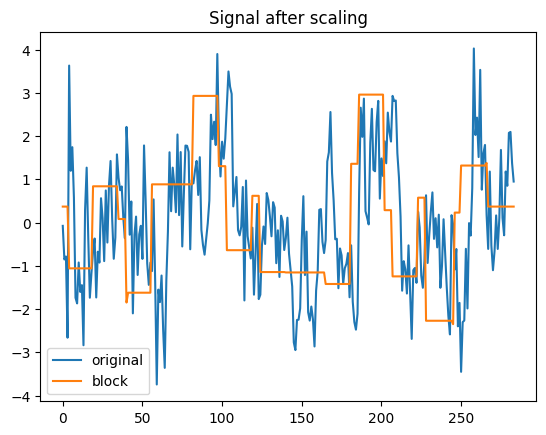

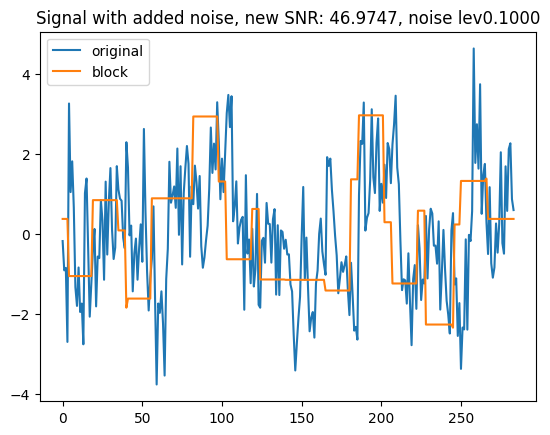

Processing: [###############################################---] 94%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


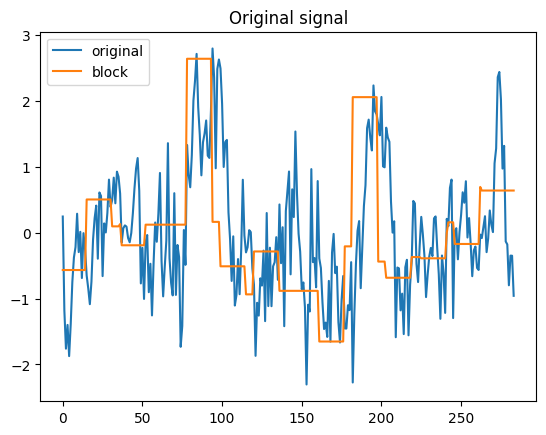

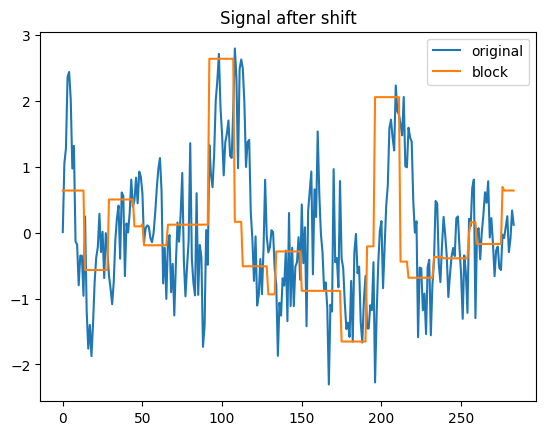

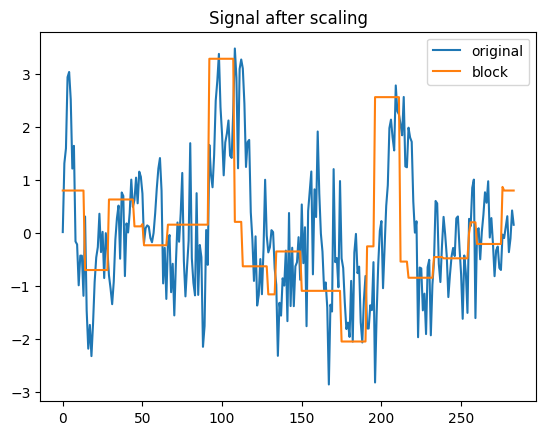

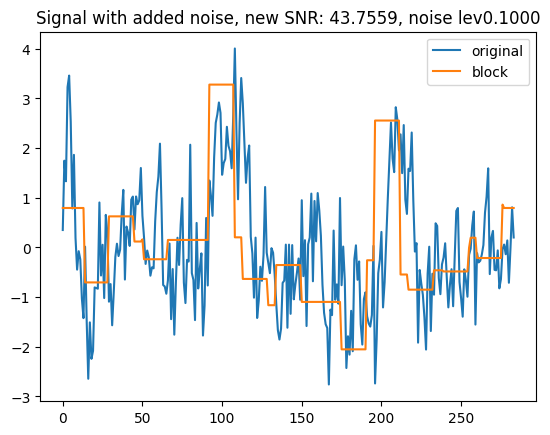

Processing: [################################################--] 97%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


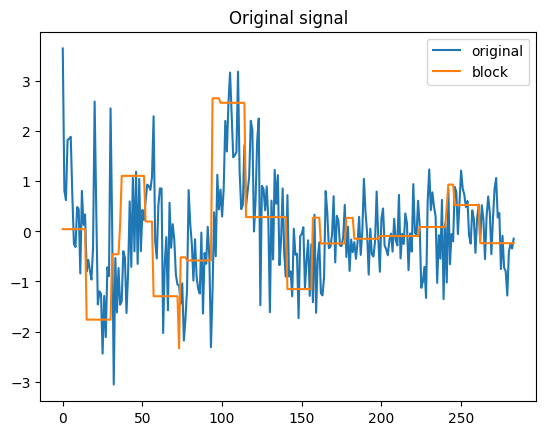

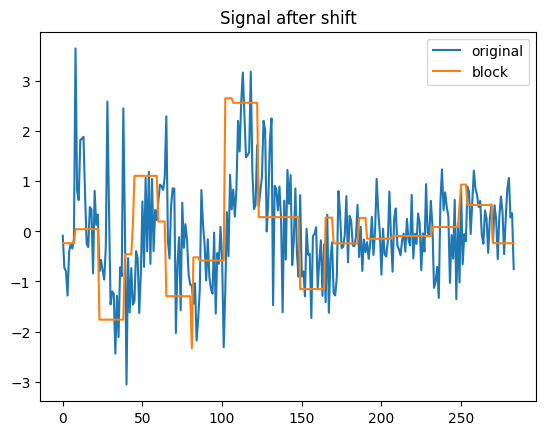

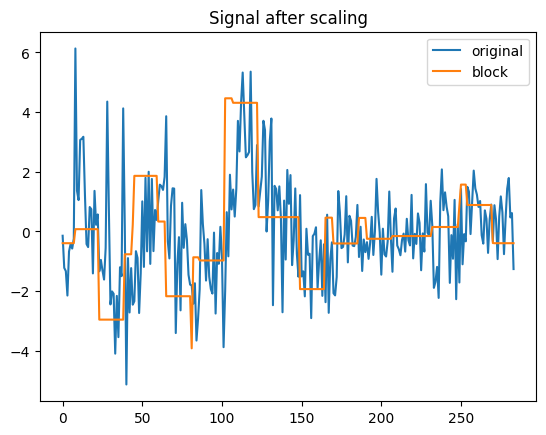

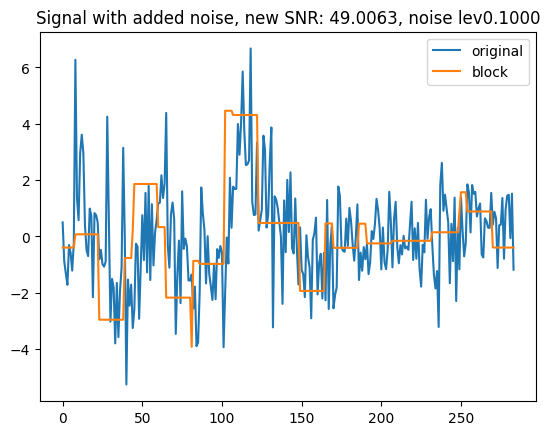

Processing: [##################################################] 100%
Processing Validation Subjects:
Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


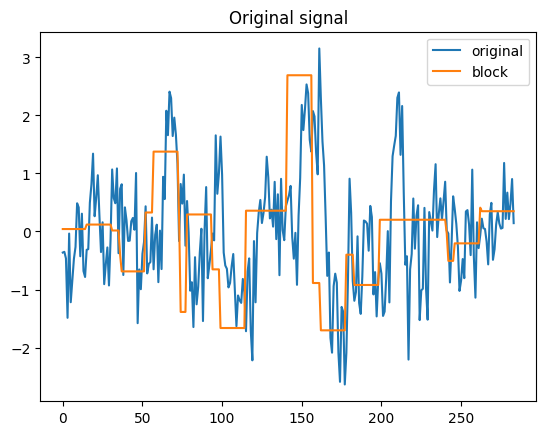

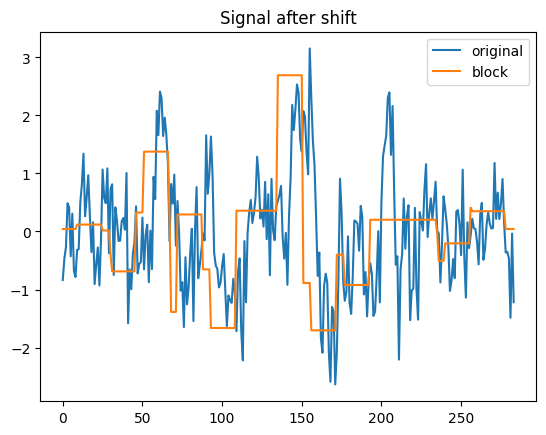

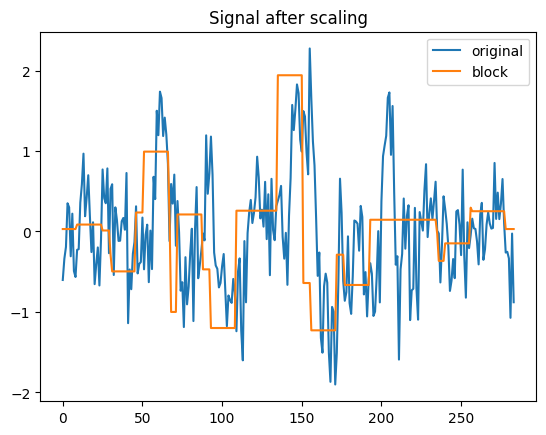

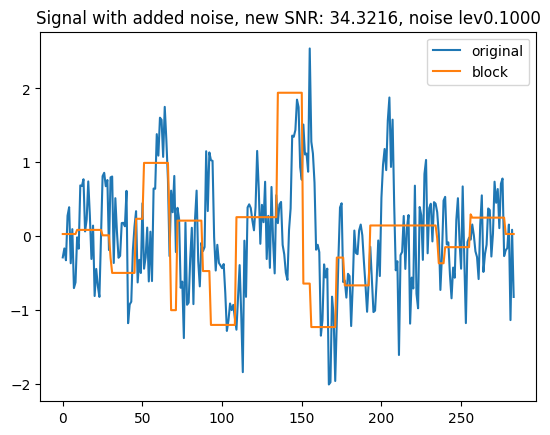

Processing: [####----------------------------------------------] 8%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


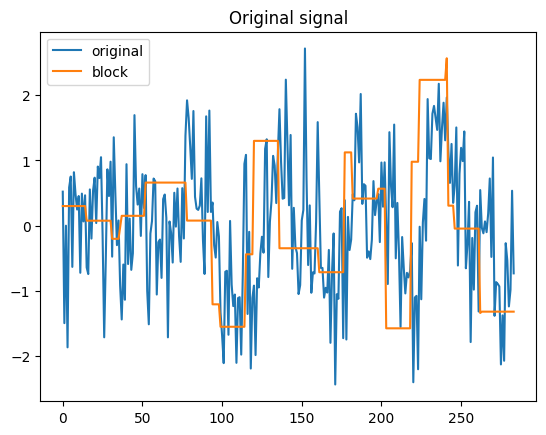

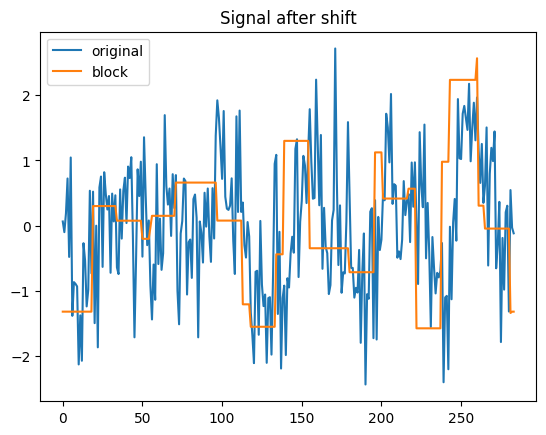

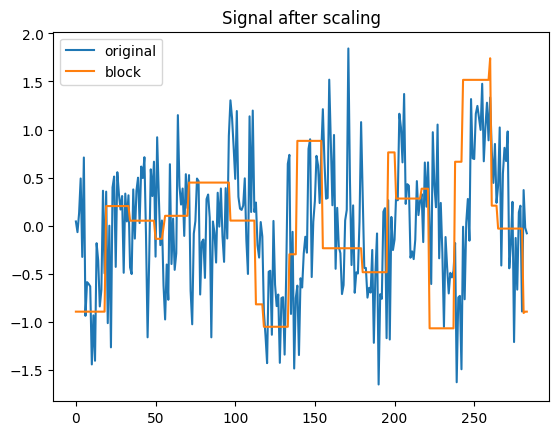

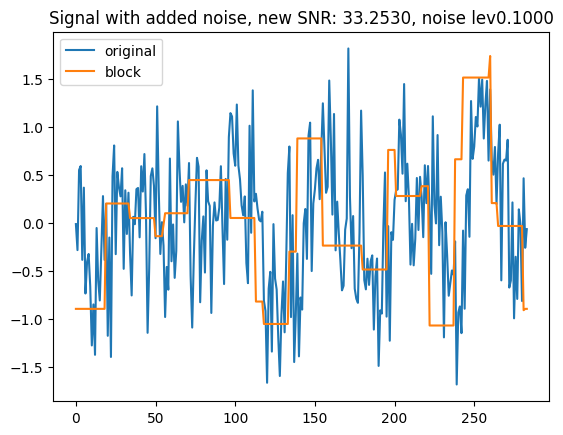

Processing: [########------------------------------------------] 16%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


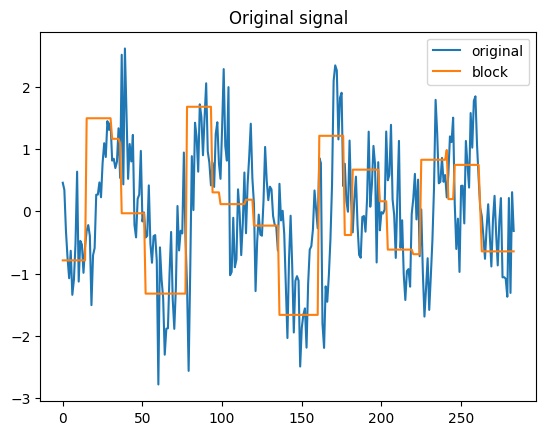

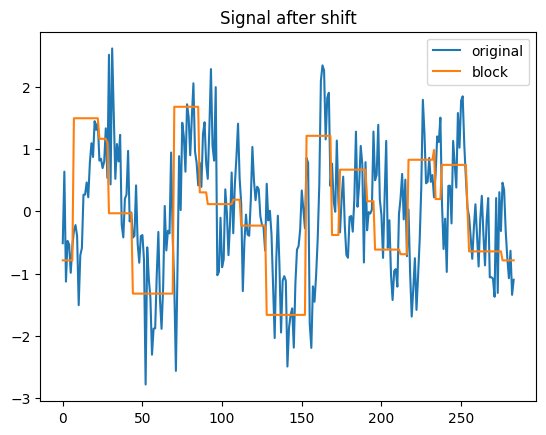

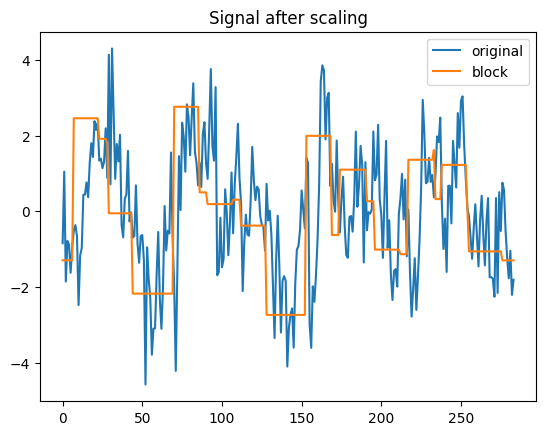

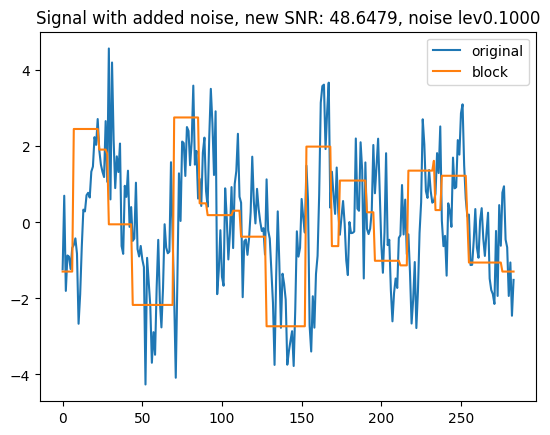

Processing: [############--------------------------------------] 25%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


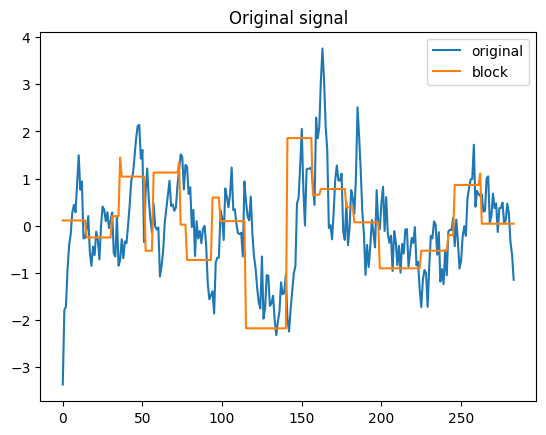

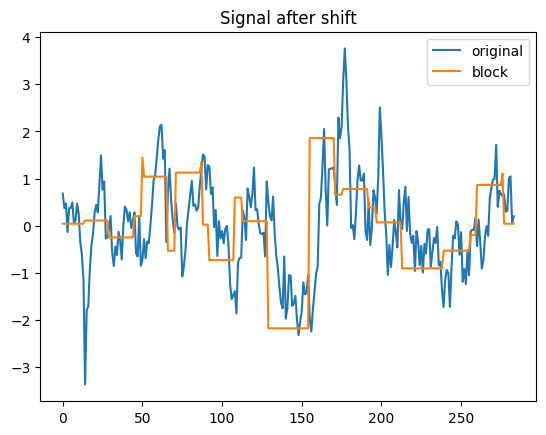

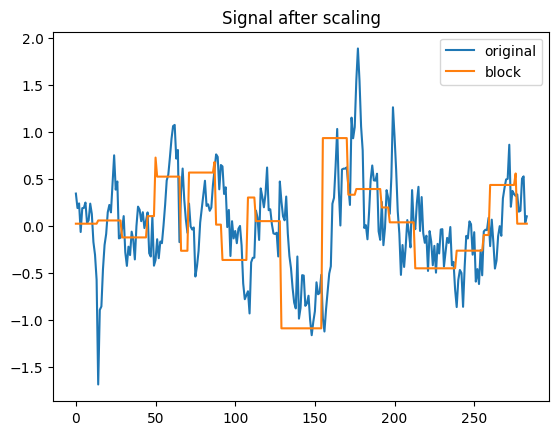

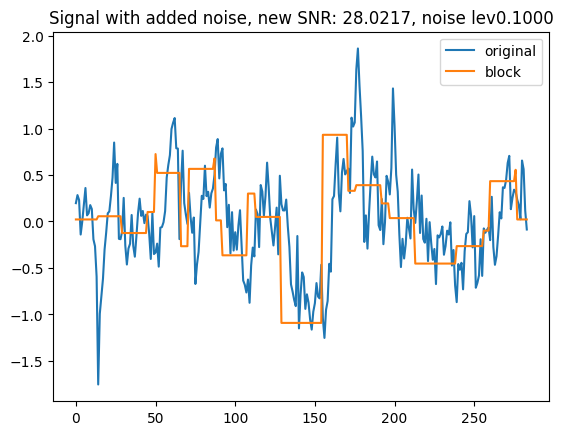

Processing: [################----------------------------------] 33%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


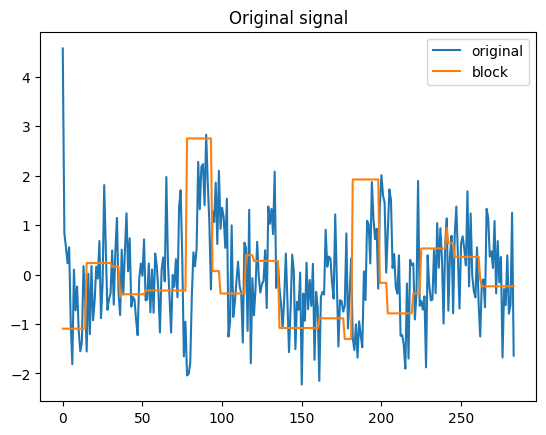

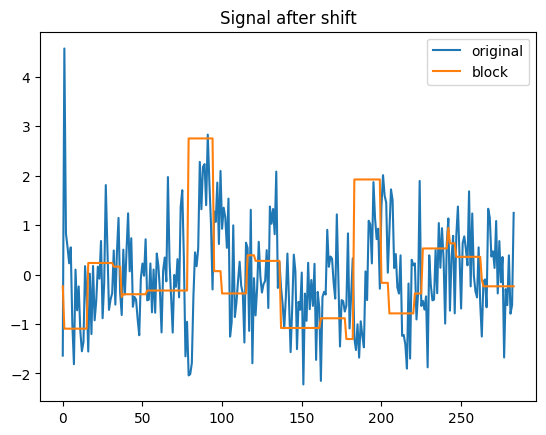

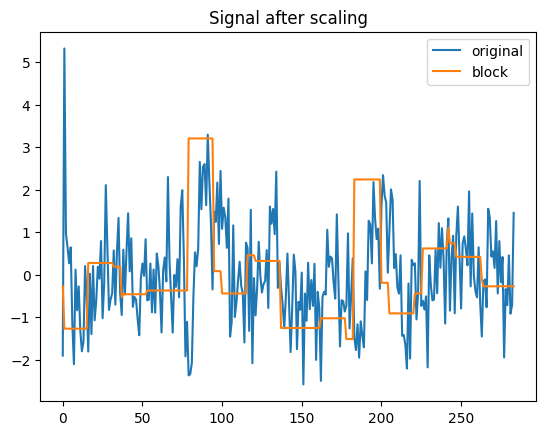

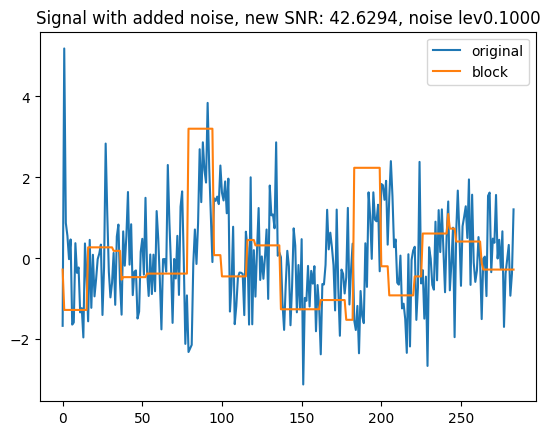

Processing: [####################------------------------------] 41%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


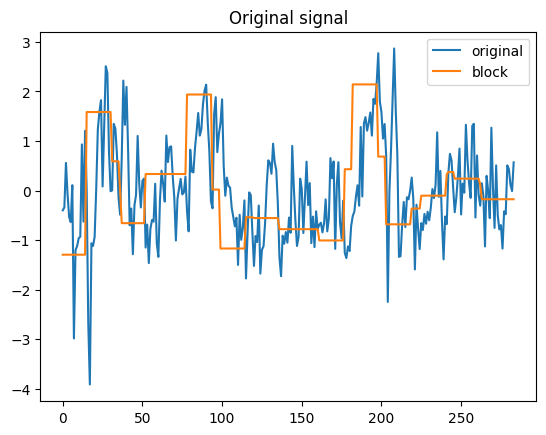

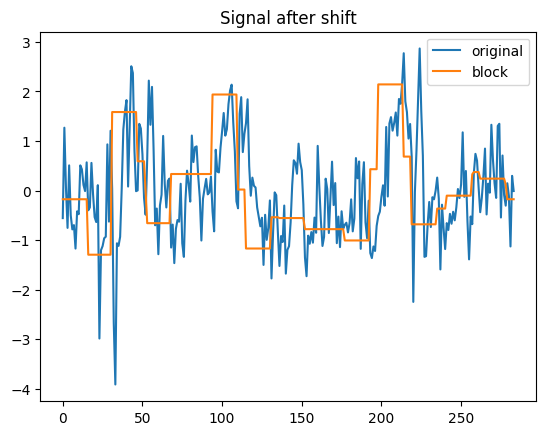

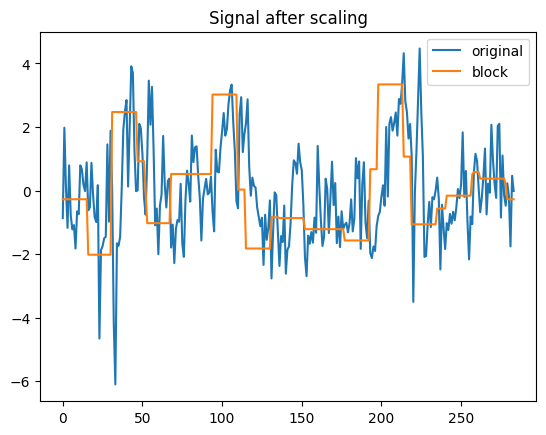

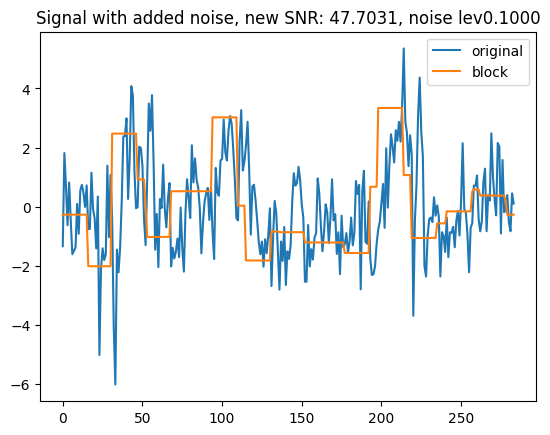

Processing: [#########################-------------------------] 50%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


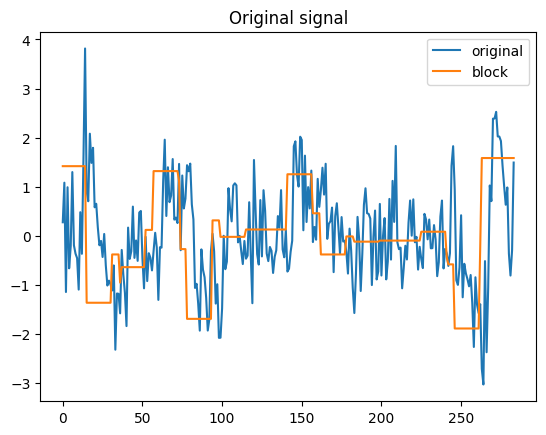

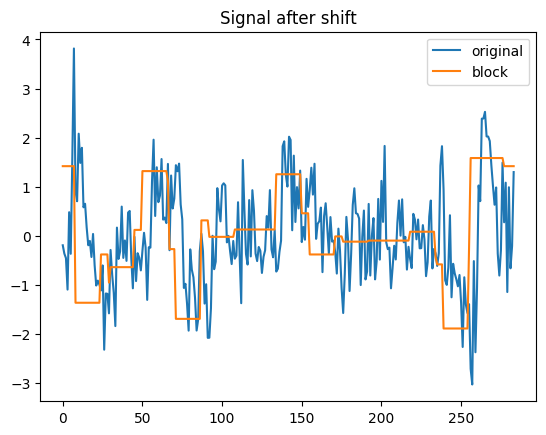

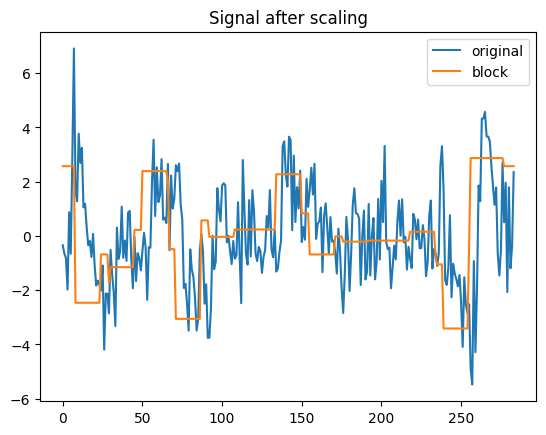

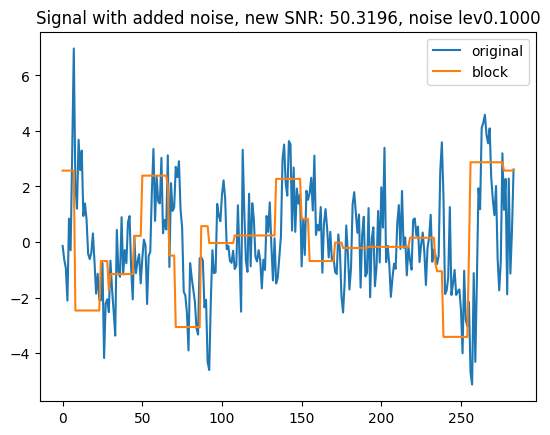

Processing: [#############################---------------------] 58%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


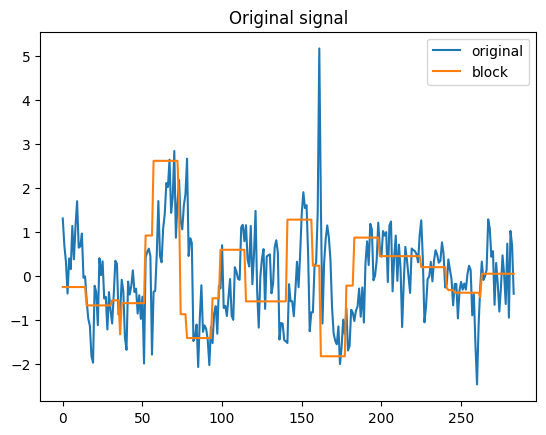

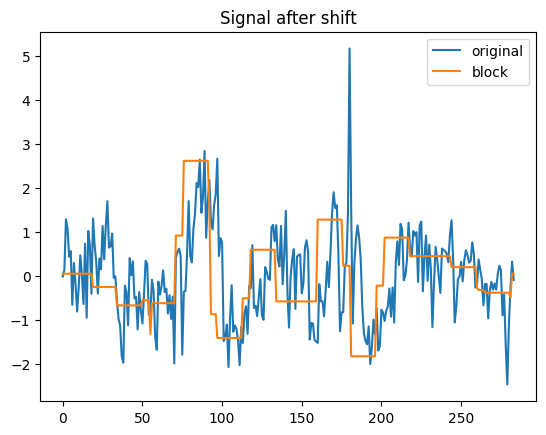

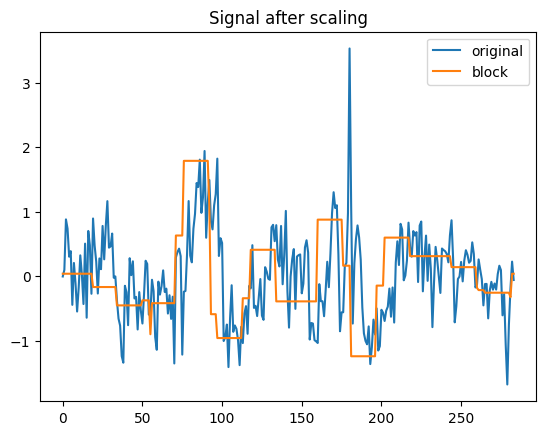

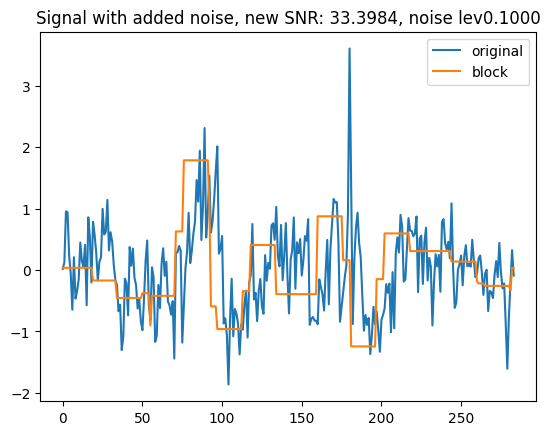

Processing: [#################################-----------------] 66%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


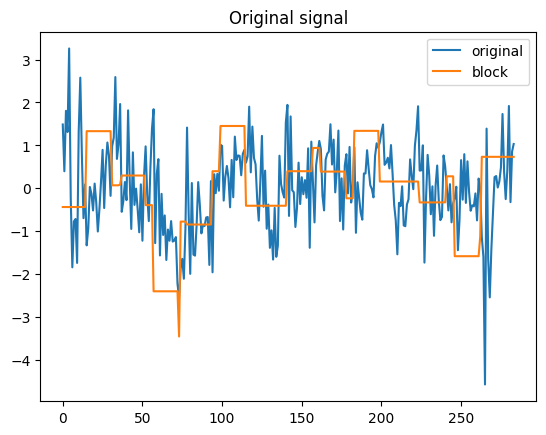

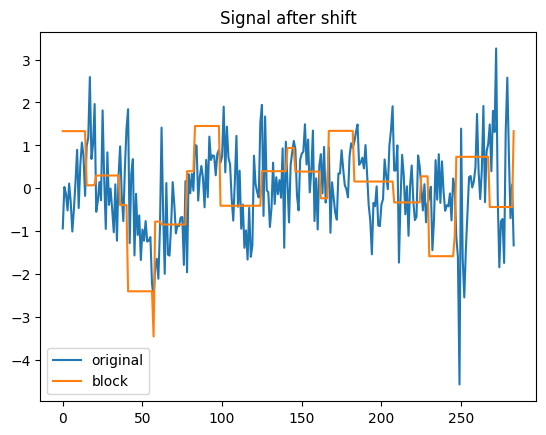

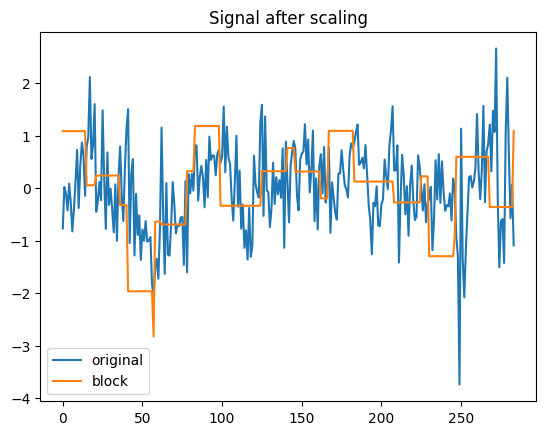

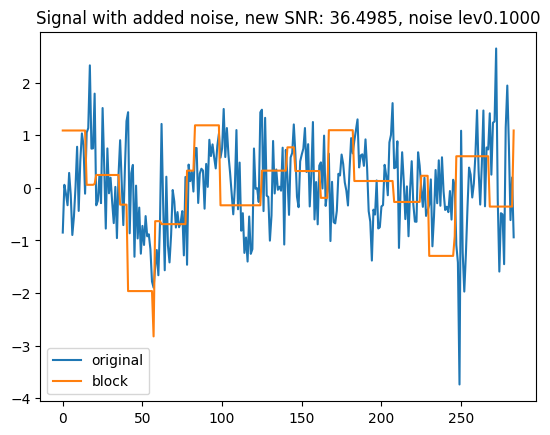

Processing: [#####################################-------------] 75%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


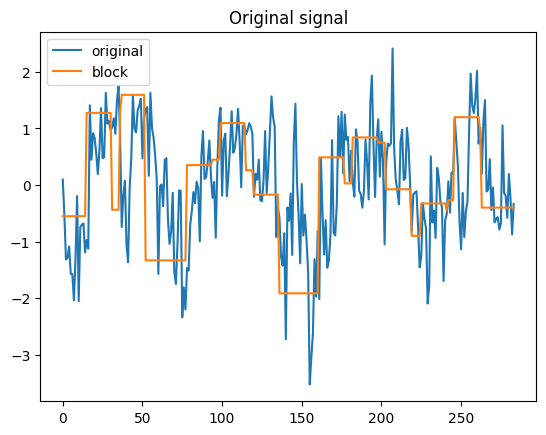

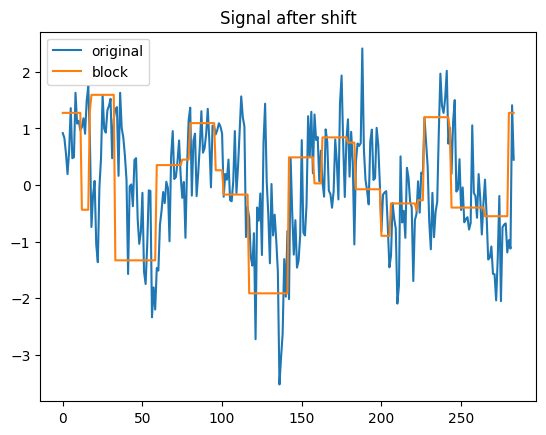

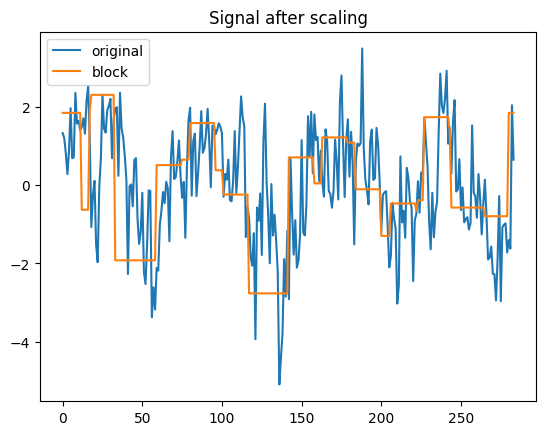

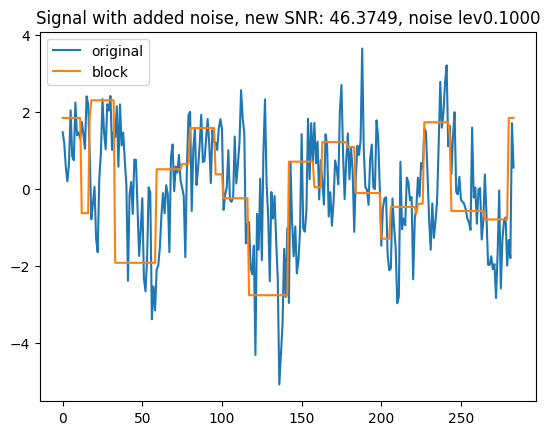

Processing: [#########################################---------] 83%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


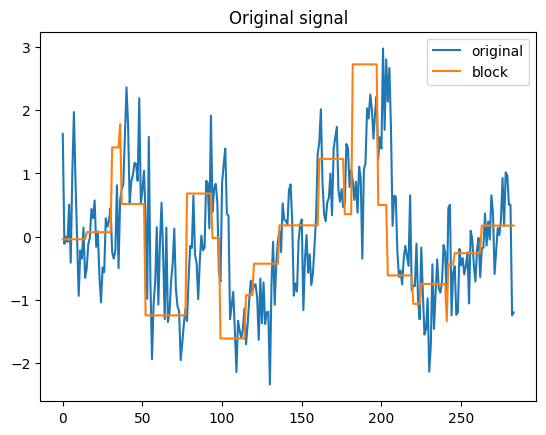

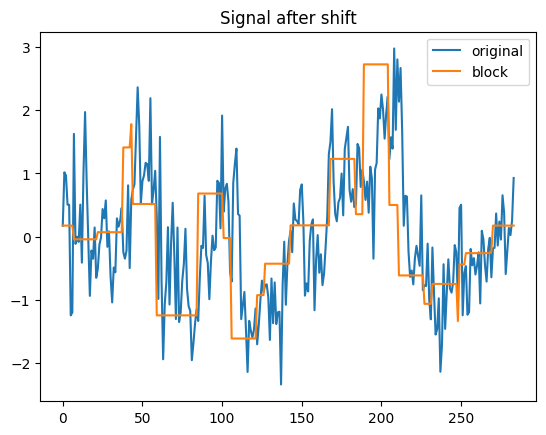

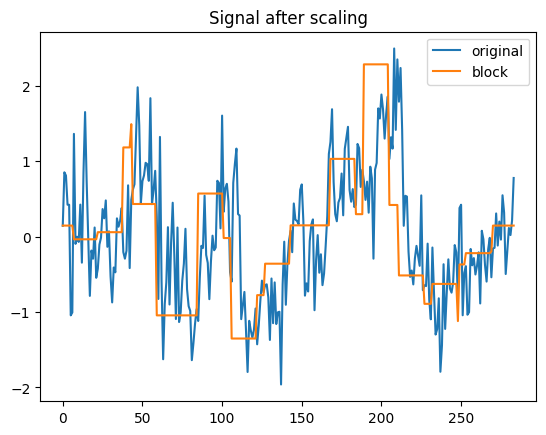

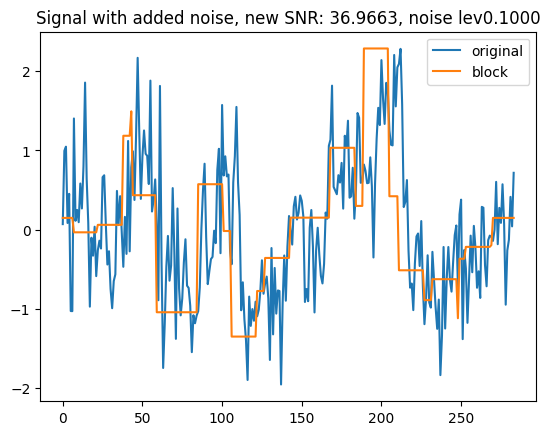

Processing: [#############################################-----] 91%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Data augmentation


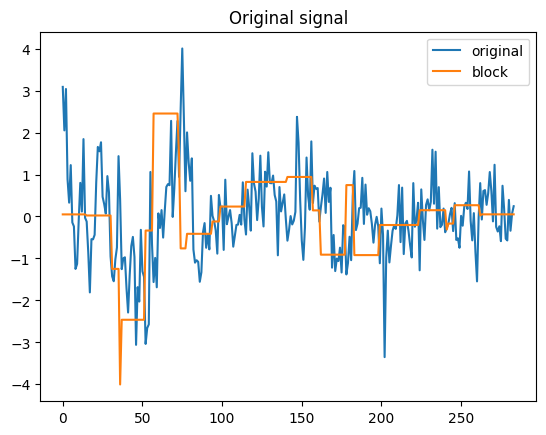

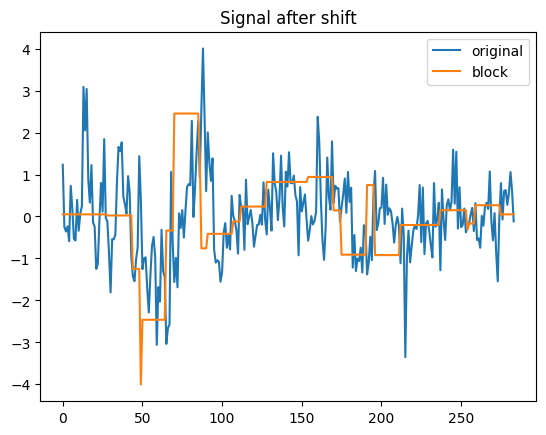

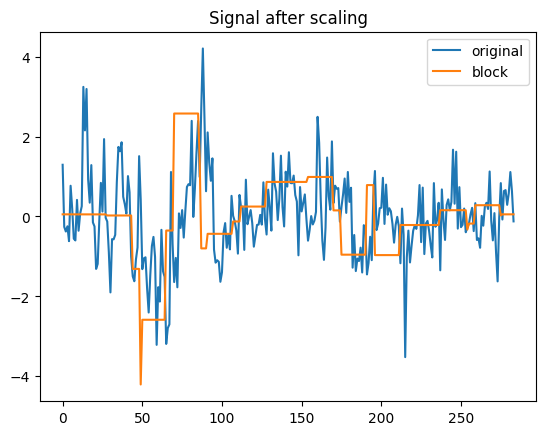

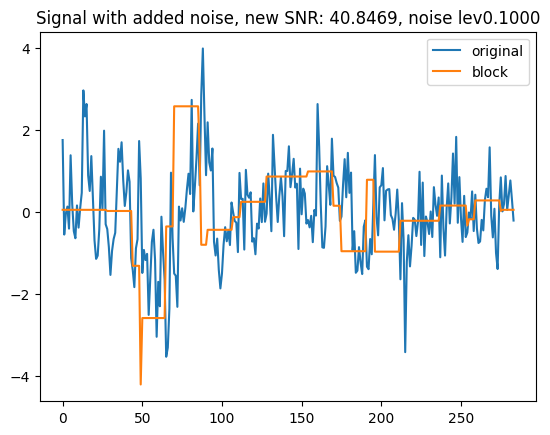

Processing: [##################################################] 100%
Processing Test Subjects:
Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Processing: [####----------------------------------------------] 8%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Processing: [########------------------------------------------] 16%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Processing: [############--------------------------------------] 25%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Processing: [################----------------------------------] 33%Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Processing: [####################--------------------

In [118]:
subjects_ids = dataset.subject.values

X_train_def, Y_train_def, X_test_def, Y_test_def, X_val_def, Y_val_def = get_data_tensors(subjects_ids)


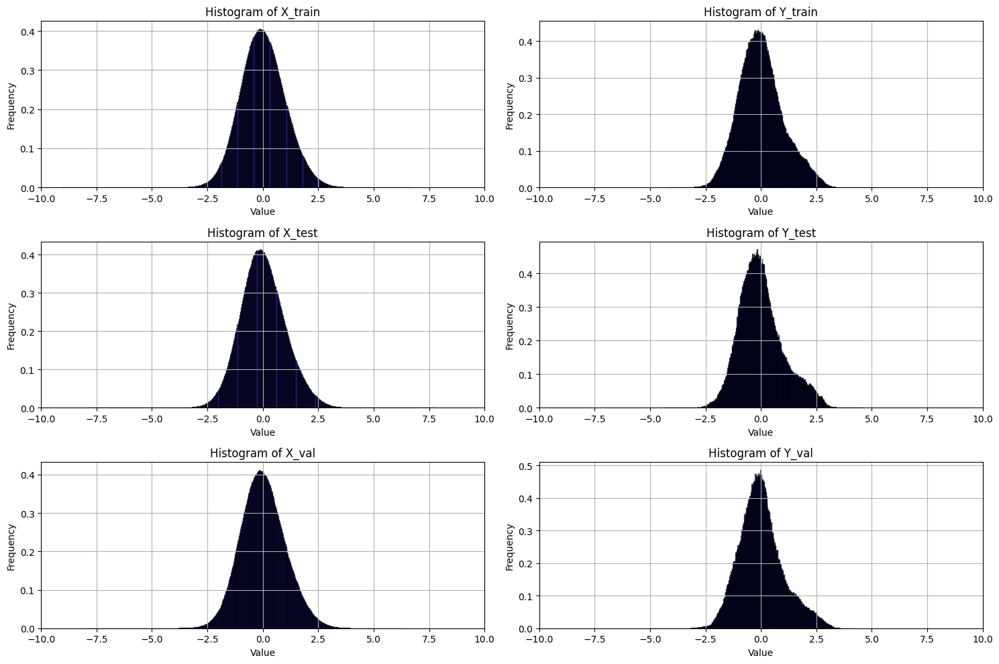

In [6]:
# List of tensors and their names
tensors = {
    "X_train": X_train_def,
    "Y_train": Y_train_def,
    "X_test": X_test_def,
    "Y_test": Y_test_def,
    "X_val": X_val_def,
    "Y_val": Y_val_def,
}

# Plot histograms for each tensor
plt.figure(figsize=(15, 10))  # Adjust figure size for better layout
for i, (name, tensor) in enumerate(tensors.items(), 1):
    flattened_values = tensor.flatten().cpu().numpy()  # Flatten and convert to numpy
    plt.subplot(3, 2, i)  # Create a subplot (3 rows, 2 columns)
    plt.hist(flattened_values, bins=500, alpha=0.7, color='blue', edgecolor='black',density=True)
    plt.title(f"Histogram of {name}")
    plt.xlabel("Value")
    plt.xlim(-10,10)
    plt.ylabel("Frequency")
    plt.grid(True)

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

In [7]:
print(X_train_def.shape)

torch.Size([69456, 284, 1])


X_train_def shape: torch.Size([69456, 284, 1]) 
Y_train_def shape: torch.Size([69456, 284, 1])


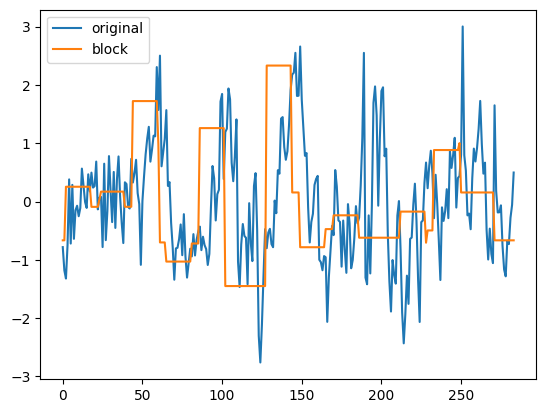

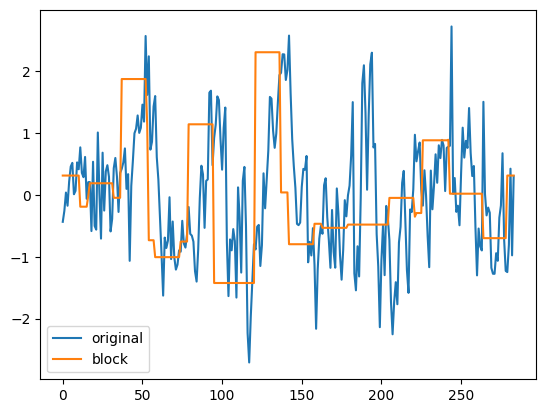

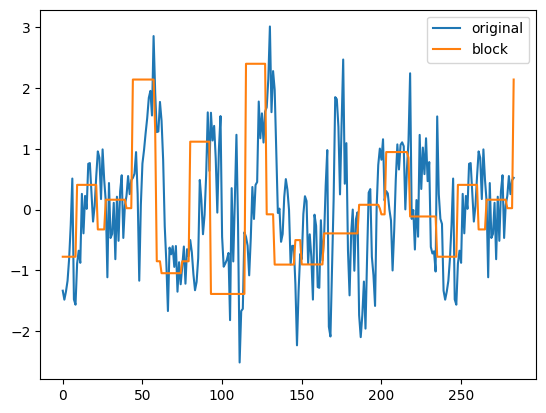

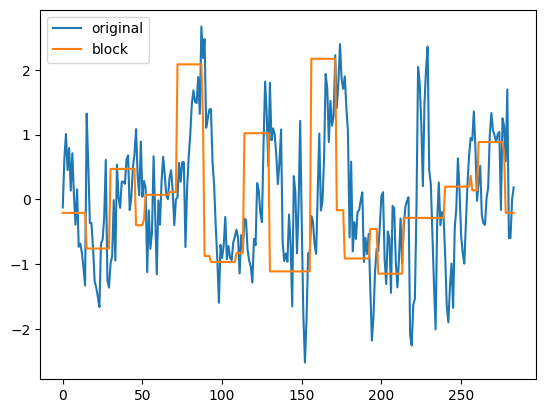

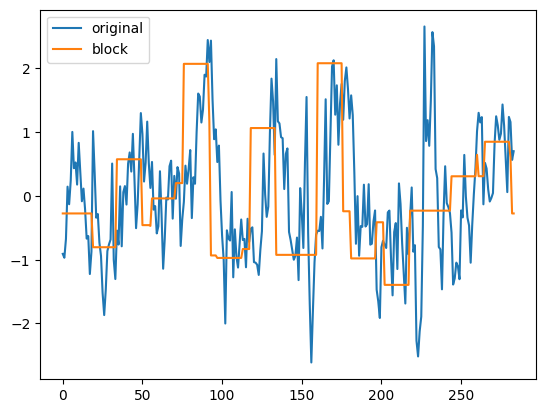

In [8]:
import matplotlib.pyplot as plt
print(f"X_train_def shape: {X_train_def.shape} \nY_train_def shape: {Y_train_def.shape}")

#X_train_def = apply_lowpass_filter(X_train_def)

for i in range (5):
    x,y = X_train_def[i,:],Y_train_def[i,:]
    plt.plot(x,label="original")
    plt.plot(y,label='block')
    plt.legend()
    plt.show()

In [9]:
#print(torch.cuda.is_available())
#print(torch.version.cuda)
#print(torch.backends.cudnn.enabled)
#print(torch.cuda.device_count())
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

torch.cuda.set_device(2)  # Set device to cuda:2

curr_dev=torch.cuda.current_device()
#print(curr_dev)

#print(device)

#print(torch.cuda.device(curr_dev))

#print(torch.cuda.get_device_name(curr_dev))

In [50]:
import torch
import torch.nn as nn

class OutputRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size=1):
        super(OutputRNN, self).__init__()
        self.rnn = nn.LSTM(input_size, hidden_size, batch_first=True,num_layers=3) # Either GRU or LSTM
        self.fc = nn.Linear(hidden_size, output_size)  # Maps hidden state to output

    def forward(self, x):
        # Pass through RNN
        rnn_out, _ = self.rnn(x)  # rnn_out: (batch_size, seq_len, hidden_size)
        
        # Apply fully connected layer
        output = self.fc(rnn_out)  # output: (batch_size, seq_len, output_size)
        return output

class KernelRNN(nn.Module):
    def __init__(self, input_dim, hidden_dim, kernel_size):
        super(KernelRNN, self).__init__()
        self.rnn = nn.LSTM(input_dim, hidden_dim, batch_first=True, num_layers=2)
        self.fc = nn.Linear(hidden_dim, kernel_size)  # Output kernel weights

    def forward(self, y):
        # y: [batch_size, time_steps, input_dim]
        rnn_out, _ = self.rnn(y)  # RNN output: [batch_size, time_steps, hidden_dim]
        
        # Select the last time step's output
        last_output = rnn_out[:, -1, :]  # Shape: [batch_size, hidden_dim]
        
        # Generate a single kernel for the entire batch
        kernel = self.fc(last_output)  # Shape: [batch_size, kernel_size]
        return kernel  # Shape: [batch_size, kernel_size]
# [batch_size, time_steps, kernel_size]

class DeconvolutionCNN(nn.Module):
    def __init__(self, kernel_size):
        super(DeconvolutionCNN, self).__init__()
        self.kernel_size = kernel_size

    def forward(self, y, kernel):
        # y: [batch_size, time_steps, 1]
        # kernel: [batch_size, kernel_size]
        
        # Move time dimension to the end of the channel dimension
        # y: [batch_size, 1, time_steps]
        y = y.permute(0, 2, 1)
        kernel = kernel.unsqueeze(1)  # kernel: [batch_size, 1, kernel_size]

        # Calculate padding
        total_padding = self.kernel_size - 1
        left_padding = total_padding // 2
        right_padding = total_padding - left_padding

        # Apply padding to the entire batch at once
        # F.pad can handle batching: input [batch_size, C, L] -> output [batch_size, C, L + padding]
        padded_y = F.pad(y, (left_padding, right_padding), mode='reflect') 
        # padded_y: [batch_size, 1, time_steps + total_padding]

        # Reshape input for grouped convolution:
        # We want each batch sample to be treated as a separate group.
        # Convert [batch_size, 1, length] to [1, batch_size, length]
        padded_y = padded_y.permute(1, 0, 2)  # Now: [1, batch_size, length]

        # Perform grouped convolution
        # groups = batch_size, in_channels = batch_size, out_channels = batch_size
        # kernel: [batch_size, 1, kernel_size]
        # input: [1, batch_size, length]
        x_hat = F.conv1d(padded_y, kernel, groups=kernel.size(0))

        # x_hat: [1, batch_size, time_steps]
        # Permute back: [batch_size, 1, time_steps]
        x_hat = x_hat.permute(1, 0, 2)

        # Finally, permute to [batch_size, time_steps, 1]
        x_hat = x_hat.permute(0, 2, 1)

        return x_hat
    
# Combined RNN-CNN Model
class RNNCNNDeconvolutionRNN(nn.Module):
    def __init__(self, input_dim, hidden_dim, kernel_size,output_dim=1):
        super(RNNCNNDeconvolutionRNN, self).__init__()
        self.kernel_rnn = KernelRNN(input_dim, hidden_dim, kernel_size)
        self.deconv_cnn = DeconvolutionCNN(kernel_size)
        self.output_rnn = OutputRNN(input_dim,hidden_dim,output_dim)
        self.kernel = 0
    def forward(self, y):
        self.kernel = self.kernel_rnn(y)  # Predict kernel with RNN
        
        x_hat = self.deconv_cnn(y, self.kernel)  # Deconvolve signal
        x_out = self.output_rnn(x_hat)
        return x_out  # Shape: [batch_size, timepoints, 1]
    def plot():
        plt.plot(self.kernel)

In [11]:
import torch
import torch.nn as nn

class OutputRNNbi(nn.Module):
    def __init__(self, input_size, hidden_size, output_size=1):
        super(OutputRNNbi, self).__init__()
        self.rnn = nn.LSTM(input_size, hidden_size, batch_first=True,num_layers=3,bidirectional=True) # Either GRU or LSTM
        self.fc = nn.Linear(hidden_size*2, output_size)  # Maps hidden state to output

    def forward(self, x):
        # Pass through RNN
        rnn_out, _ = self.rnn(x)  # rnn_out: (batch_size, seq_len, hidden_size)
        
        # Apply fully connected layer
        output = self.fc(rnn_out)  # output: (batch_size, seq_len, output_size)
        return output

class KernelRNNbi(nn.Module):
    def __init__(self, input_dim, hidden_dim, kernel_size):
        super(KernelRNNbi, self).__init__()
        self.rnn = nn.LSTM(input_dim, hidden_dim, batch_first=True, num_layers=2,bidirectional=True)
        self.fc = nn.Linear(hidden_dim*2, kernel_size)  # Output kernel weights

    def forward(self, y):
        # y: [batch_size, time_steps, input_dim]
        rnn_out, _ = self.rnn(y)  # RNN output: [batch_size, time_steps, hidden_dim]
        
        # Select the last time step's output
        last_output = rnn_out[:, -1, :]  # Shape: [batch_size, hidden_dim]
        
        # Generate a single kernel for the entire batch
        kernel = self.fc(last_output)  # Shape: [batch_size, kernel_size]
        return kernel  # Shape: [batch_size, kernel_size]
# [batch_size, time_steps, kernel_size]

class DeconvolutionCNNbi(nn.Module):
    def __init__(self, kernel_size):
        super(DeconvolutionCNNbi, self).__init__()
        self.kernel_size = kernel_size

    def forward(self, y, kernel):
        # y: [batch_size, time_steps, 1]
        # kernel: [batch_size, kernel_size]
        
        # Move time dimension to the end of the channel dimension
        # y: [batch_size, 1, time_steps]
        y = y.permute(0, 2, 1)
        kernel = kernel.unsqueeze(1)  # kernel: [batch_size, 1, kernel_size]

        # Calculate padding
        total_padding = self.kernel_size - 1
        left_padding = total_padding // 2
        right_padding = total_padding - left_padding

        # Apply padding to the entire batch at once
        # F.pad can handle batching: input [batch_size, C, L] -> output [batch_size, C, L + padding]
        padded_y = F.pad(y, (left_padding, right_padding), mode='reflect') 
        # padded_y: [batch_size, 1, time_steps + total_padding]

        # Reshape input for grouped convolution:
        # We want each batch sample to be treated as a separate group.
        # Convert [batch_size, 1, length] to [1, batch_size, length]
        padded_y = padded_y.permute(1, 0, 2)  # Now: [1, batch_size, length]

        # Perform grouped convolution
        # groups = batch_size, in_channels = batch_size, out_channels = batch_size
        # kernel: [batch_size, 1, kernel_size]
        # input: [1, batch_size, length]
        x_hat = F.conv1d(padded_y, kernel, groups=kernel.size(0))

        # x_hat: [1, batch_size, time_steps]
        # Permute back: [batch_size, 1, time_steps]
        x_hat = x_hat.permute(1, 0, 2)

        # Finally, permute to [batch_size, time_steps, 1]
        x_hat = x_hat.permute(0, 2, 1)

        return x_hat
    
# Combined RNN-CNN Model
class RNNCNNDeconvolutionRNNbi(nn.Module):
    def __init__(self, input_dim, hidden_dim, kernel_size,output_dim=1):
        super(RNNCNNDeconvolutionRNNbi, self).__init__()
        self.kernel_rnn = KernelRNNbi(input_dim, hidden_dim, kernel_size)
        self.deconv_cnn = DeconvolutionCNNbi(kernel_size)
        self.output_rnn = OutputRNNbi(input_dim,hidden_dim,output_dim)
    def forward(self, y):
        kernel = self.kernel_rnn(y)  # Predict kernel with RNN
        x_hat = self.deconv_cnn(y, kernel)  # Deconvolve signal
        x_out = self.output_rnn(x_hat)
        return x_out  # Shape: [batch_size, timepoints, 1]

In [12]:
# ***************************************************
#                         MODELS
# ***************************************************

import torch
import torch.nn as nn


# LSTM CLASSIC

class LSTM3l(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(LSTM3l, self).__init__()
        self.rnn = nn.LSTM(input_size, hidden_size, batch_first=True,num_layers=3) # Either GRU or LSTM
        self.fc = nn.Linear(hidden_size, output_size)  # Maps hidden state to output

    def forward(self, x):
        # Pass through RNN
        rnn_out, _ = self.rnn(x)  # rnn_out: (batch_size, seq_len, hidden_size)
        
        # Apply fully connected layer
        output = self.fc(rnn_out)  # output: (batch_size, seq_len, output_size)
        return output

class LSTM1l(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(LSTM1l, self).__init__()
        self.rnn = nn.LSTM(input_size, hidden_size, batch_first=True,num_layers=1) # Either GRU or LSTM
        self.fc = nn.Linear(hidden_size, output_size)  # Maps hidden state to output

    def forward(self, x):
        # Pass through RNN
        rnn_out, _ = self.rnn(x)  # rnn_out: (batch_size, seq_len, hidden_size)
        
        # Apply fully connected layer
        output = self.fc(rnn_out)  # output: (batch_size, seq_len, output_size)
        return output




# CONV + LSTM

class ConvLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, dropout_prob=0.2):
        super(ConvLSTM, self).__init__()
         # 1D Convolutional Layer
        self.conv1 = nn.Conv1d(input_size, hidden_size, kernel_size=3, padding=1)
        self.pool = nn.MaxPool1d(kernel_size=1)
        
        # RNN Layer (LSTM or GRU)
        self.rnn = nn.LSTM(hidden_size, hidden_size, batch_first=True, num_layers=3, dropout=dropout_prob)
       
       # Fully connected layer
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        # Pass through CNN
        x = x.permute(0, 2, 1)  # Change shape to (batch_size, channels, seq_len)
        x = F.relu(self.conv1(x))
        x = self.pool(x)
        
        # Reshape for RNN input
        x = x.permute(0, 2, 1)  # (batch_size, seq_len, channels)
        
        # Pass through RNN
        rnn_out, _ = self.rnn(x)
        
        # Pass the RNN output (all time steps) through the FC layer
        output = self.fc(rnn_out)  # (batch_size, seq_len, output_size)
        return output




# LSTM with Attention Mechanism

class LSTM_attention(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, dropout_prob=0.2):
        super(LSTM_attention, self).__init__()
        
        self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True, num_layers=2, dropout=dropout_prob)
        self.attn = nn.Linear(hidden_size, hidden_size)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        # Pass through LSTM
        lstm_out, _ = self.lstm(x)  # lstm_out: (batch_size, seq_len, hidden_size)
        
        # Apply attention mechanism at each time step
        attn_weights = F.softmax(self.attn(lstm_out), dim=2)  # Shape: (batch_size, seq_len, hidden_size)
        weighted_out = attn_weights * lstm_out  # Apply attention: (batch_size, seq_len, hidden_size)
        
        # Pass weighted outputs through fully connected layer
        output = self.fc(weighted_out)  # Shape: (batch_size, seq_len, output_size)
        return output



# Bidirectional LSTM

class biLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, dropout_prob=0.2):
        super(biLSTM, self).__init__()
        
        # Bidirectional LSTM layer
        self.bilstm = nn.LSTM(input_size, hidden_size, batch_first=True, num_layers=3, bidirectional=True, dropout=dropout_prob)
        # Fully connected layer
        self.fc = nn.Linear(hidden_size * 2, output_size)  # *2 because of bidirectional

    def forward(self, x):
        # Pass through BiLSTM
        lstm_out, _ = self.bilstm(x)  # lstm_out: (batch_size, seq_len, hidden_size * 2)
        
        # Use the output from the last time step
        output = self.fc(lstm_out)  # Last time step output
        return output





#only conv

#First Layer: Captures low-level features like edges, basic patterns, or simple variations in the data.
#Second Layer: Detects combinations of low-level features to form more abstract patterns or structures.
#Third Layer: Extracts high-level representations, such as complex temporal dependencies or global patterns across the input.


class PureConv(nn.Module):
    def __init__(self, input_dim, hidden_dim, kernel_size, output_dim=1, dropout_prob=0.2):
        super(PureConv, self).__init__()
        
        # Remove padding from the conv layers and do manual padding
        self.conv1 = nn.Conv1d(input_dim, input_dim, kernel_size=kernel_size, padding=0)    
        self.conv2 = nn.Conv1d(input_dim, input_dim, kernel_size=kernel_size, padding=0)      
        self.conv3 = nn.Conv1d(input_dim, input_dim, kernel_size=kernel_size, padding=0)
        self.dropout = nn.Dropout(dropout_prob)

        self.kernel_size = kernel_size
        self.total_padding = self.kernel_size - 1
        self.left_padding = self.total_padding // 2
        self.right_padding = self.total_padding - self.left_padding

    def forward(self, y):
        # [batch_size, time_steps, channels] -> [batch_size, channels, time_steps]
        x = y.permute(0, 2, 1)

        # Convolution 1 with manual padding
        x = F.pad(x, (self.left_padding, self.right_padding), mode='reflect')
        x = F.relu(self.conv1(x))

        # Convolution 2 with manual padding
        x = F.pad(x, (self.left_padding, self.right_padding), mode='reflect')
        x = F.relu(self.conv2(x))

        # Convolution 3 with manual padding
        x = self.dropout(x)
        x = F.pad(x, (self.left_padding, self.right_padding), mode='reflect')
        x = self.conv3(x)

        # [batch_size, channels, time_steps] -> [batch_size, time_steps, channels]
        x_out = x.permute(0, 2, 1)
        return x_out


In [13]:
def gaussian_tv_penalty(predictions, alpha=1):
    # max is at 1/sqrt(2*alpha), needs to be searched for max gain

    # diffs is a first derivative approx
    diffs = predictions[:,1:,:] - predictions[:,:-1,:]
    # exponential weights to punish small variations
    weights = np.sqrt(2*alpha*np.e)*torch.exp(-alpha * diffs**2)

    return torch.mean(torch.abs(diffs) * weights) # normalized to have max value of 1 and min of zero, 

def anti_constant_penalty(predictions, beta=1):
    # Encourages non-constant solutions by penalizing non unitary variances - input and target data needs to be normalized
    varmean= torch.mean(torch.var(predictions,dim=1))
    #return 1-torch.exp(-beta*torch.pow(varmean-1,2)) # penalizes variances that are not 1
    return torch.pow(varmean-1,2) # Most likely better
    #if varmean<=1:
    #    return beta*(1/(beta+varmean))
    #return torch.tanh(varmean) # penalizes bigger than one variance 
def combined_penalty(predictions, alpha=2, beta=1e-8, lambda_tv=1, lambda_const=1):
    tv_loss = gaussian_tv_penalty(predictions, alpha)
    const_loss = anti_constant_penalty(predictions, beta)
    return (lambda_tv * tv_loss + lambda_const * const_loss)/(lambda_tv+lambda_const)

def penalize_tv(predictions):
    """
    predictions: tensor di forma [batch_size, sequence_length, num_channels]
    """
    tv_loss = torch.sum(torch.abs(predictions[:,1:, :] - predictions[:,:-1, :]))  # Penalizza variazioni consecutive
    return tv_loss 




In [14]:
fs = 1 / TR  # Hz
cutoff = 0.1  # Low-pass filter cutoff frequency (Hz)
order = 4

def butter_lowpass():
    """
    Create a lowpass Butterworth filter.
    :param cutoff: Cutoff frequency of the filter (Hz)
    :param fs: Sampling frequency of the signal (Hz)
    :param order: Order of the filter
    :return: Filter coefficients (b, a)
    """
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    
    # Design the Butterworth filter
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    G0 = np.sum(b)/np.sum(a)
    # Normalize to ensure unit gain at zero frequency
    b = b / G0
    return b, a
    
def apply_lowpass_filter(tensor):
    """
    Apply a lowpass filter to a PyTorch tensor.
    :param tensor: PyTorch tensor to be filtered
    :param cutoff: Cutoff frequency (Hz)
    :param fs: Sampling frequency (Hz)
    :param order: Order of the filter
    :return: Filtered PyTorch tensor
    """
    # Convert the tensor to a NumPy array
    tensor_np = tensor.detach().cpu().numpy()

    print(f"Input tensor shape: {tensor_np.shape}")
    
    # Check the length of the input tensor
    if tensor_np.shape[-2] <= order:
        raise ValueError(f"Input tensor is too short for the specified filter order {order}. "
                         f"Consider increasing the length of your input signal or reducing the filter order.")
    
    # Design the filter
    b, a = butter_lowpass()
    
    # Apply the filter using filtfilt for zero-phase filtering
    filtered_np = filtfilt(b, a, tensor_np, axis=-2).copy()
    
    # Convert the filtered data back to a PyTorch tensor
    filtered_tensor = torch.tensor(filtered_np, dtype=tensor.dtype, device=tensor.device)
    
    return filtered_tensor


## hyperparameter tuning for loss function
We want to punish constant behaviour, as well as smooth functions, while punishing less block design:

In [15]:
samples = Y_train_def[:Y_train_def.shape[0]//2,:,:]
samples_punish = apply_lowpass_filter(X_train_def[:X_train_def.shape[0]//2,:,:])
# Create a tensor of zeros with the same shape
zeros_tensor = torch.zeros_like(samples_punish)

# Concatenate along the last axis
concatenated_tensor = torch.cat((samples_punish, zeros_tensor[:2000,:,:]), dim=0)
print(concatenated_tensor.shape)
from itertools import product

# Define your parameter grids
alphas = [2,8]#np.logspace(-1, 2, 5) ## anche 2 o 8 vanno bene, leggere notion per interpretazione valore
betas = [1]#np.logspace(-2, 2 , 5)
lambdastv = [1]#np.logspace(-1, 1, 5)
lambdasconst = [1]#np.logspace(-1, 1, 5)

# Perform grid search
results = []
idx = 0
total_iterations = len(alphas) * len(betas) * len(lambdastv) * len(lambdasconst)

w1=2.0# loss from block design has half the samples of the other
w2=1.0
for alpha, beta, lambda_tv, lambda_const in product(alphas, betas, lambdastv, lambdasconst):
    # Compute losses
    loss = combined_penalty(samples, alpha, beta, lambda_tv, lambda_const)
    loss_punish = combined_penalty(concatenated_tensor, alpha, beta, lambda_tv, lambda_const)
    gauss_weight_samples = gaussian_tv_penalty(samples,alpha)
    gauss_weight_samples_punish = gaussian_tv_penalty(concatenated_tensor,alpha)
    constant_samples = anti_constant_penalty(samples,beta)
    constant_samples_punish = anti_constant_penalty(concatenated_tensor,beta)
    # Compute combined score
    score =  loss/loss_punish
    
    # Store results
    results.append({
        'alpha': alpha,
        'beta': beta,
        'lambda_tv': lambda_tv,
        'lambda_const': lambda_const,
        'loss': loss,
        'loss_punish': loss_punish,
        'score': score,
        'gauss_weight_samples':gauss_weight_samples,
        'gauss_weight_samples_punish':gauss_weight_samples_punish,
        'constant_samples':constant_samples,
        'constant_samples_punish':constant_samples_punish,
    })
    
    # Display progress
    idx += 1
    custom_progress_bar(idx, total_iterations)
    
# Find the best parameters based on the score
best_result = min(results, key=lambda x: x['score'])
print()
lambda_val=1/(best_result['loss_punish'])
print('lambda_train',lambda_val)

# Output the best parameters and their corresponding losses
print("Best parameters:")
print(f"Alpha: {best_result['alpha']}, Beta: {best_result['beta']}, "
      f"Lambda TV: {best_result['lambda_tv']}, Lambda Const: {best_result['lambda_const']}")
print(f"Minimum Loss: {best_result['loss']}, Maximum Loss Punish: {best_result['loss_punish']}")
print(f"Expected loss: {best_result['loss']+best_result['loss_punish']}")
print(f"Best Score: {best_result['score']}")
print(f"gass Loss: {best_result['gauss_weight_samples']}, gauss Loss Punish: {best_result['gauss_weight_samples_punish']}")
print(f"constant Loss: {best_result['constant_samples']}, constant Loss Punish: {best_result['constant_samples_punish']}")
alpha,beta,lambda_tv,lambda_const = best_result['alpha'],best_result['beta'],best_result['lambda_tv'],best_result['lambda_const']


Input tensor shape: (34728, 284, 1)
torch.Size([36728, 284, 1])
Processing: [##################################################] 100%
lambda_train tensor(2.7631)
Best parameters:
Alpha: 8, Beta: 1, Lambda TV: 1, Lambda Const: 1
Minimum Loss: 0.011723094619810581, Maximum Loss Punish: 0.36190685629844666
Expected loss: 0.37362995743751526
Best Score: 0.03239257261157036
gass Loss: 0.023446189239621162, gauss Loss Punish: 0.5101763606071472
constant Loss: 0.0, constant Loss Punish: 0.2136373668909073


Text(0.5, 1.0, 'Sample signals to evaluate loss')

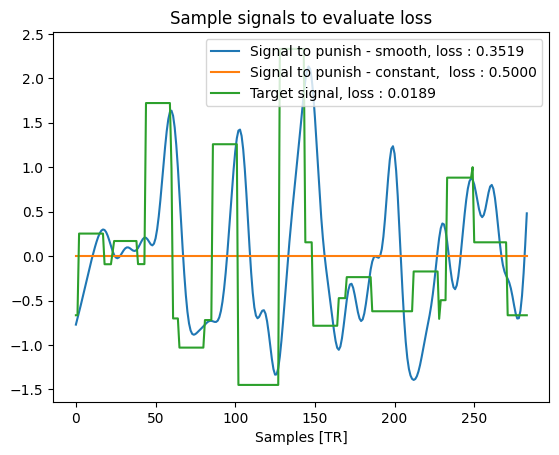

In [16]:
plt.plot(samples_punish[0,:],label=f'Signal to punish - smooth, loss : {combined_penalty(samples_punish[0,:].unsqueeze(0).unsqueeze(-1), 8):.4f}')
plt.plot(zeros_tensor[0,:],label=f'Signal to punish - constant,  loss : {combined_penalty(zeros_tensor[0,:].unsqueeze(0).unsqueeze(-1), 8):.4f}')
plt.plot(samples[0,:],label=f'Target signal, loss : {combined_penalty(samples[0,:].unsqueeze(0).unsqueeze(-1), 8):.4f}')
plt.legend()
plt.xlabel('Samples [TR]')
plt.title("Sample signals to evaluate loss")

In [53]:
def blocky_loss(data_loss, smoothness_loss, lambda_val=2.6,epoch=1):
    weight = lambda_val*min(1,(epoch/10)**2)
    return data_loss + weight * smoothness_loss

penalizing_function = combined_penalty  # assuming combined_penalty is defined elsewhere

def train_model_with_early_stopping(
    model, criterion, train_loader, validation_loader, optimizer, num_epochs, device, patience=5, lambda_val=0.01,
    alpha=alpha,beta=beta,lambda_tv=lambda_tv,lambda_const=lambda_const
):
    train_losses = []
    train_losses_smooth = []
    validation_losses = []
    validation_losses_smooth = []

    best_validation_loss = float('inf')
    patience_counter = 0
    best_model_state = None  # ensure this is defined

    for epoch in range(num_epochs):
        model.train()
        total_train_loss = 0
        total_train_loss_smooth = 0
        last_predictions = None  # to store predictions from last batch of the epoch
        
        # Training loop
        for batch_x, batch_y in train_loader:
            batch_x, batch_y = batch_x.to(device), batch_y.to(device)

            # Forward pass
            predictions = model(batch_x)

            # Shape check
            if predictions.shape != batch_y.shape:
                raise ValueError(
                    f"Shape mismatch: Predictions {predictions.shape} vs Targets {batch_y.shape}. "
                    "Ensure model output matches target dimensions."
                )

            loss_data = criterion(predictions, batch_y)
            smoothness_loss = penalizing_function(predictions,alpha=alpha,beta=beta,lambda_tv=lambda_tv,lambda_const=lambda_const)
            total_train_loss += loss_data.item()
            total_train_loss_smooth += smoothness_loss.item()*lambda_val

            loss = blocky_loss(loss_data, smoothness_loss, lambda_val=lambda_val,epoch=epoch)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            last_predictions = predictions.detach()
            last_y = batch_y.detach()
            last_x = batch_x.detach()

        avg_train_loss = total_train_loss / len(train_loader)
        train_losses.append(avg_train_loss)
        avg_train_loss_smooth = total_train_loss_smooth/len(train_loader)
        train_losses_smooth.append(avg_train_loss_smooth)
        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {avg_train_loss:.4f}")
        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss smooth: {avg_train_loss_smooth:.4f}")

        # Plot one prediction per epoch (using the last batch predictions)
        if last_predictions is not None:
            plt.figure(figsize=(6, 4))
            # Assuming predictions: [batch, time, 1]
            plt.plot(last_x[0, :, 0].cpu().numpy(), label=f'Signal Epoch {epoch+1}',alpha=0.5)
            plt.plot(last_predictions[0, :, 0].cpu().numpy(), label=f'Prediction Epoch {epoch+1}')
            plt.plot(last_y[0, :, 0].cpu().numpy(), label=f'Target Epoch {epoch+1}')
            plt.title(f'Prediction at Epoch {epoch+1}')
            plt.xlabel('Time step')
            plt.ylabel('Prediction value')
            plt.legend()
            plt.grid(True)
            plt.show()

        # Validation phase
        model.eval()
        total_validation_loss = 0
        total_validation_loss_smooth = 0
        with torch.no_grad():
            for batch_x, batch_y in validation_loader:
                batch_x, batch_y = batch_x.to(device), batch_y.to(device)
                predictions = model(batch_x)
                loss_data = criterion(predictions, batch_y)
                smoothness_loss = penalizing_function(predictions)

                total_validation_loss += loss_data.item()
                total_validation_loss_smooth += smoothness_loss.item()*lambda_val

                loss = blocky_loss(loss_data, smoothness_loss, lambda_val=lambda_val)

        avg_validation_loss = total_validation_loss / len(validation_loader)
        validation_losses.append(avg_validation_loss)
        avg_smooth = total_validation_loss_smooth/len(validation_loader)
        validation_losses_smooth.append(avg_smooth)
        print(f"Epoch {epoch+1}/{num_epochs}, Validation Loss: {avg_validation_loss:.4f}")
        print(f"Epoch {epoch+1}/{num_epochs}, Validation Loss smooth: {avg_smooth:.4f}")

        # Early stopping logic
        if (avg_validation_loss < best_validation_loss * 0.98): 
            best_validation_loss = avg_validation_loss
            patience_counter = 0
            best_model_state = model.state_dict()
        elif epoch>31:
            patience_counter += 1
            print(f"No improvement for {patience_counter} epoch(s).")
        
        if patience_counter >= patience:
            print(f"Early stopping triggered at epoch {epoch+1}.")
            break

        # If you have a scheduler, define it outside and uncomment:
        # scheduler.step(avg_validation_loss)

    # Restore the best model weights if desired
    # model.load_state_dict(best_model_state)

    # Plot the train vs validation losses at the end
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, len(train_losses) + 1), train_losses, label='Train Loss', marker='o')
    plt.plot(range(1, len(validation_losses) + 1), validation_losses, label='Validation Loss', marker='o')
    plt.xlabel('Epochs')
    plt.yscale('log') 
    plt.ylabel('Loss')
    plt.title('Train vs Validation Loss')
    plt.legend()
    plt.grid(True)
    plt.show()
    
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, len(train_losses) + 1), train_losses_smooth, label='Train Loss', marker='o')
    plt.plot(range(1, len(validation_losses) + 1), validation_losses_smooth, label='Validation Loss', marker='o')
    plt.xlabel('Epochs')
    plt.yscale('log') 
    plt.ylabel('Loss')
    plt.title('Train vs Validation smoothness Loss')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Create a single figure for both sets of losses
    plt.figure(figsize=(12, 8))

    # Plot the first set of losses
    plt.plot(range(1, len(train_losses) + 1), train_losses, label='Train Loss MAE', marker='o', linestyle='-')
    plt.plot(range(1, len(validation_losses) + 1), validation_losses, label='Validation Loss MAE', marker='o', linestyle='-')

    # Plot the smoothed losses on the same axes
    plt.plot(range(1, len(train_losses_smooth) + 1), train_losses_smooth, label='Train Loss (Smoothness)', marker='o', linestyle='--')
    plt.plot(range(1, len(validation_losses_smooth) + 1), validation_losses_smooth, label='Validation Loss (Smoothness)', marker='o', linestyle='--')

    # Configure axes and title
    plt.xlabel('Epochs')
    plt.yscale('log') 
    plt.ylabel('Loss')
    plt.title('Train vs Validation Loss (MAE and Smooth)')
    plt.legend()
    plt.grid(True)

    # Show the merged plot
    plt.show()

    return best_model_state


In [54]:
import torch.nn.functional as F
import pywt
# Hyperparameters
input_size = 1  # input is a single feature per voxel
hidden_size = 64
output_size = 1  # we predict one value per timeseries per voxel
num_epochs = 10
batch_size = 16
learning_rate = 0.0001
patience=15
lambda_val_train=lambda_val
print("Lambda val:",lambda_val)
kernel_size=40
X_train_def.to(device)
Y_train_def.to(device)
X_val_def.to(device)
Y_val_def.to(device)

train_dataset = TensorDataset(X_train_def, Y_train_def)
validation_dataset = TensorDataset(X_val_def, Y_val_def)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
validation_loader = DataLoader(validation_dataset, batch_size=batch_size, shuffle=False)

#model = RNNCNNDeconvolution(input_size, hidden_size, kernel_size).to(device)
model = RNNCNNDeconvolutionRNN(input_size, hidden_size, kernel_size).to(device)
criterion = nn.L1Loss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=3, factor=0.1)

print("alpha",alpha,'beta',beta,'lambda_tv',lambda_tv,'lambda_const',lambda_const)

Lambda val: tensor(2.7631)
alpha 8 beta 1 lambda_tv 1 lambda_const 1


Epoch 1/10, Train Loss: 0.3815
Epoch 1/10, Train Loss smooth: 0.6769


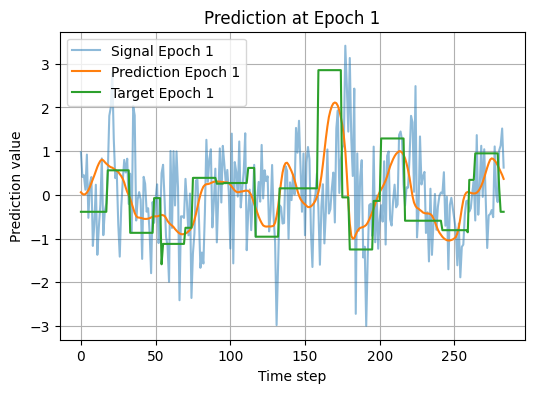

Epoch 1/10, Validation Loss: 0.3536
Epoch 1/10, Validation Loss smooth: 0.3839
Epoch 2/10, Train Loss: 0.3448
Epoch 2/10, Train Loss smooth: 0.5195


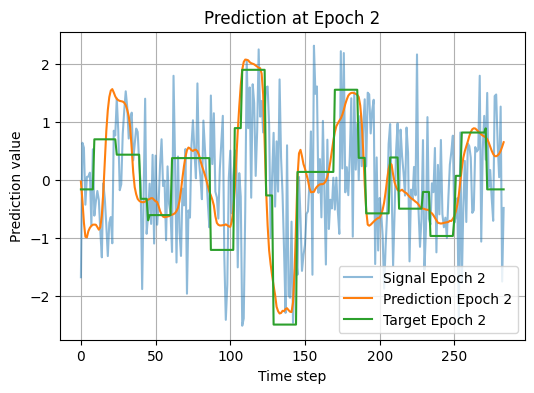

Epoch 2/10, Validation Loss: 0.3372
Epoch 2/10, Validation Loss smooth: 0.3235
Epoch 3/10, Train Loss: 0.3332
Epoch 3/10, Train Loss smooth: 0.4492


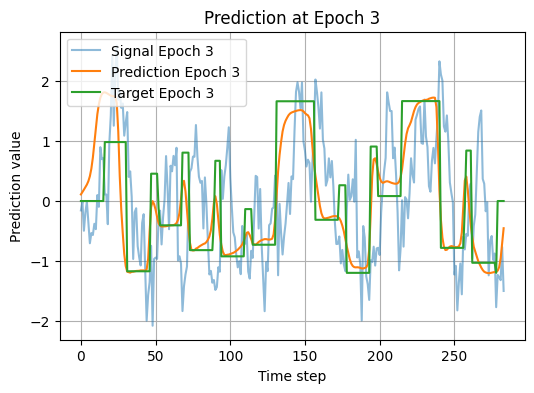

Epoch 3/10, Validation Loss: 0.3300
Epoch 3/10, Validation Loss smooth: 0.3032
Epoch 4/10, Train Loss: 0.3286
Epoch 4/10, Train Loss smooth: 0.3766


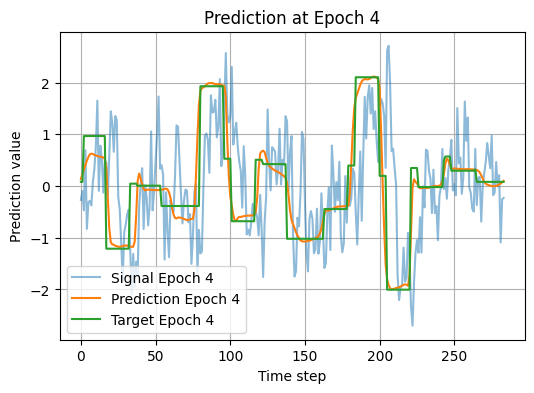

Epoch 4/10, Validation Loss: 0.3275
Epoch 4/10, Validation Loss smooth: 0.2574
Epoch 5/10, Train Loss: 0.3269
Epoch 5/10, Train Loss smooth: 0.2900


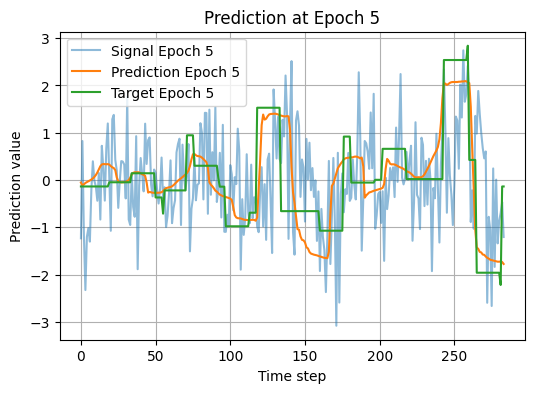

Epoch 5/10, Validation Loss: 0.3357
Epoch 5/10, Validation Loss smooth: 0.2241
Epoch 6/10, Train Loss: 0.3272
Epoch 6/10, Train Loss smooth: 0.2204


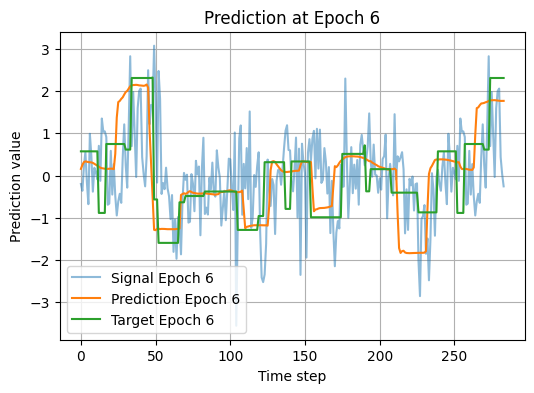

Epoch 6/10, Validation Loss: 0.3329
Epoch 6/10, Validation Loss smooth: 0.1782
Epoch 7/10, Train Loss: 0.3299
Epoch 7/10, Train Loss smooth: 0.1715


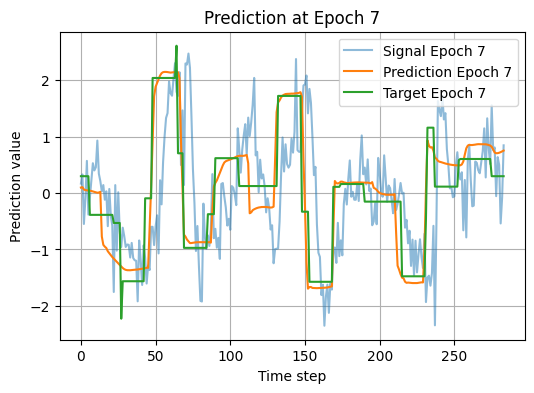

Epoch 7/10, Validation Loss: 0.3368
Epoch 7/10, Validation Loss smooth: 0.1730
Epoch 8/10, Train Loss: 0.3347
Epoch 8/10, Train Loss smooth: 0.1360


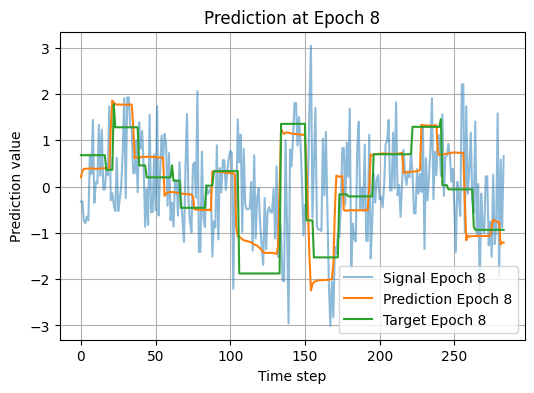

Epoch 8/10, Validation Loss: 0.3438
Epoch 8/10, Validation Loss smooth: 0.1368
Epoch 9/10, Train Loss: 0.3412
Epoch 9/10, Train Loss smooth: 0.1104


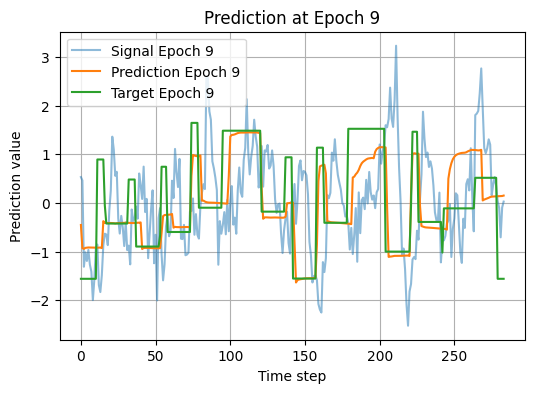

Epoch 9/10, Validation Loss: 0.3487
Epoch 9/10, Validation Loss smooth: 0.1225
Epoch 10/10, Train Loss: 0.3487
Epoch 10/10, Train Loss smooth: 0.0913


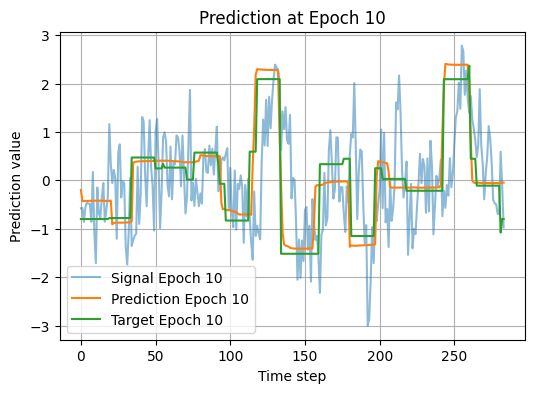

Epoch 10/10, Validation Loss: 0.3536
Epoch 10/10, Validation Loss smooth: 0.1118


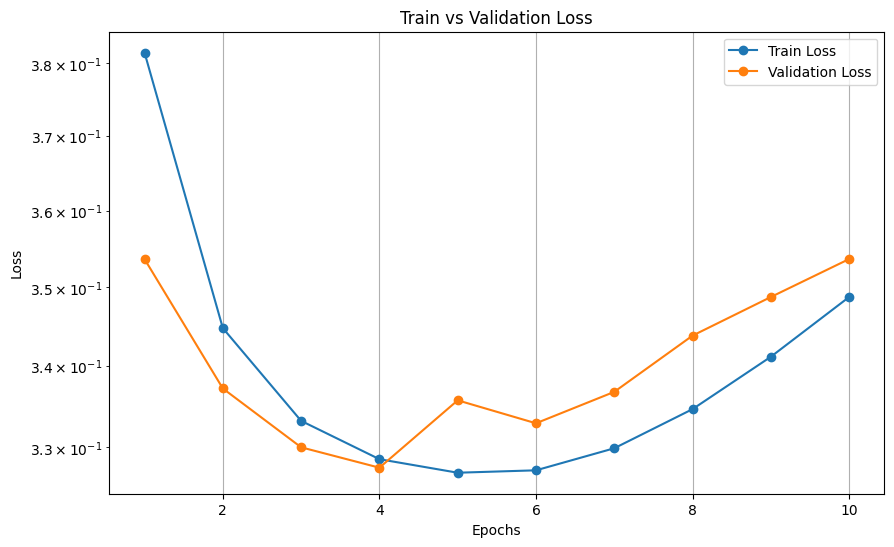

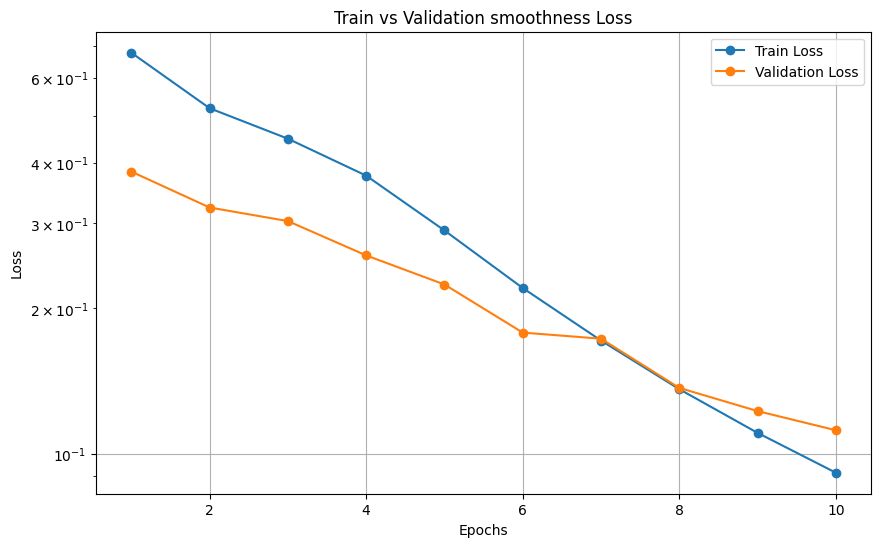

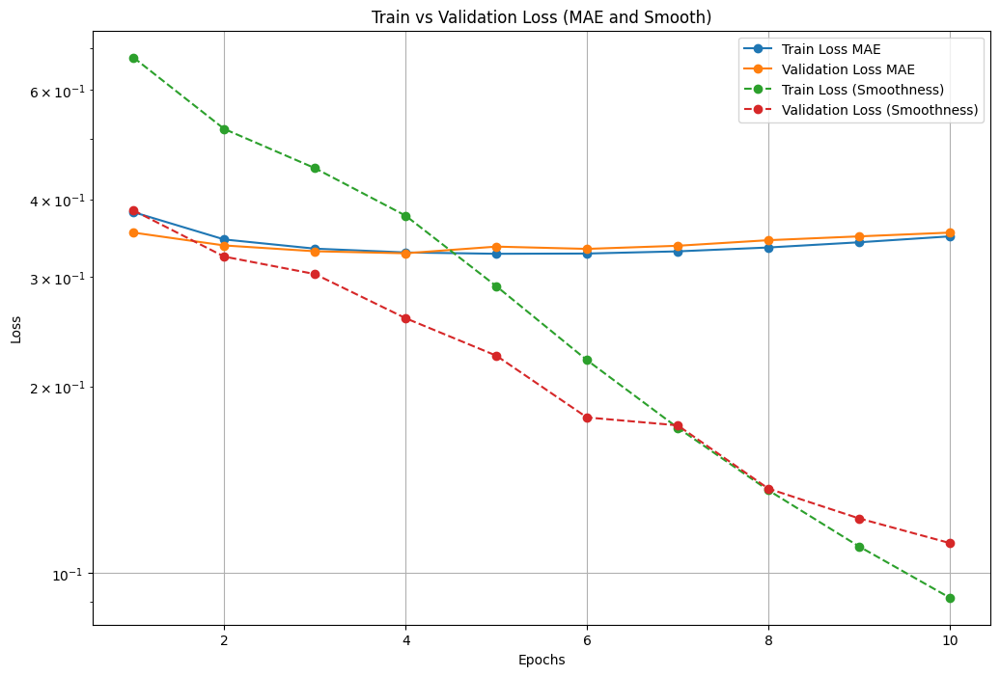

In [55]:
best_model_state = train_model_with_early_stopping(
    model, criterion, train_loader, validation_loader, optimizer, 
    num_epochs, device, patience=patience, lambda_val=lambda_val_train,
    alpha=alpha,beta=beta,lambda_tv=lambda_tv,lambda_const=lambda_const
)


In [92]:
pytorch_total_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(pytorch_total_params)

136809


Text(0.5, 1.0, 'Kernel of the network, size = 40')

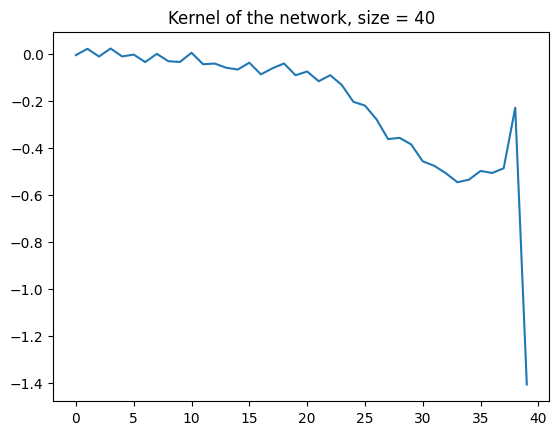

In [65]:
plt.plot(model.kernel[0].cpu(),label='kernel of the network')
plt.title('Kernel of the network, size = 40')

In [87]:
convovled_noisy=F.conv1d(x.view(1,1,-1),model.kernel[0].cpu().flip(0).unsqueeze(0).unsqueeze(0))

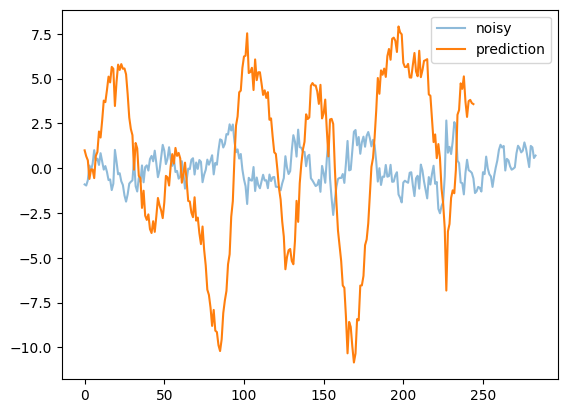

In [88]:
plt.plot(x.cpu(),label='noisy',alpha=0.5)
plt.plot(convovled_noisy[0,0,:].cpu(),label='prediction')
plt.legend()

In [43]:
print(torch.version.cuda,torch.version.__version__)

11.8 2.5.0


In [32]:
from datetime import datetime

timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
filename = f"model_{timestamp}.pth"
filename = f"model_BEST_{timestamp}.pth"

torch.save(model.state_dict(), filename)
filename = f"model_BEST_finale.pth"
torch.save(model.state_dict(), filename)

print(f"Model saved as {filename}")

Model saved as model_BEST_finale.pth


In [331]:

#best_model_state = torch.load('model_BEST_20241216_180644.pth')
#best_model_state = torch.load('model_best.pth')
#best_model_state =  torch.load(filename)
model.load_state_dict(best_model_state)


/tmp/ipykernel_645584/3687596683.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model_state = torch.load('model_best.pth')


<All keys matched successfully>

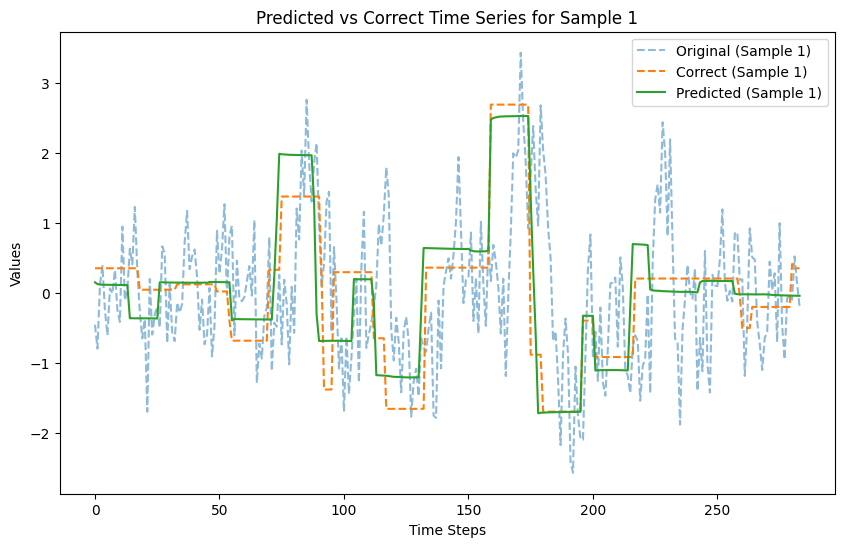

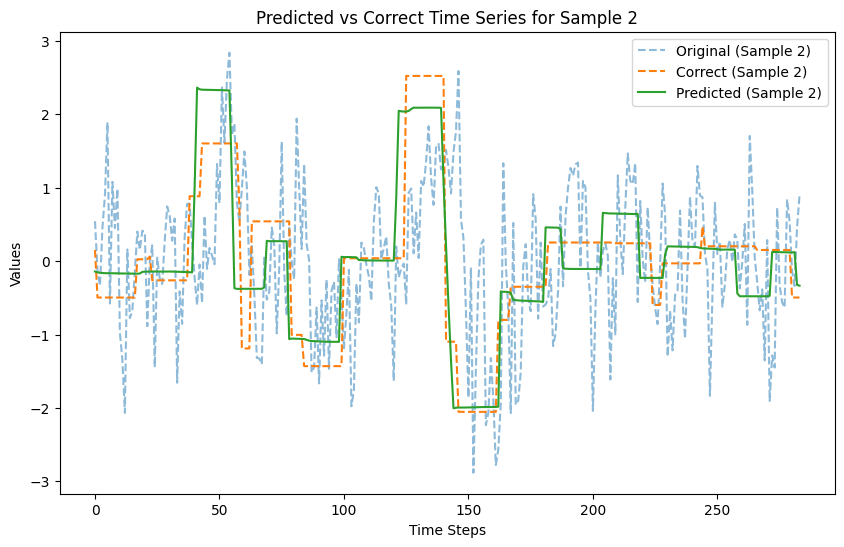

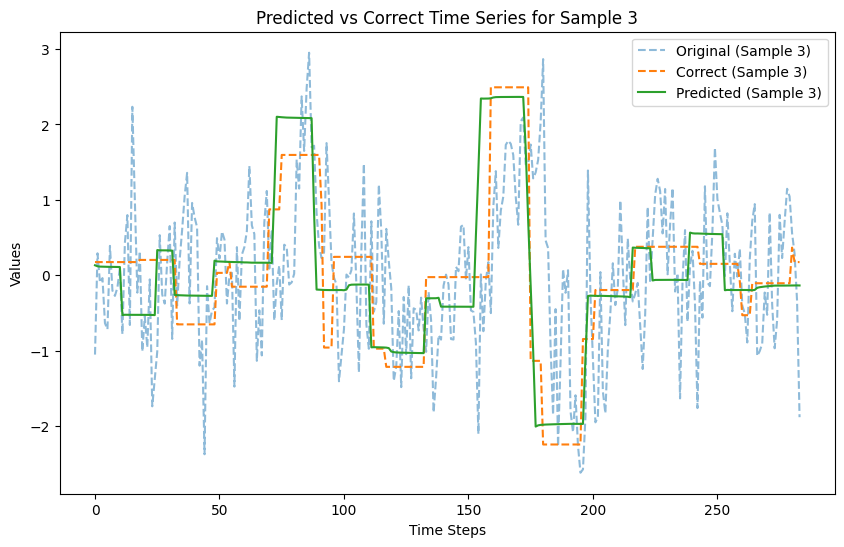

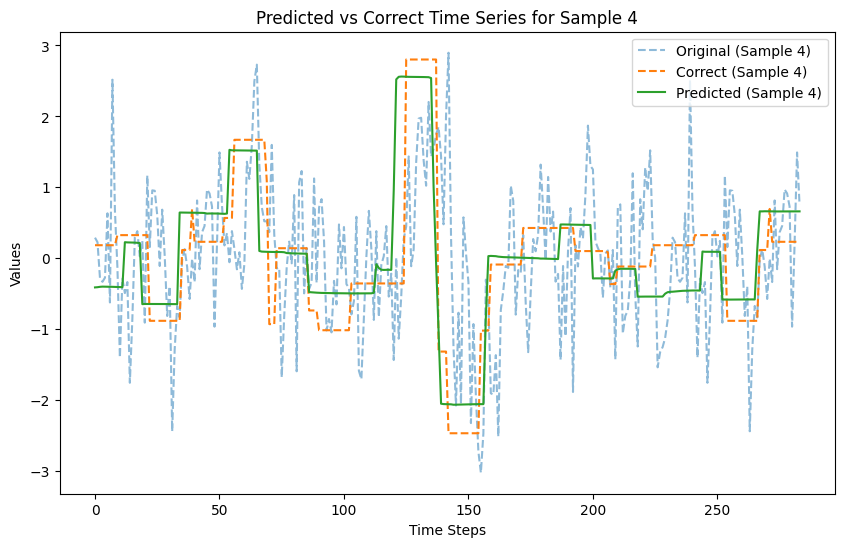

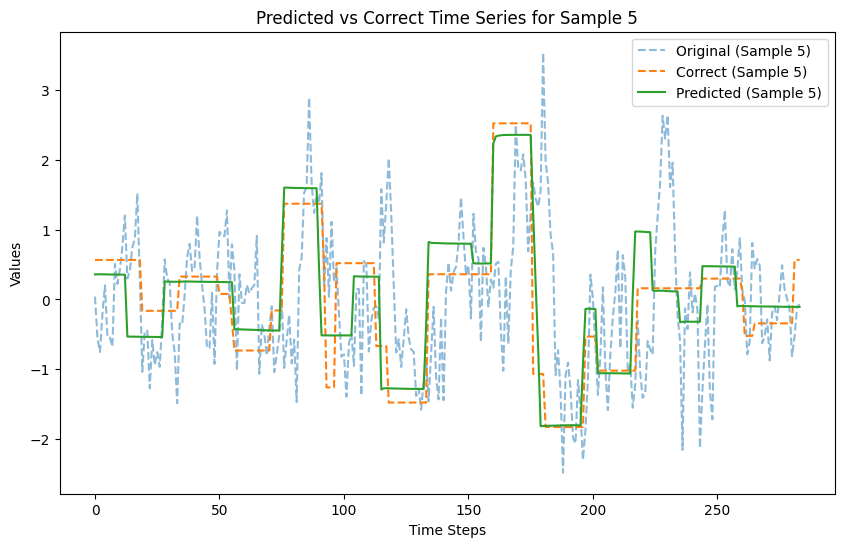

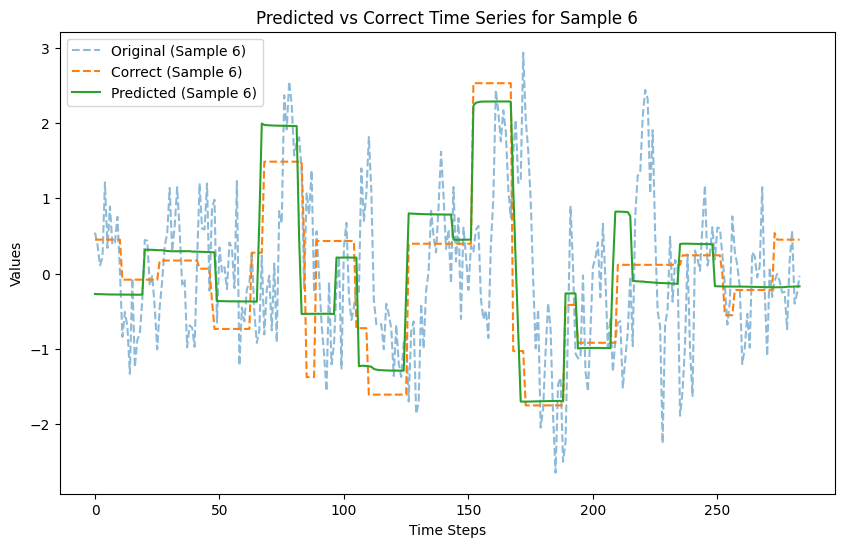

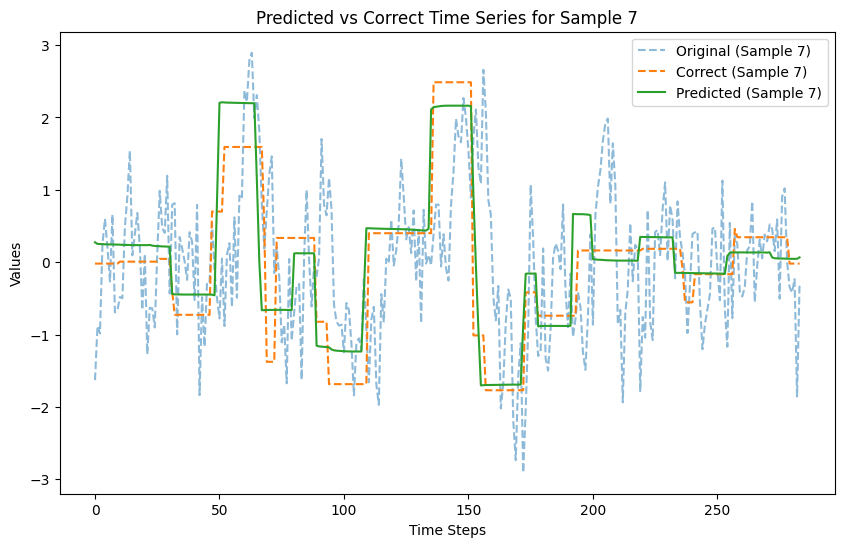

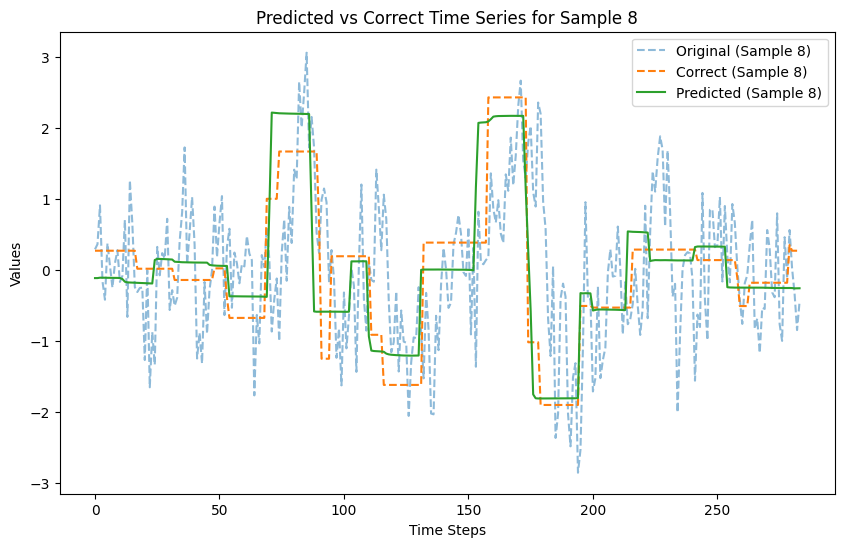

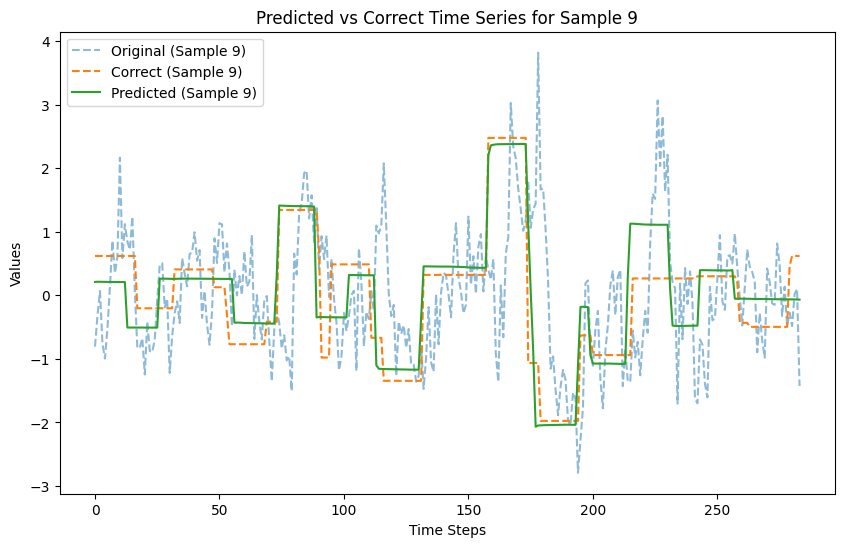

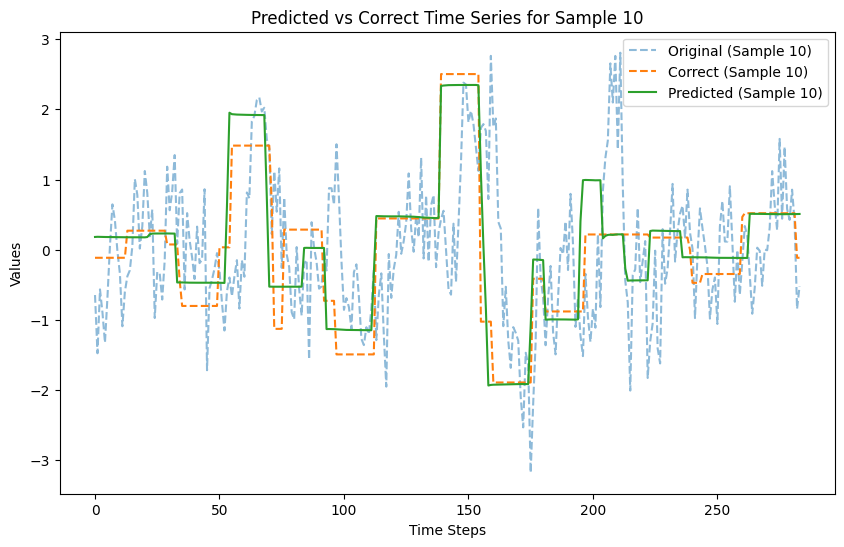

In [33]:
import matplotlib.pyplot as plt
# Assuming the model is already trained
model.eval()  # Set the model to evaluation mode

# Select one batch of test data from the loader
for X_sample, Y_sample in validation_loader:
    X_sample, Y_sample = X_sample.to(device), Y_sample.to(device)
    break  # Take the first batch

for i in range(10):
    X_sample_single = X_sample[i]
    Y_sample_single = Y_sample[i]

    # Get the prediction
    with torch.no_grad():
        Y_pred_single = model(X_sample_single.unsqueeze(0))  # Add batch dimension
        Y_pred_single = Y_pred_single.squeeze(0)  # Remove batch dimension

    # Convert to numpy for plotting
    Y_sample_single = Y_sample_single.cpu().numpy()
    Y_pred_single = Y_pred_single.cpu().numpy()
    X_sample_single= X_sample_single.cpu().numpy()
    # Plot
    plt.figure(figsize=(10, 6))
    plt.plot(X_sample_single, label=f'Original (Sample {i+1})', linestyle='--',alpha=0.5)

    plt.plot(Y_sample_single, label=f'Correct (Sample {i+1})', linestyle='--')
    plt.plot(Y_pred_single, label=f'Predicted (Sample {i+1})', linestyle='-')
    plt.xlabel('Time Steps')
    plt.ylabel('Values')
    plt.title(f'Predicted vs Correct Time Series for Sample {i+1}')
    plt.legend()
    plt.show()

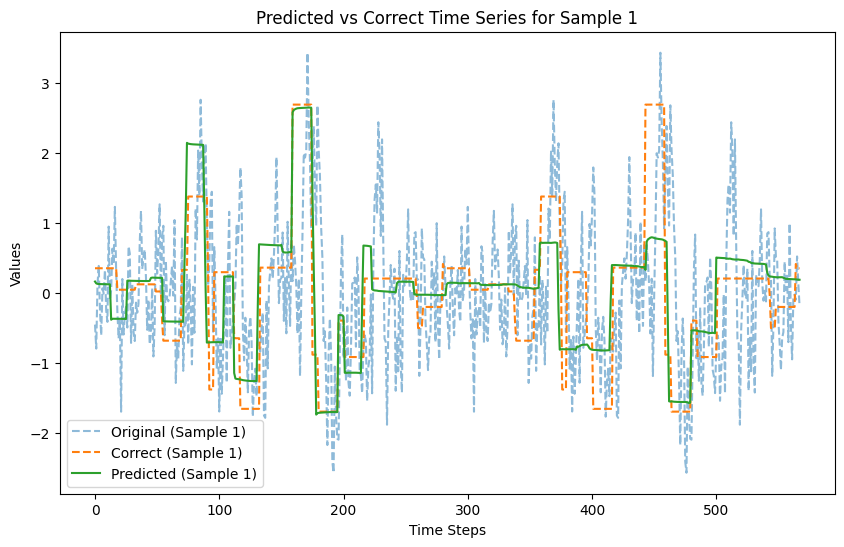

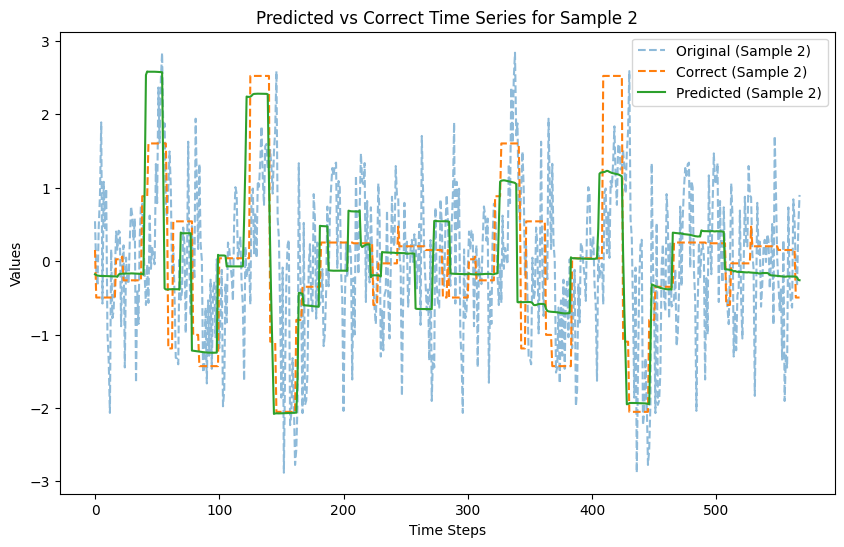

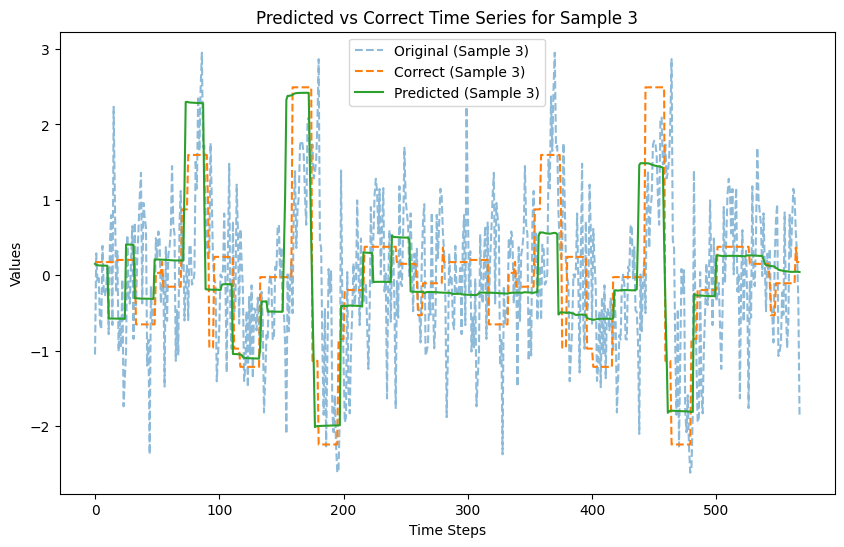

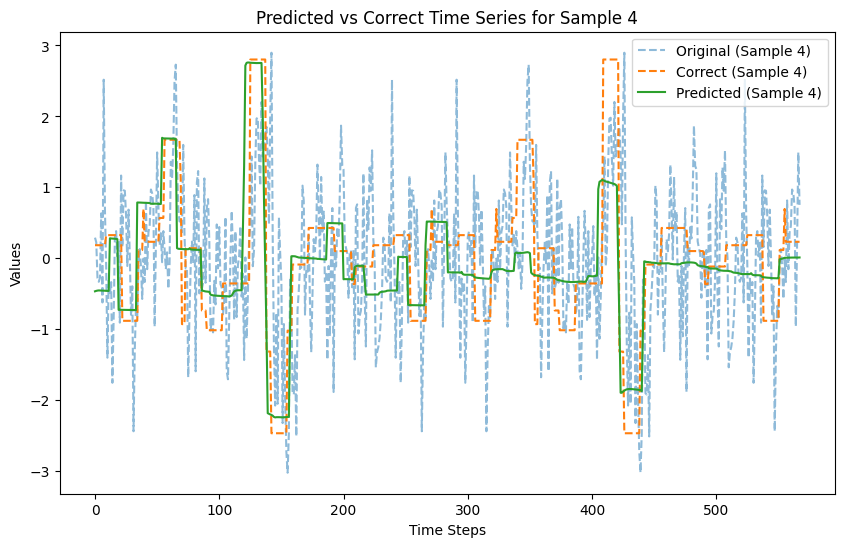

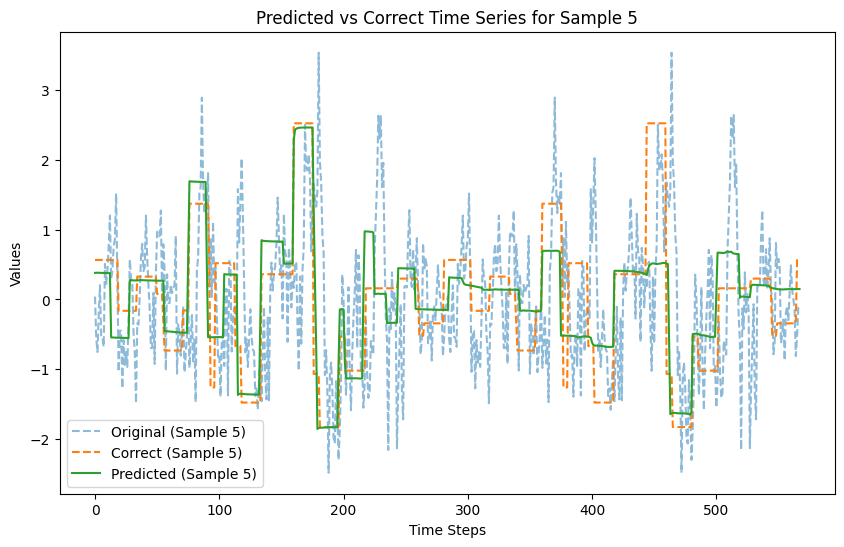

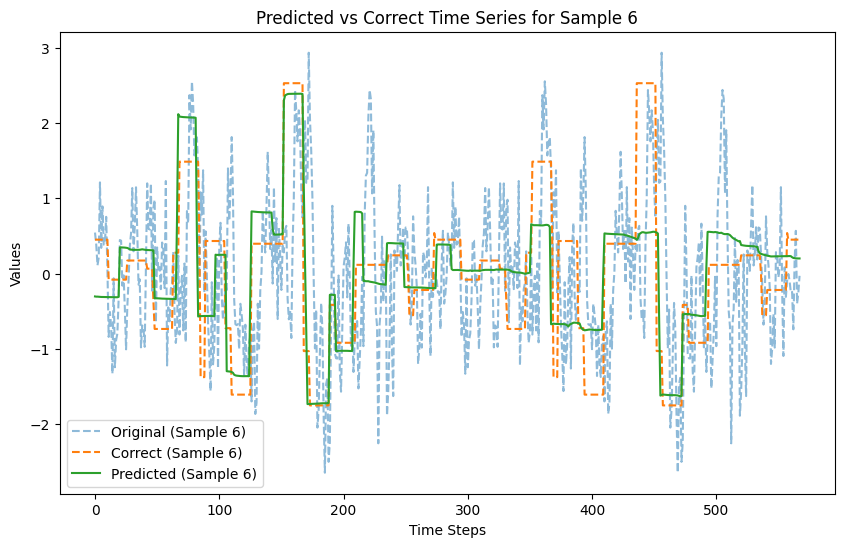

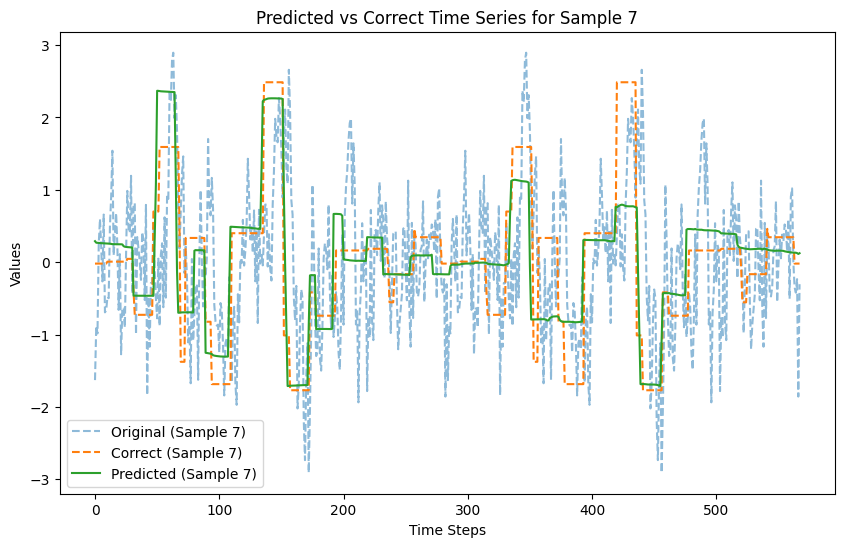

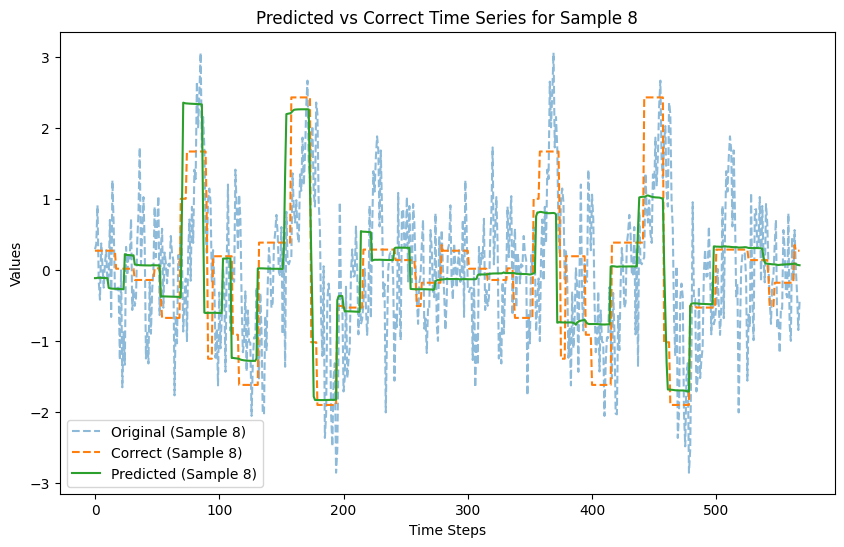

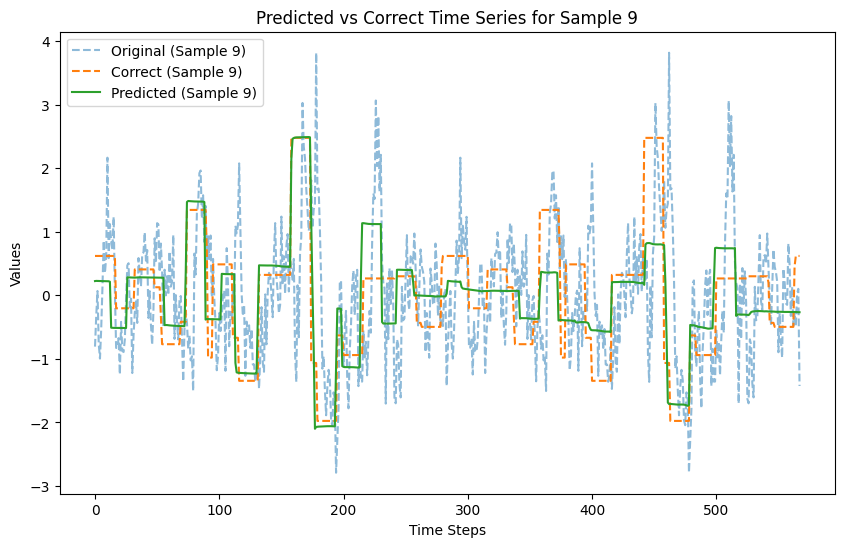

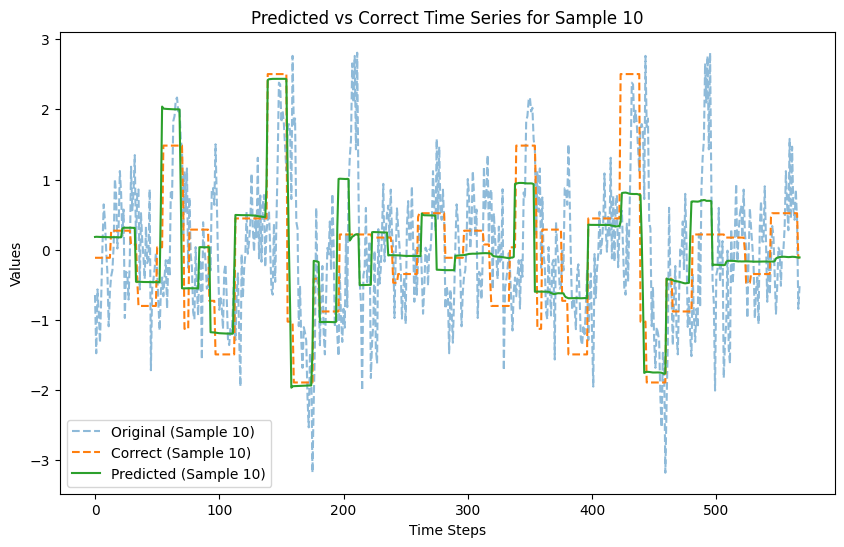

In [34]:
import matplotlib.pyplot as plt
# Assuming the model is already trained
model.eval()  # Set the model to evaluation mode

# Select one batch of test data from the loader
for X_sample, Y_sample in validation_loader:
    X_sample, Y_sample = X_sample.to(device), Y_sample.to(device)
    X_sample = torch.cat([X_sample,X_sample],dim=1)
    Y_sample = torch.cat([Y_sample,Y_sample],dim=1)
    break  # Take the first batch

for i in range(10):
    X_sample_single = X_sample[i]
    Y_sample_single = Y_sample[i]

    # Get the prediction
    with torch.no_grad():
        Y_pred_single = model(X_sample_single.unsqueeze(0))  # Add batch dimension
        Y_pred_single = Y_pred_single.squeeze(0)  # Remove batch dimension

    # Convert to numpy for plotting
    Y_sample_single = Y_sample_single.cpu().numpy()
    Y_pred_single = Y_pred_single.cpu().numpy()
    X_sample_single= X_sample_single.cpu().numpy()
    # Plot
    plt.figure(figsize=(10, 6))
    plt.plot(X_sample_single, label=f'Original (Sample {i+1})', linestyle='--',alpha=0.5)

    plt.plot(Y_sample_single, label=f'Correct (Sample {i+1})', linestyle='--')
    plt.plot(Y_pred_single, label=f'Predicted (Sample {i+1})', linestyle='-')
    plt.xlabel('Time Steps')
    plt.ylabel('Values')
    plt.title(f'Predicted vs Correct Time Series for Sample {i+1}')
    plt.legend()
    plt.show()

### New subjects

In [35]:
test_dataset = TensorDataset(X_test_def, Y_test_def)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True)

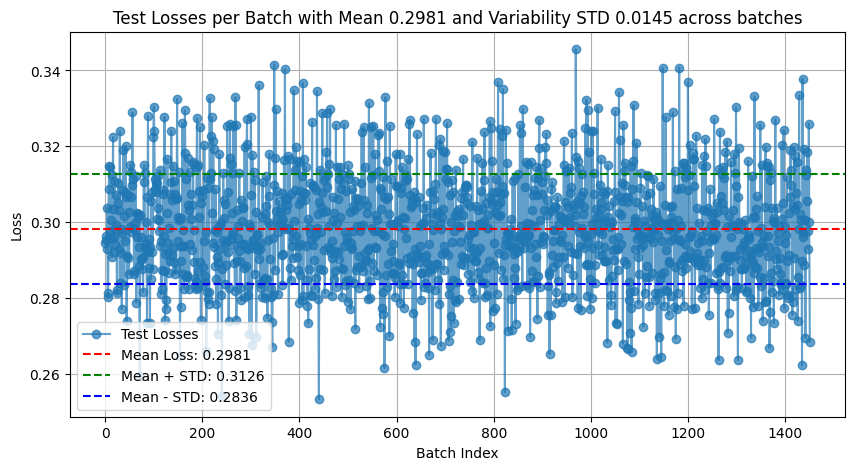

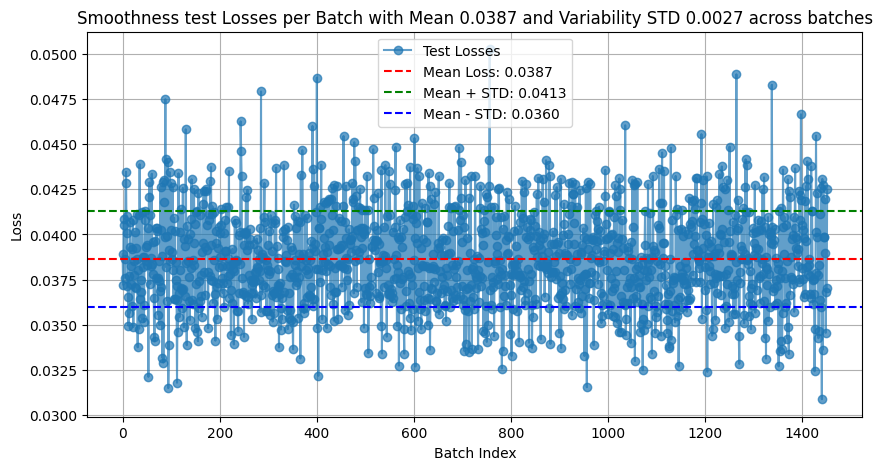

In [36]:
model.eval()
total_test_loss = 0
loss_list = []
smoothness_loss_list = []
dup=False
with torch.no_grad():
    for batch_x, batch_y in test_loader:
        batch_x, batch_y = batch_x.to(device), batch_y.to(device)
        if dup:
            batch_x = torch.cat([batch_x,batch_x],dim=1)
            batch_y = torch.cat([batch_y,batch_y],dim=1)
        predictions = model(batch_x)
        loss = criterion(predictions, batch_y)
        smoothness_loss = lambda_val*penalizing_function(predictions,alpha=alpha,beta=beta,lambda_tv=lambda_tv,lambda_const=lambda_const)
        total_test_loss += loss.item()
        loss_list.append(loss.item())
        smoothness_loss_list.append(smoothness_loss.item())

avg_test_loss = np.mean(loss_list)
std_test_loss = np.std(loss_list)

# Line plot of losses
plt.figure(figsize=(10, 5))
plt.plot(loss_list, marker='o', alpha=0.7, label='Test Losses')
plt.axhline(avg_test_loss, color='red', linestyle='--', label=f'Mean Loss: {avg_test_loss:.4f}')
plt.axhline(avg_test_loss + std_test_loss, color='green', linestyle='--', label=f'Mean + STD: {avg_test_loss + std_test_loss:.4f}')
plt.axhline(avg_test_loss - std_test_loss, color='blue', linestyle='--', label=f'Mean - STD: {avg_test_loss - std_test_loss:.4f}')
plt.xlabel('Batch Index')
plt.ylabel('Loss')
plt.title(f'Test Losses per Batch with Mean {avg_test_loss:.4f} and Variability STD {std_test_loss:.4f} across batches')
plt.legend()
plt.grid(True)
plt.show()

avg_test_loss = np.mean(smoothness_loss_list)
std_test_loss = np.std(smoothness_loss_list)

# Line plot of losses
plt.figure(figsize=(10, 5))
plt.plot(smoothness_loss_list, marker='o', alpha=0.7, label='Test Losses')
plt.axhline(avg_test_loss, color='red', linestyle='--', label=f'Mean Loss: {avg_test_loss:.4f}')
plt.axhline(avg_test_loss + std_test_loss, color='green', linestyle='--', label=f'Mean + STD: {avg_test_loss + std_test_loss:.4f}')
plt.axhline(avg_test_loss - std_test_loss, color='blue', linestyle='--', label=f'Mean - STD: {avg_test_loss - std_test_loss:.4f}')
plt.xlabel('Batch Index')
plt.ylabel('Loss')
plt.title(f'Smoothness test Losses per Batch with Mean {avg_test_loss:.4f} and Variability STD {std_test_loss:.4f} across batches')
plt.legend()
plt.grid(True)
plt.show()

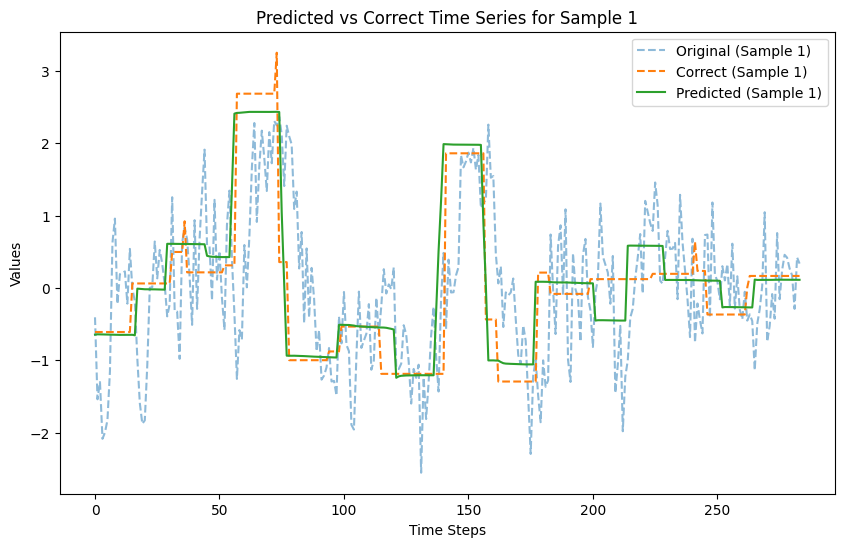

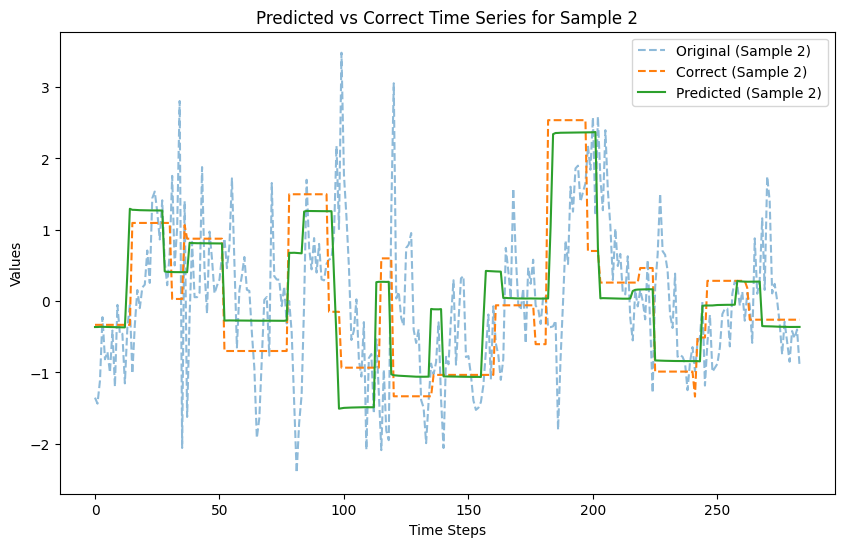

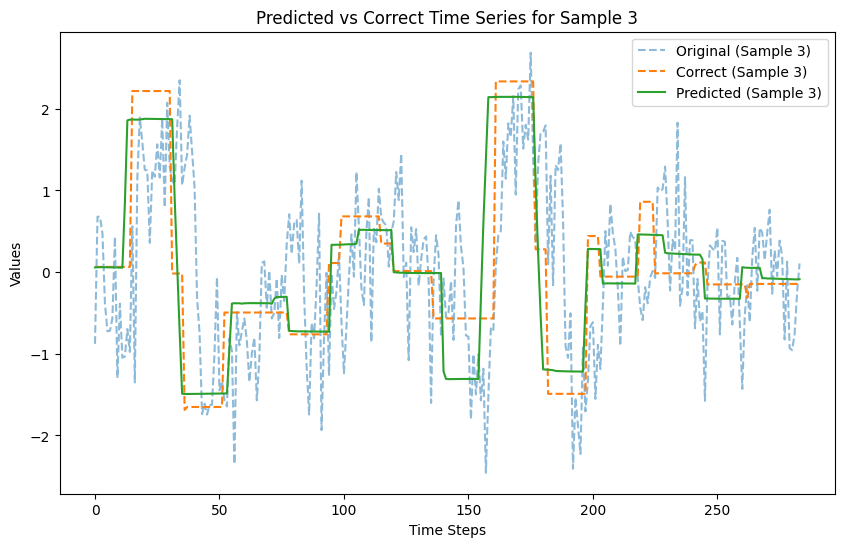

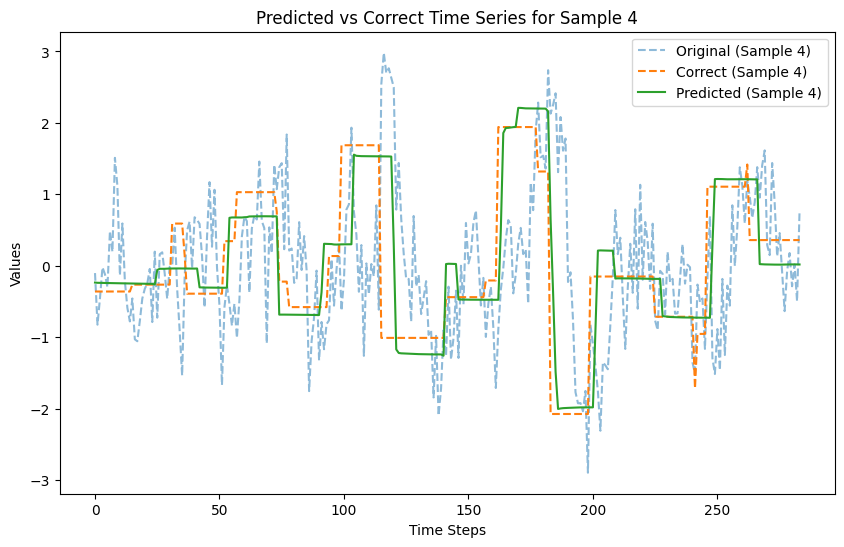

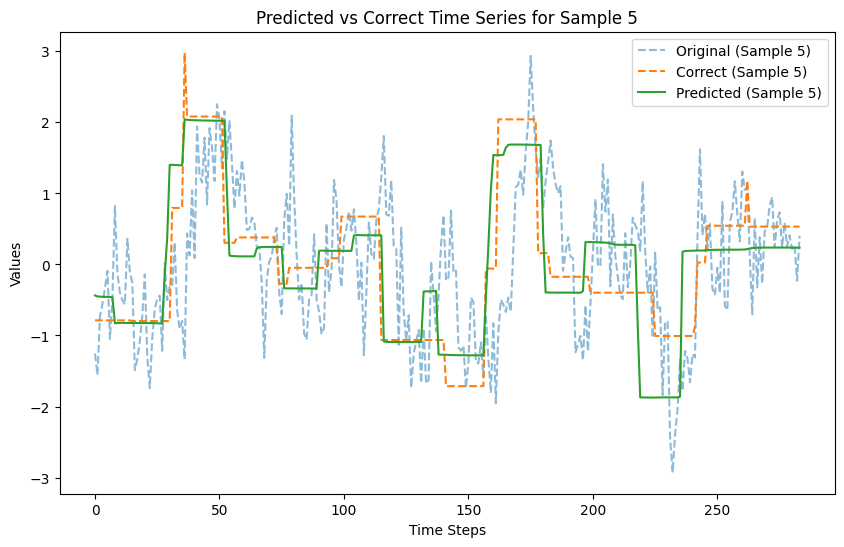

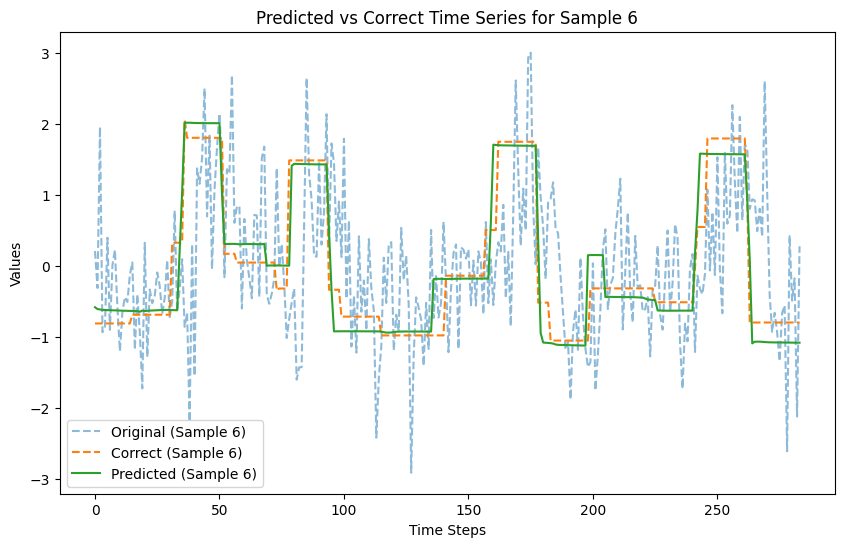

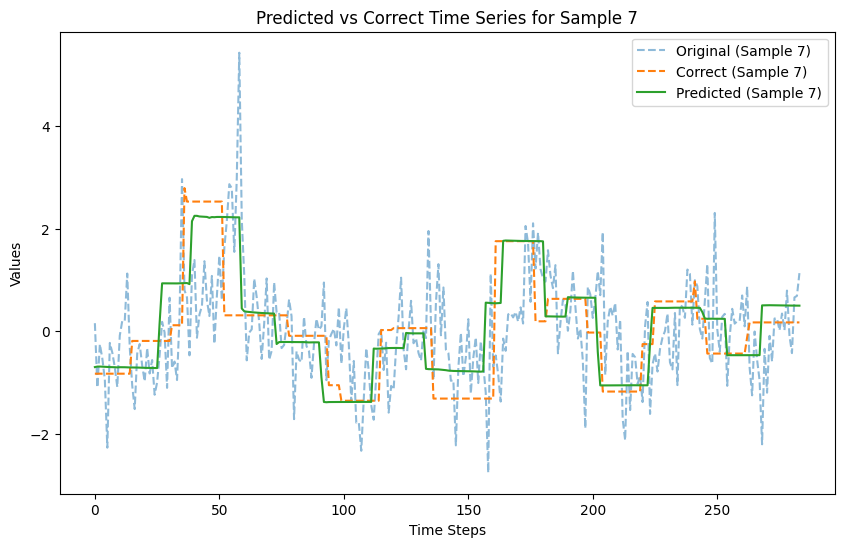

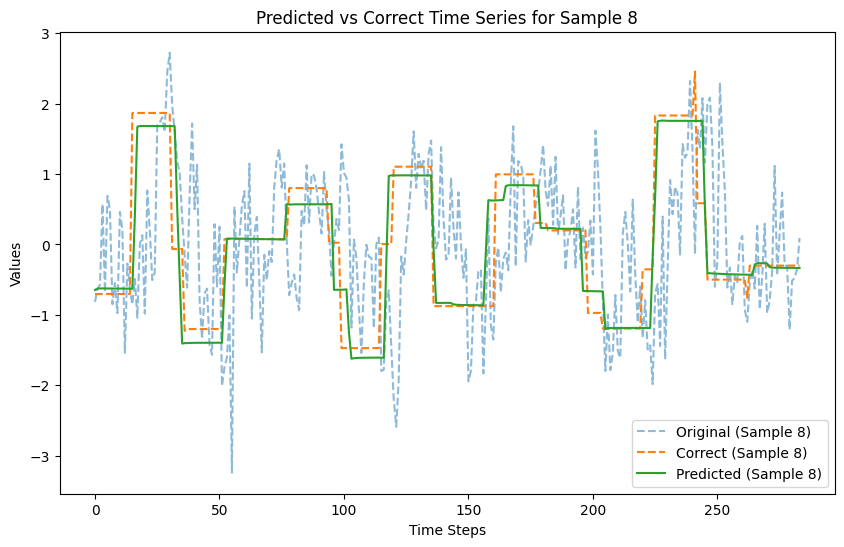

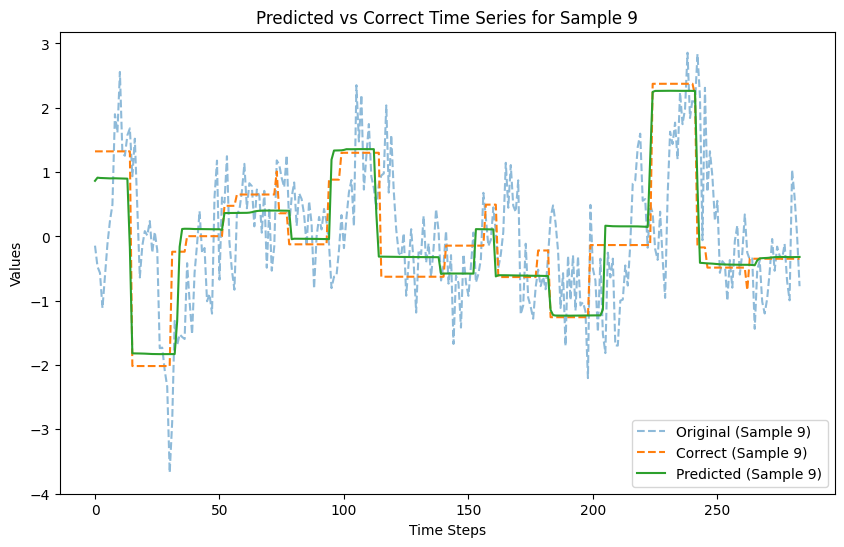

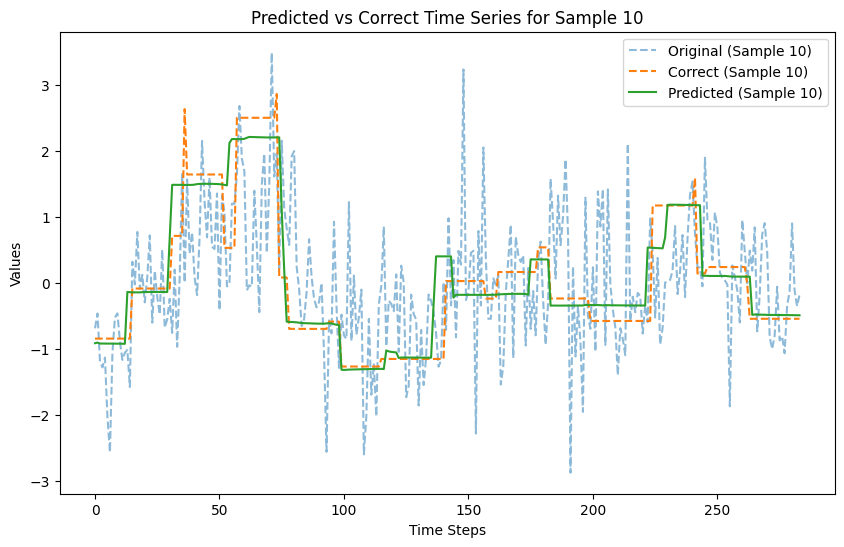

In [37]:
import matplotlib.pyplot as plt
# Assuming the model is already trained
model.eval()  # Set the model to evaluation mode

# Select one batch of test data from the loader
for X_sample, Y_sample in test_loader:
    X_sample, Y_sample = X_sample.to(device), Y_sample.to(device)
    if dup:
        X_sample = torch.cat([X_sample,X_sample],dim=1)
        Y_sample = torch.cat([Y_sample,Y_sample],dim=1)
    break  # Take the first batch

for i in range(10):
    X_sample_single = X_sample[i]
    Y_sample_single = Y_sample[i]

    # Get the prediction
    with torch.no_grad():
        Y_pred_single = model(X_sample_single.unsqueeze(0))  # Add batch dimension
        Y_pred_single = Y_pred_single.squeeze(0)  # Remove batch dimension

    # Convert to numpy for plotting
    Y_sample_single = Y_sample_single.cpu().numpy()
    Y_pred_single = Y_pred_single.cpu().numpy()
    X_sample_single = X_sample_single.cpu().numpy()
    # Plot
    plt.figure(figsize=(10, 6))
    plt.plot(X_sample_single, label=f'Original (Sample {i+1})', linestyle='--',alpha=0.5)

    plt.plot(Y_sample_single, label=f'Correct (Sample {i+1})', linestyle='--')
    plt.plot(Y_pred_single, label=f'Predicted (Sample {i+1})', linestyle='-')
    plt.xlabel('Time Steps')
    plt.ylabel('Values')
    plt.title(f'Predicted vs Correct Time Series for Sample {i+1}')
    plt.legend()
    plt.show()

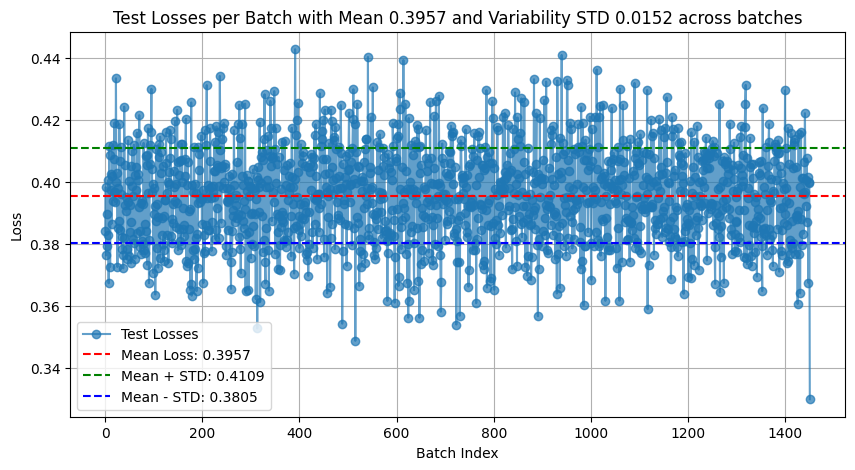

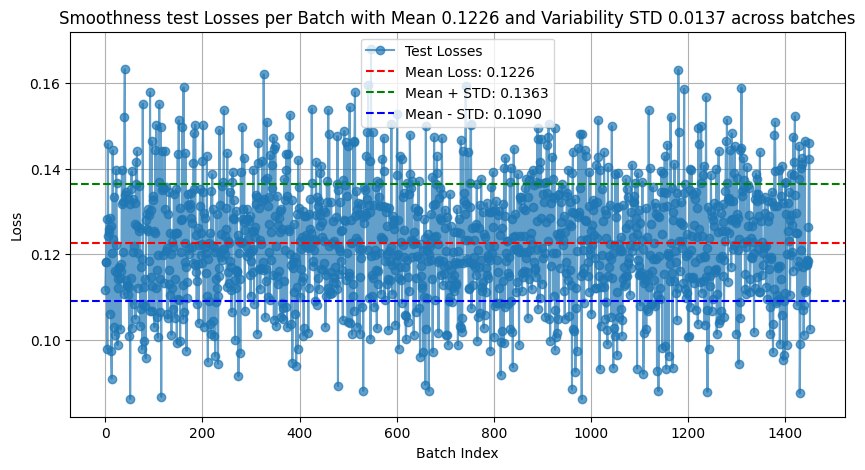

In [38]:
model.eval()
total_test_loss = 0
loss_list = []
smoothness_loss_list = []
dup=True
with torch.no_grad():
    for batch_x, batch_y in test_loader:
        batch_x, batch_y = batch_x.to(device), batch_y.to(device)
        if dup:
            batch_x = torch.cat([batch_x,batch_x],dim=1)
            batch_y = torch.cat([batch_y,batch_y],dim=1)
        predictions = model(batch_x)
        loss = criterion(predictions, batch_y)
        smoothness_loss = lambda_val*penalizing_function(predictions,alpha=alpha,beta=beta,lambda_tv=lambda_tv,lambda_const=lambda_const)
        total_test_loss += loss.item()
        loss_list.append(loss.item())
        smoothness_loss_list.append(smoothness_loss.item())

avg_test_loss = np.mean(loss_list)
std_test_loss = np.std(loss_list)

# Line plot of losses
plt.figure(figsize=(10, 5))
plt.plot(loss_list, marker='o', alpha=0.7, label='Test Losses')
plt.axhline(avg_test_loss, color='red', linestyle='--', label=f'Mean Loss: {avg_test_loss:.4f}')
plt.axhline(avg_test_loss + std_test_loss, color='green', linestyle='--', label=f'Mean + STD: {avg_test_loss + std_test_loss:.4f}')
plt.axhline(avg_test_loss - std_test_loss, color='blue', linestyle='--', label=f'Mean - STD: {avg_test_loss - std_test_loss:.4f}')
plt.xlabel('Batch Index')
plt.ylabel('Loss')
plt.title(f'Test Losses per Batch with Mean {avg_test_loss:.4f} and Variability STD {std_test_loss:.4f} across batches')
plt.legend()
plt.grid(True)
plt.show()


avg_test_loss = np.mean(smoothness_loss_list)
std_test_loss = np.std(smoothness_loss_list)

# Line plot of losses
plt.figure(figsize=(10, 5))
plt.plot(smoothness_loss_list, marker='o', alpha=0.7, label='Test Losses')
plt.axhline(avg_test_loss, color='red', linestyle='--', label=f'Mean Loss: {avg_test_loss:.4f}')
plt.axhline(avg_test_loss + std_test_loss, color='green', linestyle='--', label=f'Mean + STD: {avg_test_loss + std_test_loss:.4f}')
plt.axhline(avg_test_loss - std_test_loss, color='blue', linestyle='--', label=f'Mean - STD: {avg_test_loss - std_test_loss:.4f}')
plt.xlabel('Batch Index')
plt.ylabel('Loss')
plt.title(f'Smoothness test Losses per Batch with Mean {avg_test_loss:.4f} and Variability STD {std_test_loss:.4f} across batches')
plt.legend()
plt.grid(True)
plt.show()

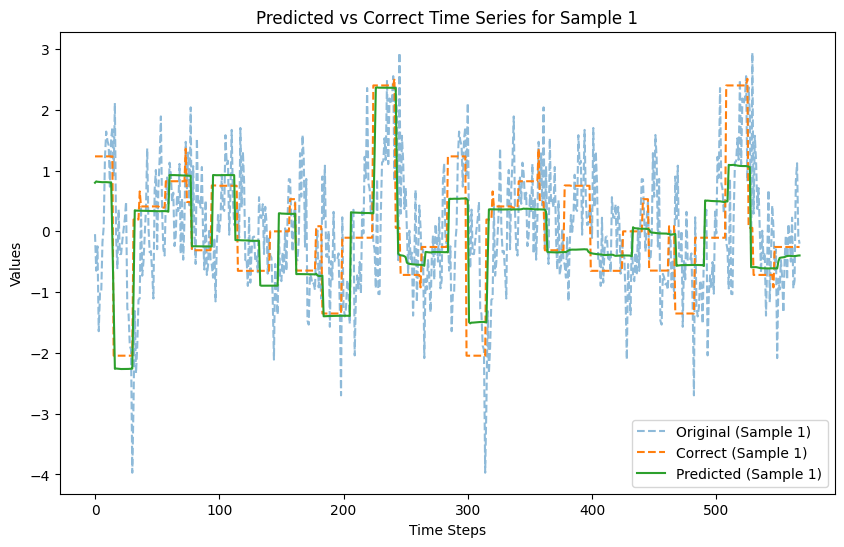

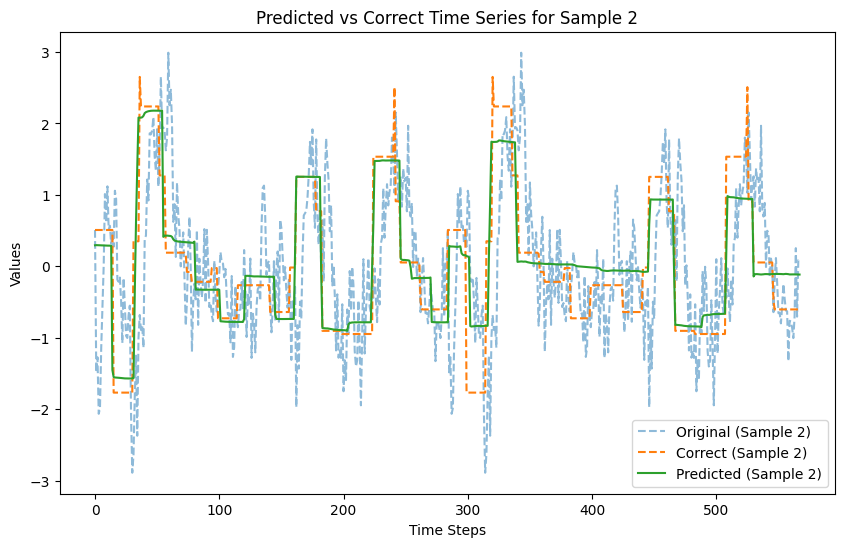

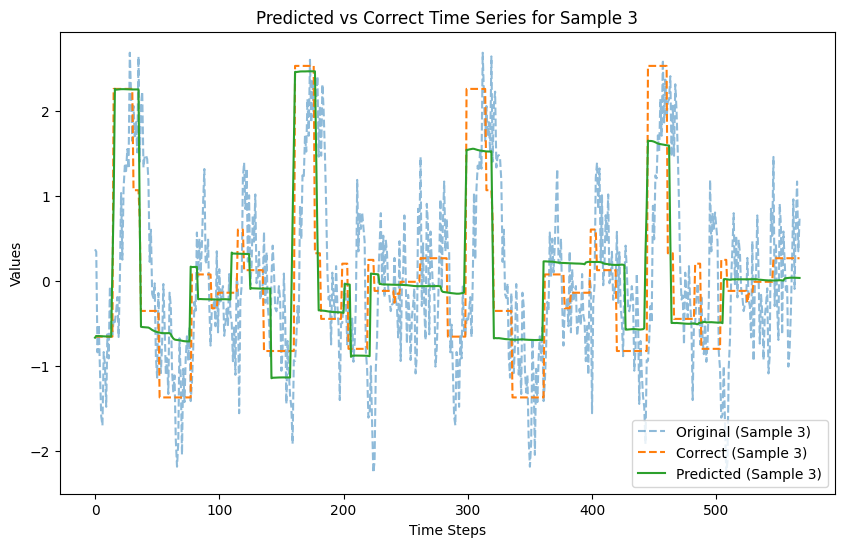

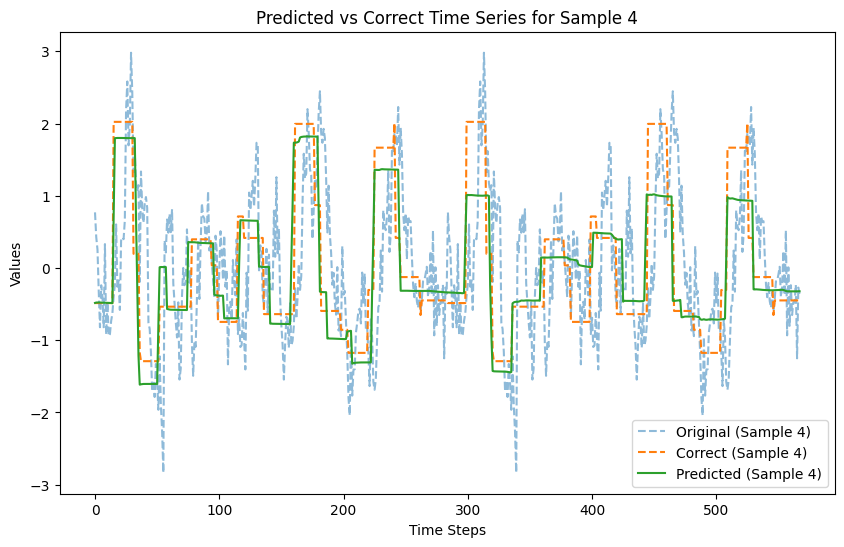

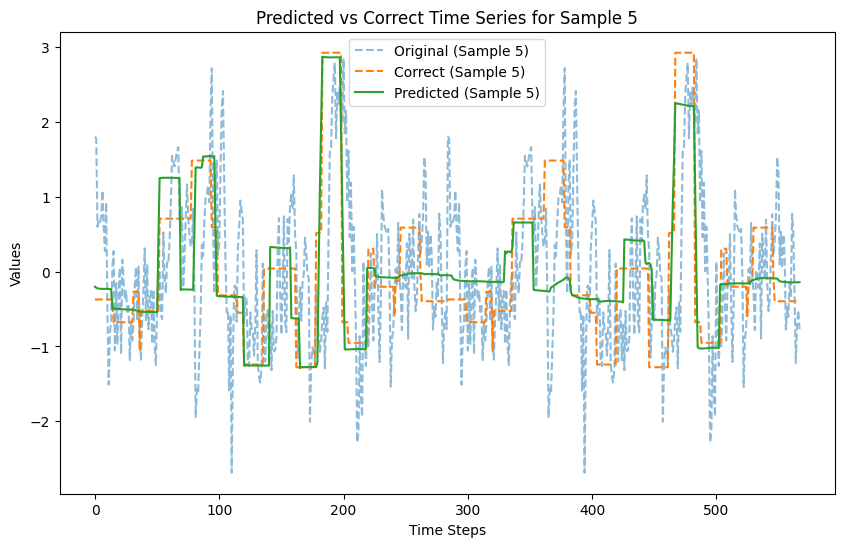

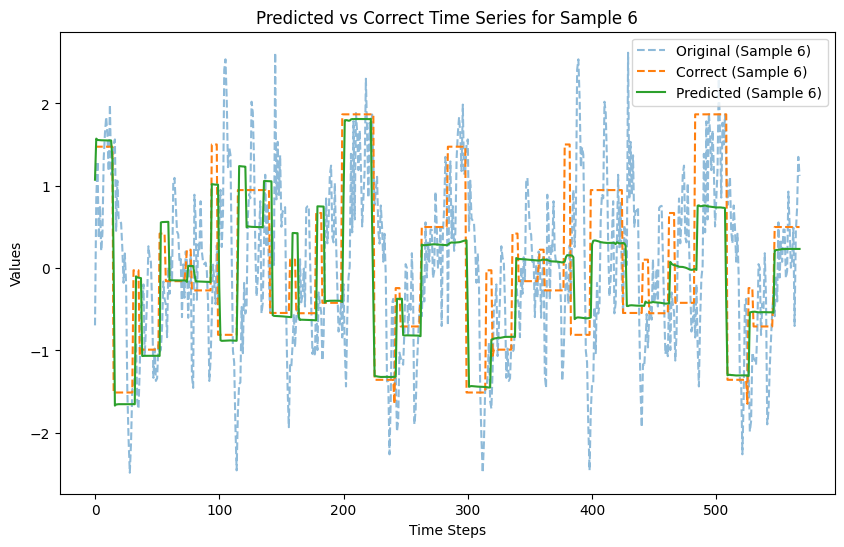

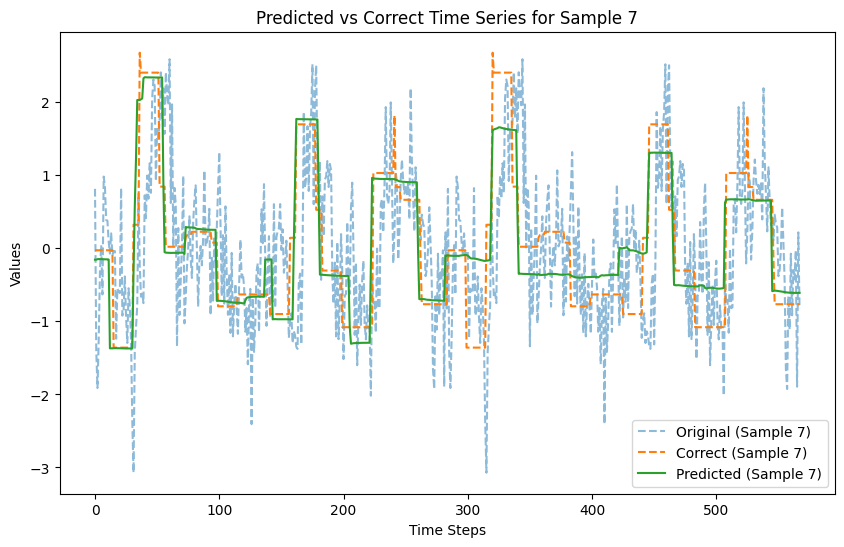

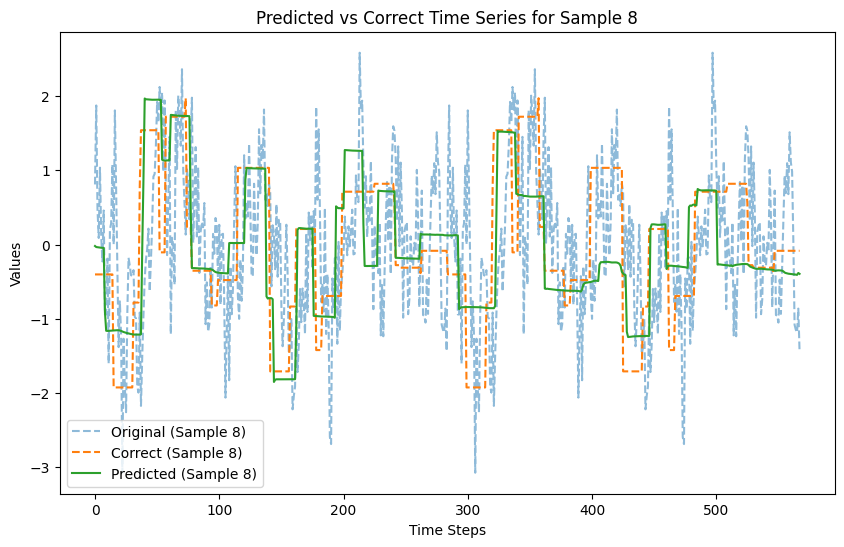

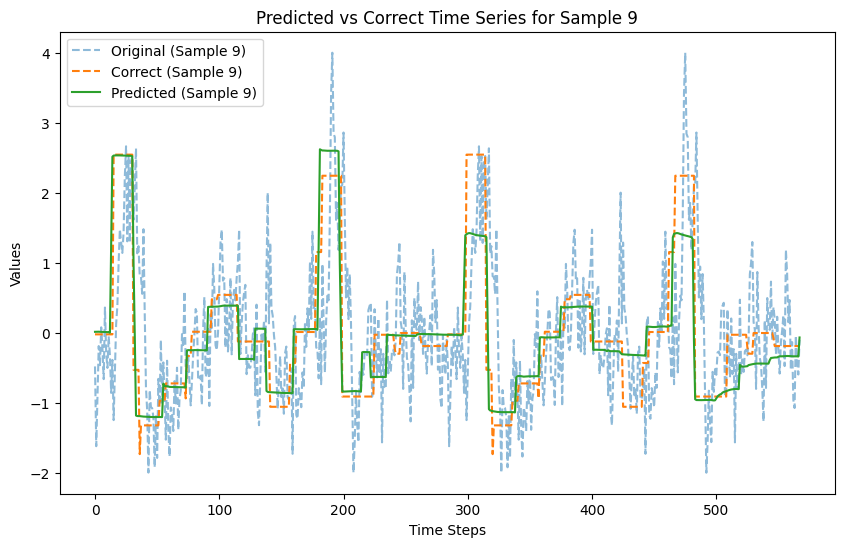

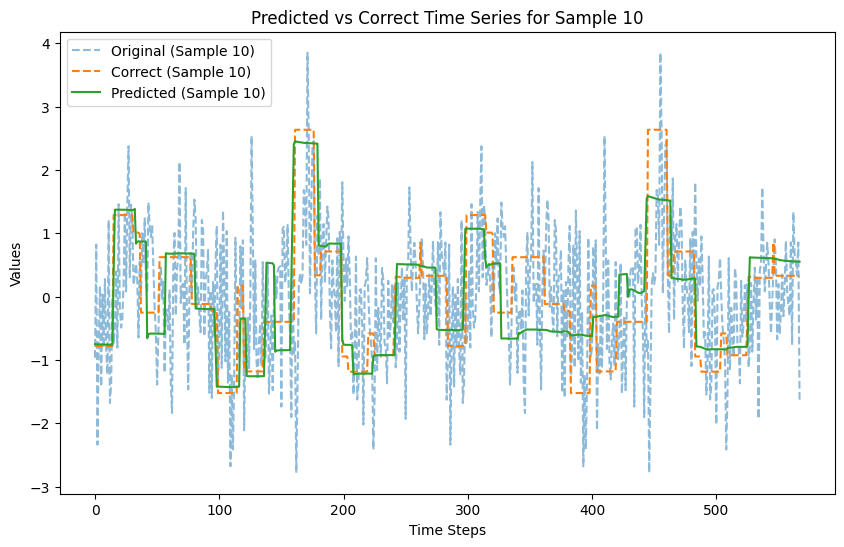

In [39]:
import matplotlib.pyplot as plt
# Assuming the model is already trained
model.eval()  # Set the model to evaluation mode

# Select one batch of test data from the loader
for X_sample, Y_sample in test_loader:
    X_sample, Y_sample = X_sample.to(device), Y_sample.to(device)
    if dup:
        X_sample = torch.cat([X_sample,X_sample],dim=1)
        Y_sample = torch.cat([Y_sample,Y_sample],dim=1)
    break  # Take the first batch

for i in range(10):
    X_sample_single = X_sample[i]
    Y_sample_single = Y_sample[i]

    # Get the prediction
    with torch.no_grad():
        Y_pred_single = model(X_sample_single.unsqueeze(0))  # Add batch dimension
        Y_pred_single = Y_pred_single.squeeze(0)  # Remove batch dimension

    # Convert to numpy for plotting
    Y_sample_single = Y_sample_single.cpu().numpy()
    Y_pred_single = Y_pred_single.cpu().numpy()
    X_sample_single = X_sample_single.cpu().numpy()
    # Plot
    plt.figure(figsize=(10, 6))
    plt.plot(X_sample_single, label=f'Original (Sample {i+1})', linestyle='--',alpha=0.5)

    plt.plot(Y_sample_single, label=f'Correct (Sample {i+1})', linestyle='--')
    plt.plot(Y_pred_single, label=f'Predicted (Sample {i+1})', linestyle='-')
    plt.xlabel('Time Steps')
    plt.ylabel('Values')
    plt.title(f'Predicted vs Correct Time Series for Sample {i+1}')
    plt.legend()
    plt.show()

### Impulse, block and step response

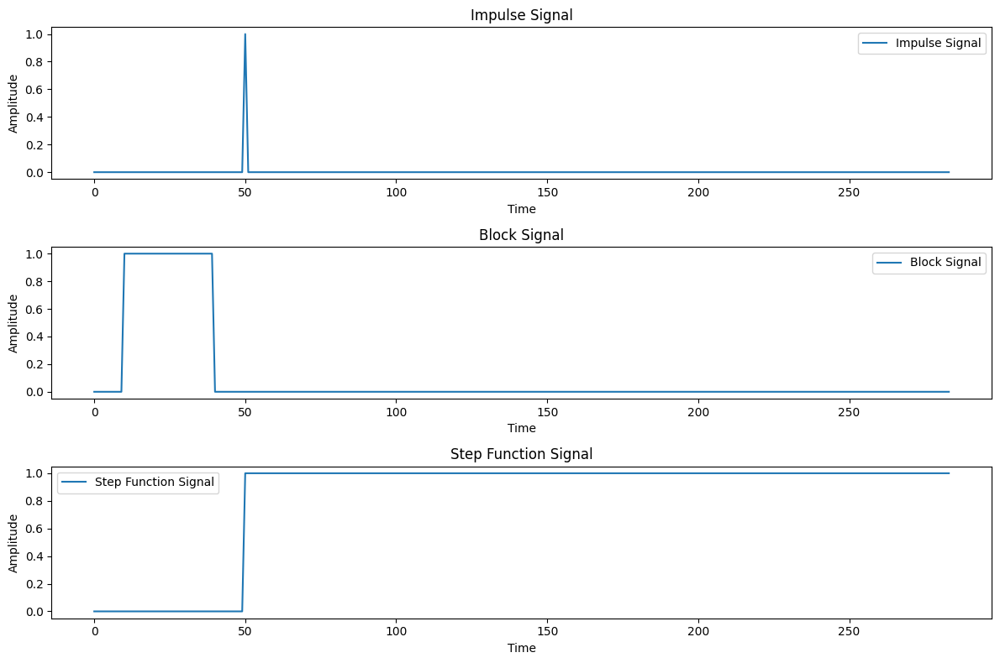

In [40]:
import torch
import numpy as np
import matplotlib.pyplot as plt

# Define the number of samples and timepoints
n_timepoints = 284

# Create impulse signals
impulse_positions = [50, 100, 150, 200, 250]  # positions for impulse signals (example)
impulse_tensor = torch.zeros((len(impulse_positions), n_timepoints, 1)).cpu()  # [n_samples, 284, 1]

# Set impulse signals to 1 at specified positions
for i in range(len(impulse_positions)):
    pos = impulse_positions[i]
    impulse_tensor[i, pos, 0] = 1

n_timepoints = 284

# Define block start and end positions for each tensor
block_configs = [
    (10, 40),   # Block 1
    (60, 80),  # Block 2
    (110, 150), # Block 3
    (160, 200), # Block 4
    (210, 250)  # Block 5
]

# Initialize tensor to store multiple blocks
block_tensor = torch.zeros((len(block_configs), n_timepoints, 1)).cpu()  # [n_samples, 284, 1]

# Set blocks for each sample
for i, (block_start, block_end) in enumerate(block_configs):
    block_tensor[i, block_start:block_end, 0] = 1

# Create step function signals (start at 0, jump to 1 after a specific timepoint)
step_positions = [50,100,150,200]  # Timepoint where step function jumps

step_tensor = torch.zeros((len(step_positions), n_timepoints, 1)).cpu()  # [n_samples, 284, 1]

# Set step function to 1 after step_position
for i in range(len(step_positions)):
    step_position = step_positions[i]
    step_tensor[i, step_position:, 0] = 1

# Plot the first sample from each signal
plt.figure(figsize=(12, 8))

# Plot Impulse Signal
plt.subplot(3, 1, 1)
plt.plot(impulse_tensor[0, :, 0].numpy(), label="Impulse Signal")
plt.title("Impulse Signal")
plt.xlabel("Time")
plt.ylabel("Amplitude")
plt.legend()

# Plot Block Signal
plt.subplot(3, 1, 2)
plt.plot(block_tensor[0, :, 0].numpy(), label="Block Signal")
plt.title("Block Signal")
plt.xlabel("Time")
plt.ylabel("Amplitude")
plt.legend()

# Plot Step Function Signal
plt.subplot(3, 1, 3)
plt.plot(step_tensor[0, :, 0].numpy(), label="Step Function Signal")
plt.title("Step Function Signal")
plt.xlabel("Time")
plt.ylabel("Amplitude")
plt.legend()

plt.tight_layout()
plt.show()


(84,) (44,)


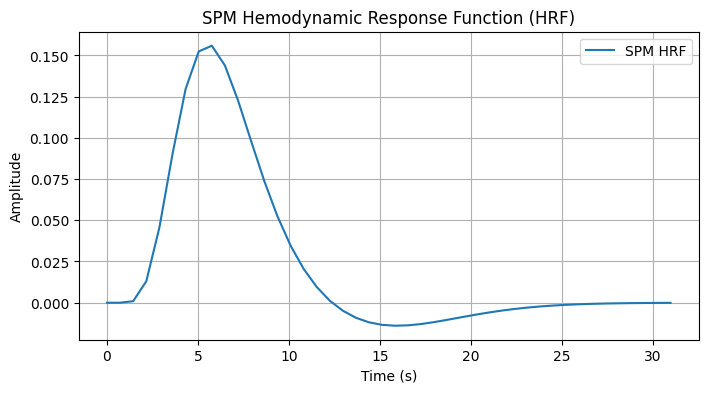

In [41]:
import numpy as np
import matplotlib.pyplot as plt
from nilearn.glm.first_level import spm_hrf

# Parameters
TR = 0.72  # Repetition time in seconds
frame_times = np.arange(0, 60, TR)  # Time points for 32 seconds at the given TR

# Compute the SPM HRF with matching sampling
hrf = spm_hrf(tr=TR, oversampling=1)  # Set oversampling=1 to match the TR
print(frame_times.shape,hrf.shape)
# Plot the HRF
plt.figure(figsize=(8, 4))
plt.plot(frame_times[:len(hrf[:])], hrf, label='SPM HRF')  # Match lengths
plt.title('SPM Hemodynamic Response Function (HRF)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.grid(True)
plt.legend()
plt.show()


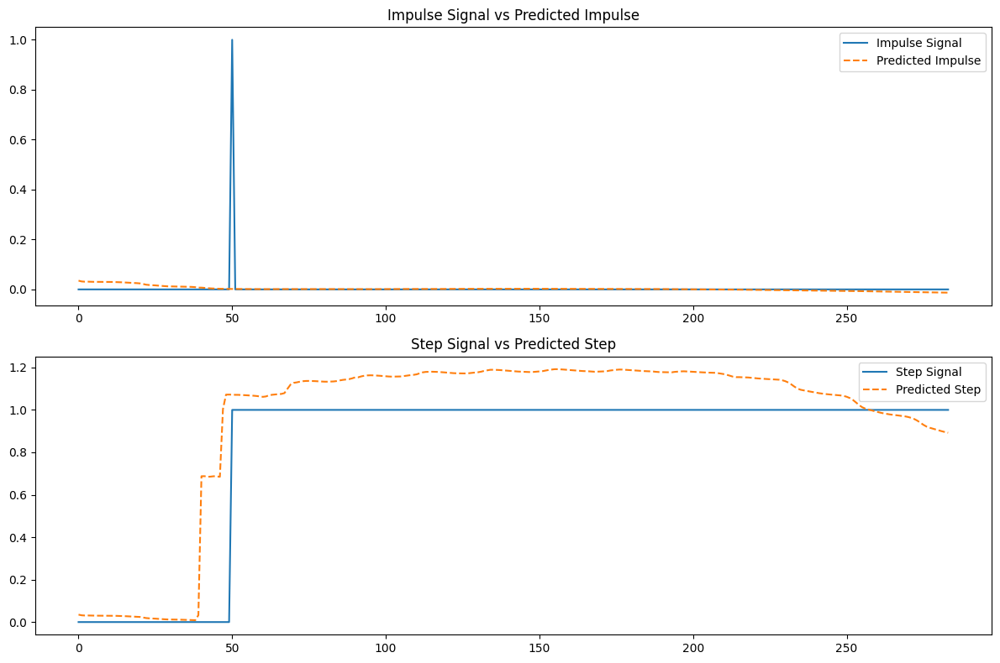

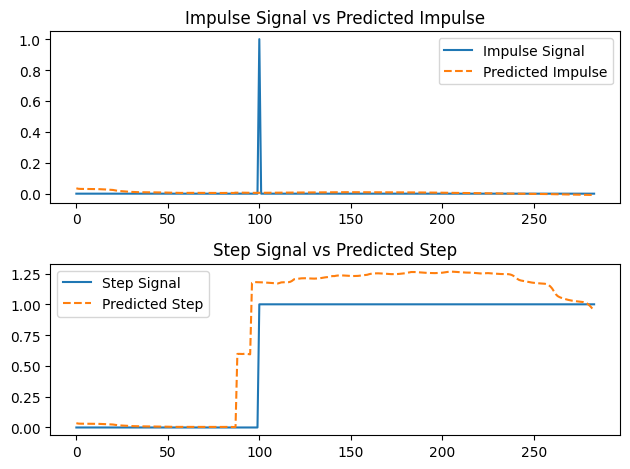

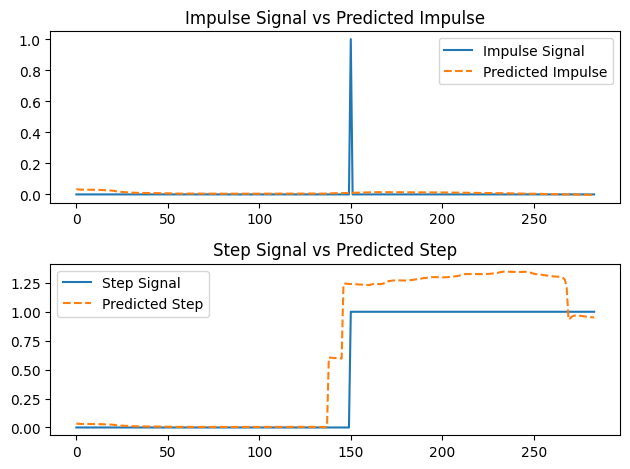

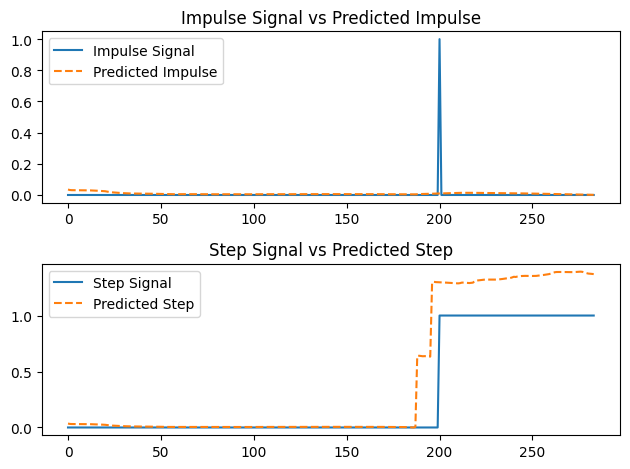

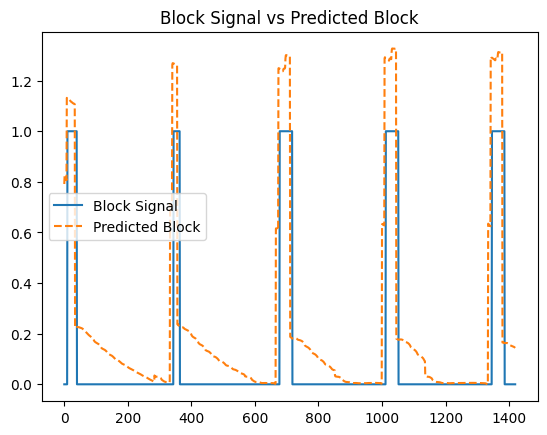

In [42]:
import matplotlib.pyplot as plt

# Ensure the model is in evaluation mode
model.eval()
hrf_tensor=torch.tensor(hrf,dtype=torch.float32).unsqueeze(-1).unsqueeze(0)
hrf_tensor=F.pad(hrf_tensor,(0,0,30,30), mode='constant', value=0)
hrf_tensor= (hrf_tensor-torch.mean(hrf_tensor,dim=1))/torch.std(hrf_tensor,dim=1)

# Disable gradient calculation for inference
with torch.no_grad():
    # Run the impulse, step, and block signals through the model
    impulse_pred = model(impulse_tensor.to(device)).cpu().numpy()
    step_pred = model(step_tensor.to(device)).cpu().numpy()
    block_pred = model(block_tensor.to(device)).cpu().numpy()

# Plotting the results
plt.figure(figsize=(12, 8))
for i in range(4):
    # Plot Impulse Signal and Prediction
    plt.subplot(2, 1, 1)
    plt.plot(impulse_tensor.cpu().numpy()[i], label='Impulse Signal')
    plt.plot(impulse_pred[i], label='Predicted Impulse', linestyle='--')
    plt.title("Impulse Signal vs Predicted Impulse")
    plt.legend()

    # Plot Step Signal and Prediction
    plt.subplot(2, 1, 2)
    plt.plot(step_tensor.cpu().numpy()[i], label='Step Signal')
    plt.plot(step_pred[i], label='Predicted Step', linestyle='--')
    plt.title("Step Signal vs Predicted Step")
    plt.legend()

    # Plot Block Signal and Prediction

    plt.tight_layout()
    plt.show()
plt.plot(block_tensor.cpu().numpy().flatten(), label='Block Signal')
plt.plot(block_pred.flatten(), label='Predicted Block', linestyle='--')
plt.title("Block Signal vs Predicted Block")
plt.legend()
plt.show()

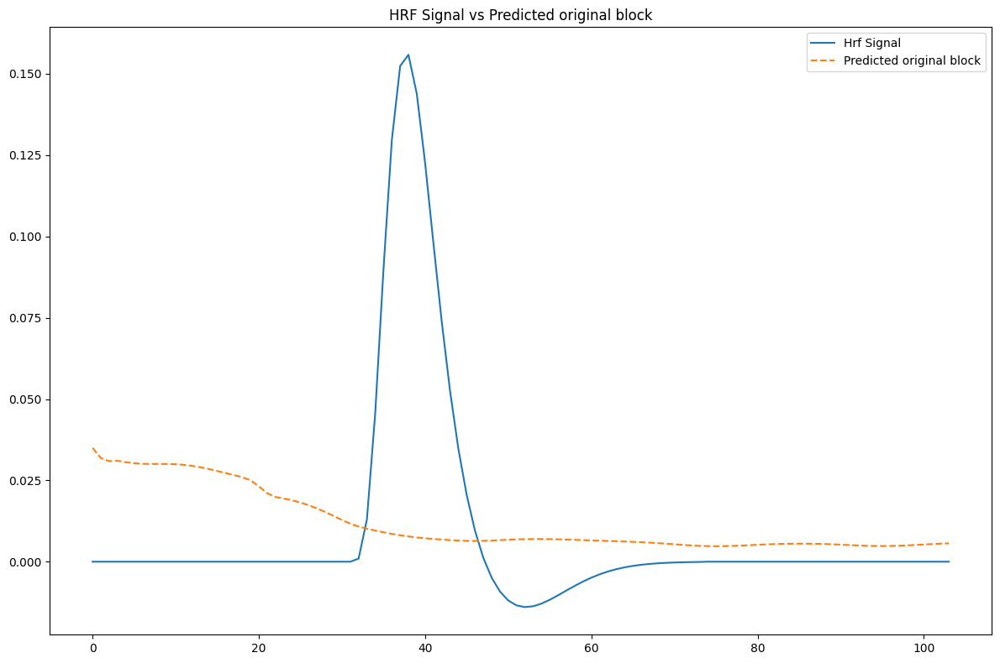

In [43]:
import matplotlib.pyplot as plt

# Ensure the model is in evaluation mode
model.eval()
hrf_tensor=torch.tensor(hrf,dtype=torch.float32).unsqueeze(-1).unsqueeze(0)
hrf_tensor=F.pad(hrf_tensor,(0,0,30,30), mode='constant', value=0)
#hrf_tensor= (hrf_tensor-torch.mean(hrf_tensor,dim=1))/torch.std(hrf_tensor,dim=1)

# Disable gradient calculation for inference
with torch.no_grad():
    # Run the impulse, step, and block signals through the model
    hrf_pred = model(hrf_tensor.to(device)).cpu().numpy()

# Plotting the results
plt.figure(figsize=(12, 8))
# Plot Impulse Signal and Prediction
plt.plot(hrf_tensor.cpu().numpy()[0], label='Hrf Signal')
plt.plot(hrf_pred[0], label='Predicted original block', linestyle='--')
plt.title("HRF Signal vs Predicted original block")
plt.legend()

plt.tight_layout()
plt.show()


In [44]:
train_of_blocks.shape

NameError: name 'train_of_blocks' is not defined

In [45]:
total_length = 284  # Total time points
block_length = 30   # Length of the block
n_samples = 284     # Number of samples (each shifted by 1)

# Create the initial block for the first sample
block = torch.zeros(total_length)
block[:block_length] = 1  # Set the first block to 1

# Use torch.roll to create shifted versions for each sample
tensor = torch.stack([torch.roll(block, shifts=i) for i in range(n_samples)])

# Reshape to add the singleton dimension
blocks_tensor = tensor.unsqueeze(-1)  # Shape: (n_samples, total_length, 1)



torch.Size([284, 1, 284])
pad torch.Size([284, 1, 386])
out torch.Size([284, 1, 283])
shuffle torch.Size([284, 283, 1])
torch.Size([284, 283, 1])
torch.Size([284, 284, 1])


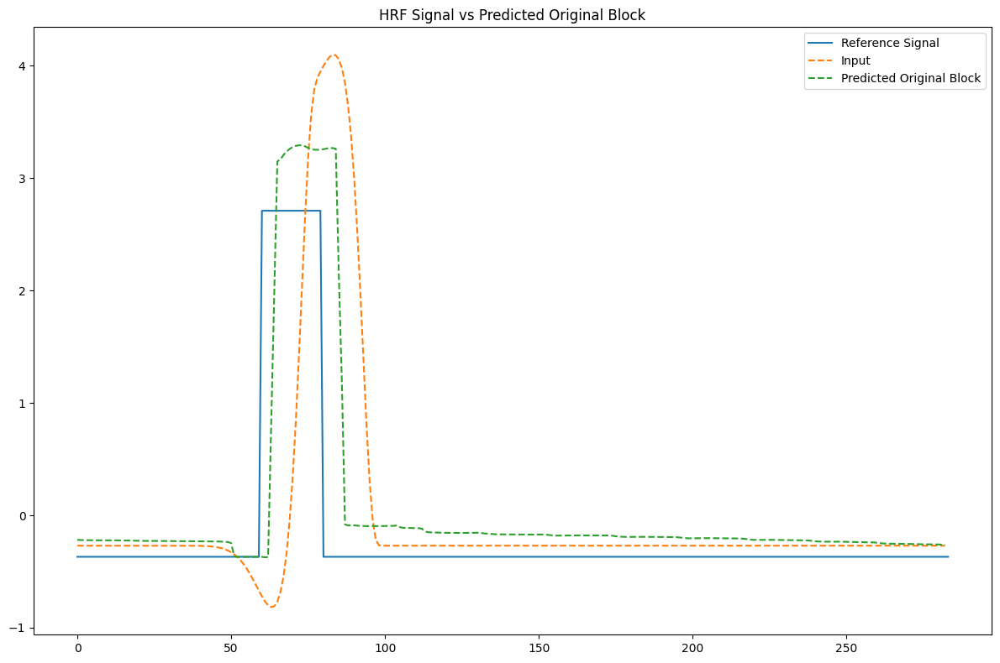

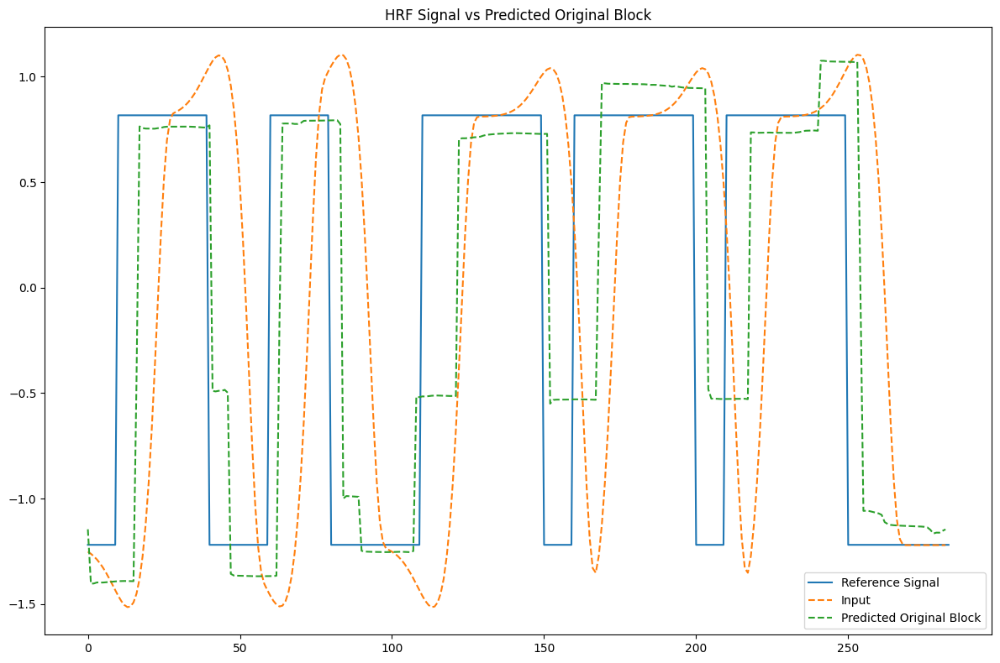

In [46]:
# Pad signals to ensure the output length matches the original signal length
def pad_signal(signal, kernel):
    padding = (kernel.shape[-1] - 1) // 2
    return F.pad(signal, (padding, padding), mode='constant', value=0)

# Convolved HRF with block and train of blocks
train_of_blocks = torch.sum(block_tensor, dim=0, keepdim=True)
signal1 = train_of_blocks.view(1, 1, -1)  # Shape: (1, 1, len(signal1))
signal2 = block_tensor[1, :, :].view(1, 1, -1)  # Shape: (1, 1, len(signal1))
signal4 = blocks_tensor.view(284,1,-1)
print(signal4.shape)
signal3 = hrf_tensor.flip(0).view(1, 1, -1)  # Shape: (1, 1, len(signal2)), flipped for convolution

# Pad signals
signal1_padded = pad_signal(signal1, signal3)
signal2_padded = pad_signal(signal2, signal3)
signal4_padded = pad_signal(signal4, signal3)
print("pad",signal4_padded.shape)
# Perform convolution
output_train = F.conv1d(signal1_padded, signal3)
output_block = F.conv1d(signal2_padded, signal3)
output_blocks = F.conv1d(signal4_padded, signal3)
print("out",output_blocks.shape)
# Flatten the output for interpretation
convolved_train = output_train.permute(0, 2, 1)
convolved_single = output_block.permute(0, 2, 1)
convolved_blocks = output_blocks.permute(0, 2, 1)
print("shuffle",convolved_blocks.shape)
# Z-score for input into NN
zscore_block = (block_tensor - torch.mean(block_tensor)) / torch.std(block_tensor)
zscore_blocks = (blocks_tensor - torch.mean(blocks_tensor,dim=1)) / torch.std(blocks_tensor,dim=1)
zscore_train = (train_of_blocks - torch.mean(train_of_blocks)) / torch.std(train_of_blocks)
zscore_c_train = (convolved_train - torch.mean(convolved_train)) / torch.std(convolved_train)
zscore_c_block = (convolved_single - torch.mean(convolved_single)) / torch.std(convolved_single)
zscore_c_blocks = (convolved_blocks - torch.mean(convolved_blocks,dim=1,keepdim=True)) / torch.std(convolved_blocks,dim=1,keepdim=True)
zscore_c_blocks.contiguous()
# Ensure the model is in evaluation mode
model.eval()
# Disable gradient calculation for inference
with torch.no_grad():
    # Run the impulse, step, and block signals through the model
    zscore_c_train_pred = model(zscore_c_train.to(device)).cpu().numpy()
    zscore_c_block_pred = model(zscore_c_block.to(device)).cpu().numpy()
    
print(zscore_c_blocks.shape)
print(blocks_tensor.shape)
dataset_blocks = TensorDataset(zscore_c_blocks,blocks_tensor)  # Create a dataset from the tensor
dataloader_blocks = DataLoader(dataset_blocks, batch_size=batch_size)

# To store all predictions
all_predictions = []

# Run inference
with torch.no_grad():
    for batch_x,batch_y in dataloader_blocks:
        batch_input = batch_x.to(device)  # Move batch to device
        predictions = model(batch_input)  # Forward pass
        all_predictions.append(predictions.cpu())  # Store predictions on CPU to save GPU memory

# Concatenate all predictions into a single tensor
zscore_c_blocks_pred = torch.cat(all_predictions, dim=0)  # Merge along the batch dimension
# Plotting the results
plt.figure(figsize=(12, 8))
# Plot Impulse Signal and Prediction
plt.plot(zscore_block.cpu().numpy()[1], label='Reference Signal')
plt.plot(zscore_c_block[0], label='Input', linestyle='--')
plt.plot(zscore_c_block_pred[0], label='Predicted Original Block', linestyle='--')
plt.title("HRF Signal vs Predicted Original Block")
plt.legend()

plt.tight_layout()
plt.show()

# Plotting the results
plt.figure(figsize=(12, 8))
# Plot Impulse Signal and Prediction
plt.plot(zscore_train.cpu().numpy()[0], label='Reference Signal')
plt.plot(zscore_c_train[0], label='Input', linestyle='--')
plt.plot(zscore_c_train_pred[0], label='Predicted Original Block', linestyle='--')
plt.title("HRF Signal vs Predicted Original Block")
plt.legend()

plt.tight_layout()
plt.show()


In [479]:
batch_size

32

torch.Size([284, 283, 1])
torch.Size([284, 283, 1])
torch.Size([284, 284, 1])
torch.Size([284, 283, 1])


<IPython.core.display.Javascript object>


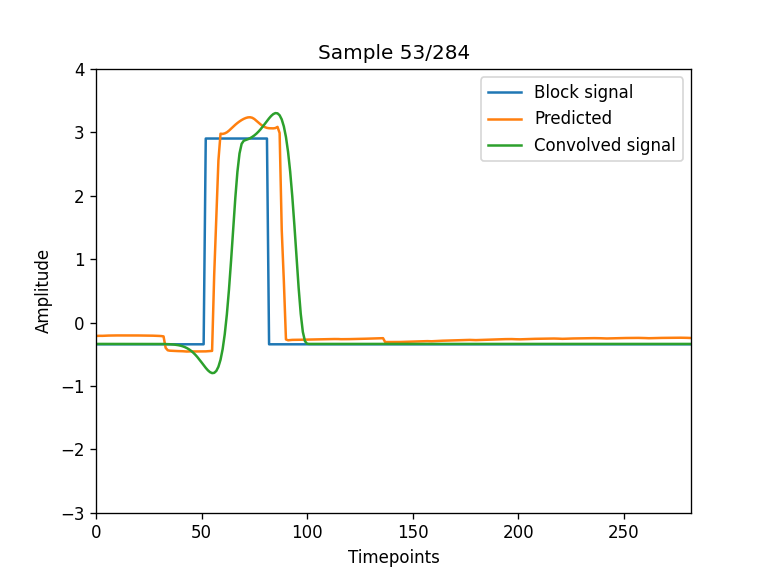

In [42]:
print(zscore_c_blocks_pred.shape)
print(zscore_c_blocks.shape)
print(zscore_blocks.shape)
zscore_blocks_1 = zscore_blocks[:,:-1,:]
print(zscore_blocks_1.shape)
from matplotlib.animation import FuncAnimation
%matplotlib notebook
# Simulate your tensors (replace these with your actual tensors)
n_samples = 284  # Number of samples
timepoints = 283  # Number of timepoints
# Prepare the figure
fig, ax = plt.subplots()
line1, = ax.plot([], [], label="Block signal")
line2, = ax.plot([], [], label="Predicted")
line3, = ax.plot([], [], label="Convolved signal")

ax.set_xlim(0, timepoints - 1)
ax.set_ylim(-3, 4)  # Adjust based on your data
ax.set_xlabel("Timepoints")
ax.set_ylabel("Amplitude")
ax.legend(loc="upper right")

# Update function for animation
def update(sample_idx):
    line1.set_data(np.arange(timepoints), zscore_blocks_1[sample_idx, :, 0])
    line2.set_data(np.arange(timepoints), zscore_c_blocks_pred[sample_idx, :, 0])
    line3.set_data(np.arange(timepoints), zscore_c_blocks[sample_idx, :, 0])
    ax.set_title(f"Sample {sample_idx + 1}/{n_samples}")
    return line1, line2

# Create the animation
ani = FuncAnimation(fig, update, frames=n_samples, interval=50, blit=True)
# Show the animation
plt.show()

In [121]:
merged =  xr.load_dataset("/media/RCPNAS/Data2/CS-433-ML4S/data/derivatives/dataset_EMOTION_1_subjects_normed.nc")
merged =  xr.load_dataset("/media/RCPNAS/Data2/CS-433-ML4S/data/derivatives/dataset_LANGUAGE_1_subjects_normed.nc")
merged =  xr.load_dataset("/media/RCPNAS/Data2/CS-433-ML4S/data/derivatives/dataset_WM_1_subjects_normed.nc")
merged =  xr.load_dataset("/media/RCPNAS/Data2/CS-433-ML4S/data/derivatives/dataset_RELATIONAL_1_subjects_normed.nc")


In [184]:
merged =  xr.load_dataset("/media/RCPNAS/Data2/CS-433-ML4S/data/derivatives/dataset_LANGUAGE_30_subjects_normed.nc")

merged

<xarray.Dataset> Size: 896MB
Dimensions:  (voxel: 1968, time: 316, subject: 60)
Coordinates:
  * voxel    (voxel) int64 16kB 0 1 2 3 4 5 6 ... 1962 1963 1964 1965 1966 1967
  * time     (time) int64 3kB 0 1 2 3 4 5 6 7 ... 309 310 311 312 313 314 315
  * subject  (subject) <U9 2kB '221319_RL' '148840_RL' ... '190031_LR'
    task     <U8 32B 'LANGUAGE'
Data variables:
    X        (subject, voxel, time) float64 299MB 1.367 -4.905 ... nan nan
    Y        (subject, voxel, time) float64 299MB 1.05 1.05 1.05 ... nan nan nan
    Y_conv   (subject, voxel, time) float64 299MB -1.443 -1.414 ... nan nan
Attributes:
    description:  Dataset for subject 221319, task LANGUAGE, acquisition RL

In [188]:
#dataset_test=merged.sel(subject="127630_LR")
dataset_test=merged.sel(subject="221319_RL")



In [189]:
dataset_test.task

<xarray.DataArray 'task' ()> Size: 32B
array('LANGUAGE', dtype='<U8')
Coordinates:
    subject  <U9 36B '221319_RL'
    task     <U8 32B 'LANGUAGE'

In [190]:
def custom_progress_bar(current, total, description="Processing"):
    percent = int((current / total) * 100)
    bar = f"[{'#' * (percent // 2)}{'-' * (50 - percent // 2)}] {percent}%"
    sys.stdout.write(f"\r{description}: {bar}")
    sys.stdout.flush()
def concat_data_mod(all_X_train, all_Y_train):
    """
    Concatenate the data from all subjects into one large dataset.

    Parameters:
    - all_X_train: List of tensors, each containing training data for a subject.
    - all_Y_train: List of tensors, each containing labels for a subject.

    Returns:
    - Concatenated tensors for training, validation, and test sets.
    """

    # Concatenate lists into tensors
    X_train_def = torch.cat(all_X_train, dim=0).unsqueeze(-1)
    Y_train_def = torch.cat(all_Y_train, dim=0).unsqueeze(-1)

    return X_train_def,  Y_train_def

def get_data_tensors_mod(subject_ids):

    all_X_train, all_X_val, all_X_test = [], [], []
    all_Y_train, all_Y_val, all_Y_test = [], [], []
    print("\nProcessing Train Subjects:")

    # Process train subjects
    for idx, train_subj in enumerate(subject_ids, 1):
        subject_data = merged.sel(subject=train_subj)  # Extract subject data
        X_train_tensor, Y_train_tensor = preprocess_subject_data(subject_data)
        # Augment training data
        # Apply temporal scaling to the augmented data
        all_X_train.append(X_train_tensor)
        all_Y_train.append(Y_train_tensor)
        custom_progress_bar(idx, len(subject_ids))



    # Concatenate data for all subjects
    X_train_def, Y_train_def= concat_data_mod(
        all_X_train,all_Y_train)
    print()
    print("X_train",X_train_def.shape)
    print("Y_train",Y_train_def.shape)

    return X_train_def, Y_train_def


In [191]:
subjects_ids = dataset_test.subject.values
#subjects_ids = merged.subject.values

X_tasks, Y_tasks = get_data_tensors_mod([subjects_ids])
print(X_tasks.shape,Y_tasks.shape)


Processing Train Subjects:
Data preprocess
Remove rows with NaNs in any voxel time series
Normalize BOLD signal (X)
Convert to PyTorch tensors
Processing: [##################################################] 100%
X_train torch.Size([1936, 316, 1])
Y_train torch.Size([1936, 316, 1])
torch.Size([1936, 316, 1]) torch.Size([1936, 316, 1])


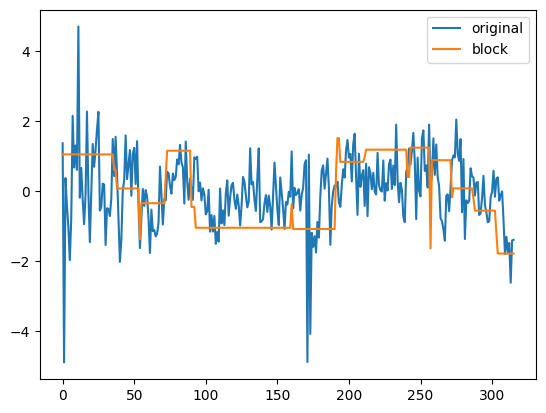

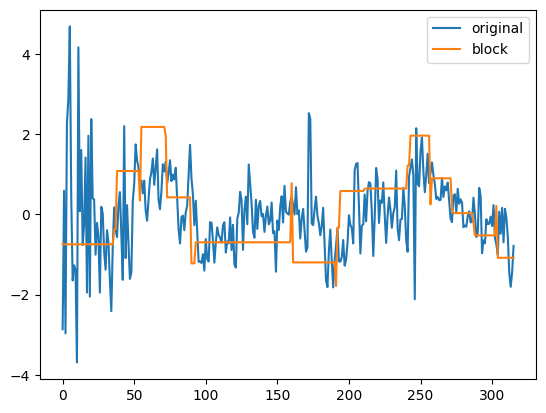

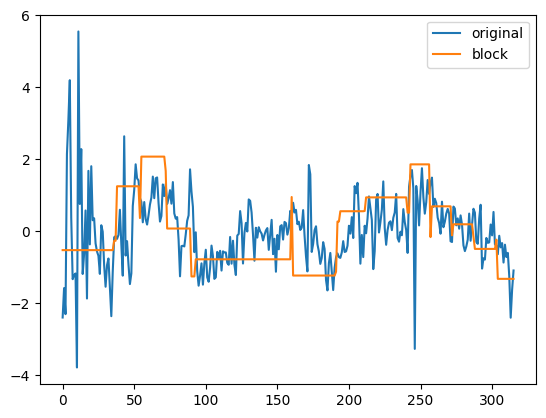

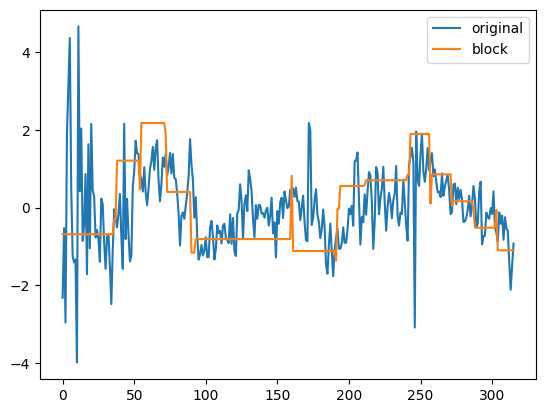

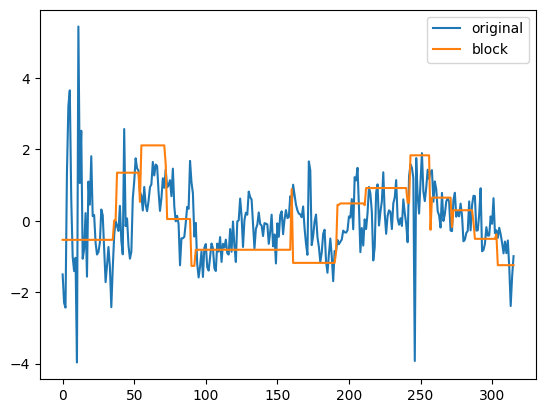

In [192]:

for i in range (5):
    x,y = X_tasks[-i,:],Y_tasks[-i,:]
    plt.plot(x,label="original")
    plt.plot(y,label='block')
    plt.legend()
    plt.show()

In [193]:
task_dataset = TensorDataset(X_tasks, Y_tasks)
task_loader = DataLoader(task_dataset, batch_size=batch_size, shuffle=True)


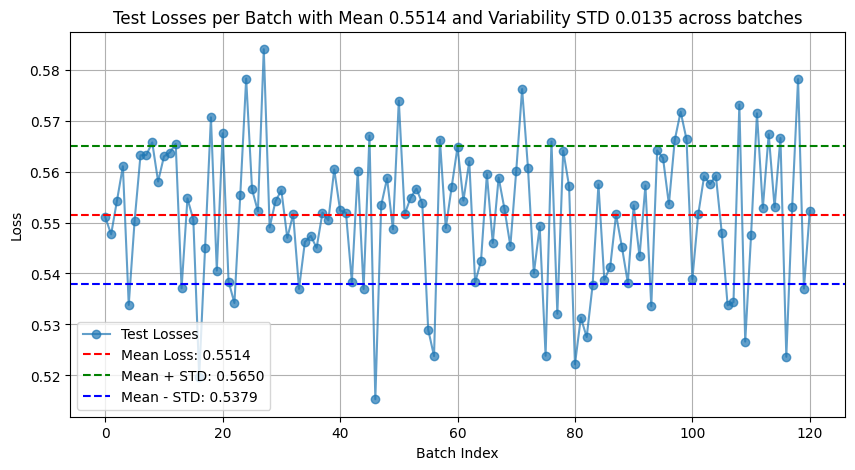

In [194]:
model.eval()
total_test_loss = 0
loss_list = []
with torch.no_grad():
    for batch_x, batch_y in task_loader:
        batch_x, batch_y = batch_x.to(device), batch_y.to(device)
        predictions = model(batch_x)
        loss = criterion(predictions, batch_y)
        #print(loss)
        total_test_loss += loss.item()
        loss_list.append(loss.item())

avg_test_loss = np.mean(loss_list)
std_test_loss = np.std(loss_list)

# Line plot of losses
plt.figure(figsize=(10, 5))
plt.plot(loss_list, marker='o', alpha=0.7, label='Test Losses')
plt.axhline(avg_test_loss, color='red', linestyle='--', label=f'Mean Loss: {avg_test_loss:.4f}')
plt.axhline(avg_test_loss + std_test_loss, color='green', linestyle='--', label=f'Mean + STD: {avg_test_loss + std_test_loss:.4f}')
plt.axhline(avg_test_loss - std_test_loss, color='blue', linestyle='--', label=f'Mean - STD: {avg_test_loss - std_test_loss:.4f}')
plt.xlabel('Batch Index')
plt.ylabel('Loss')
plt.title(f'Test Losses per Batch with Mean {avg_test_loss:.4f} and Variability STD {std_test_loss:.4f} across batches')
plt.legend()
plt.grid(True)
plt.show()

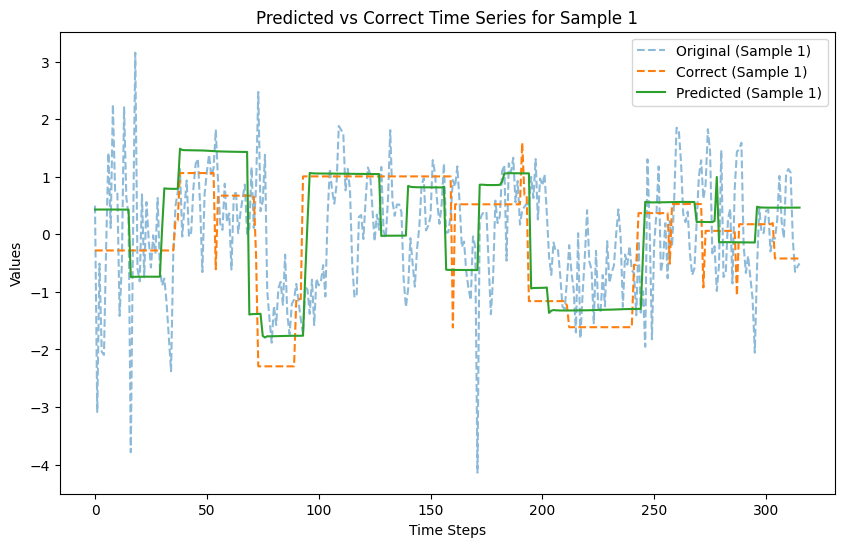

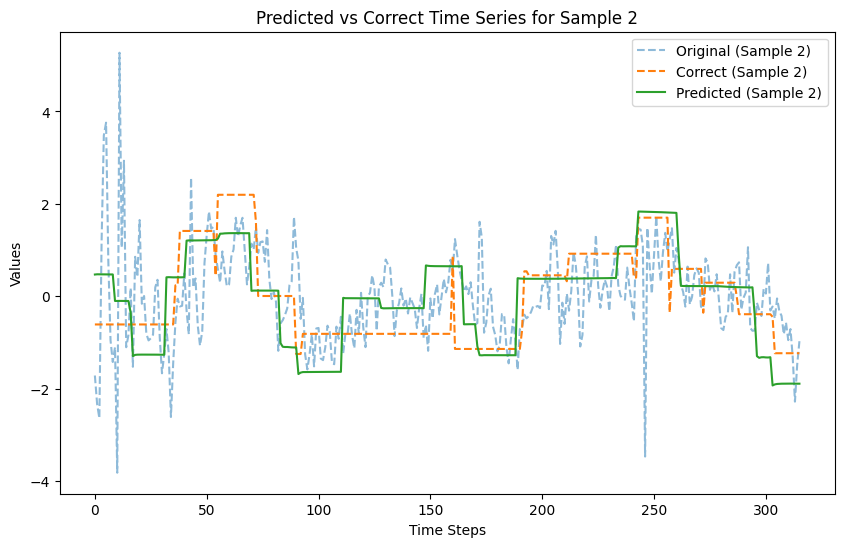

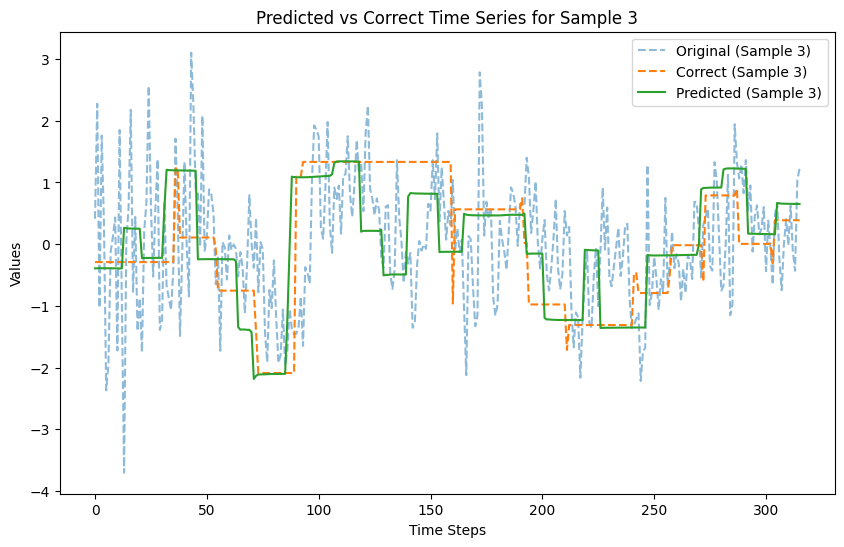

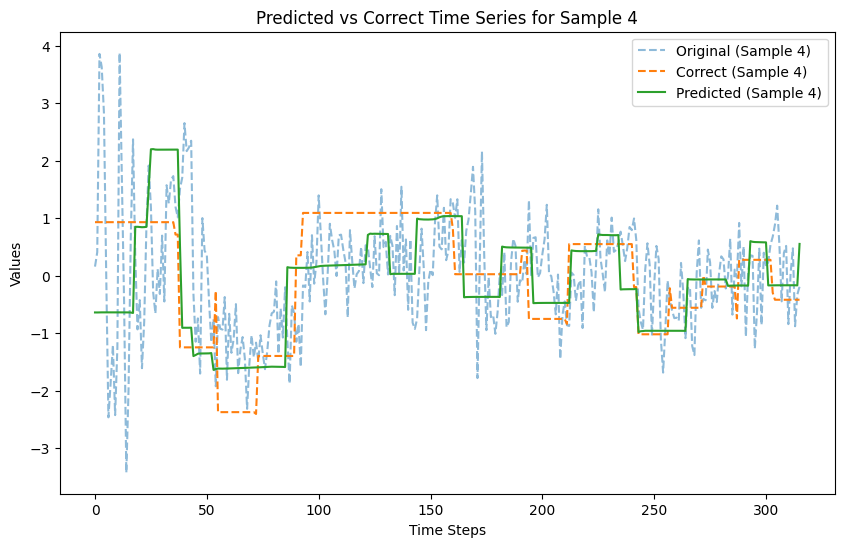

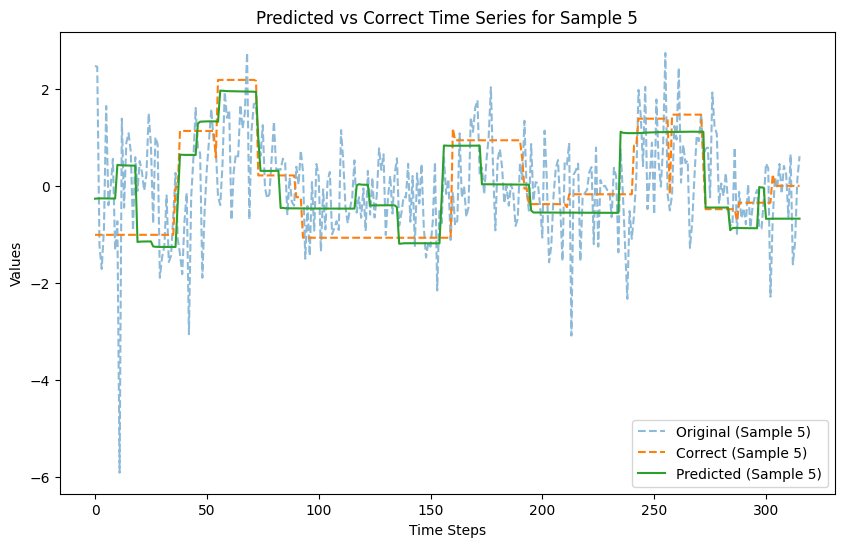

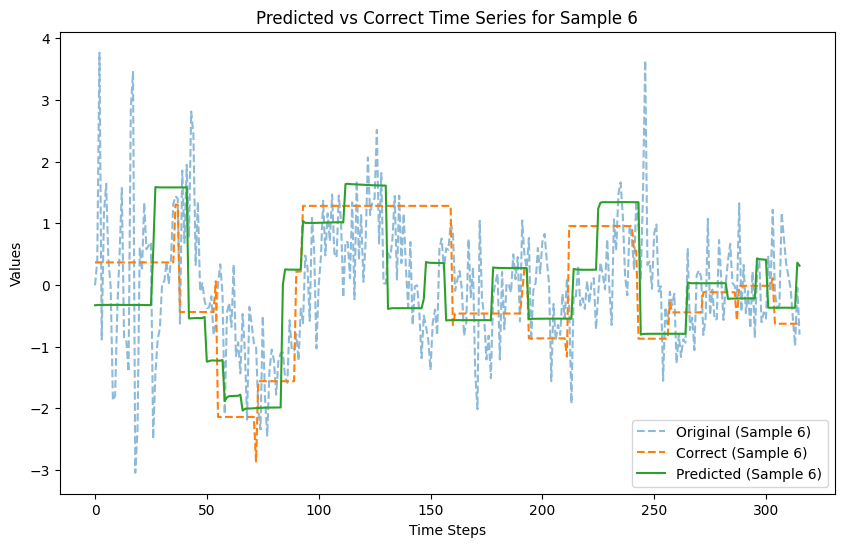

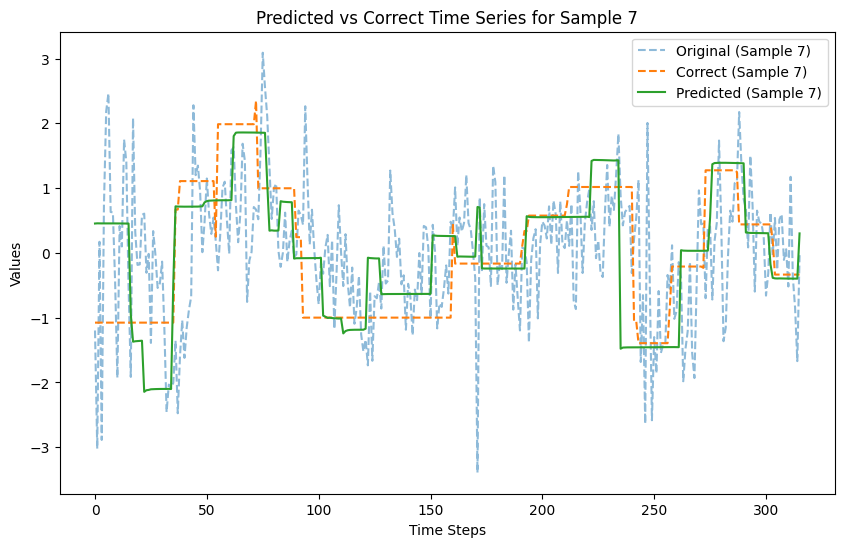

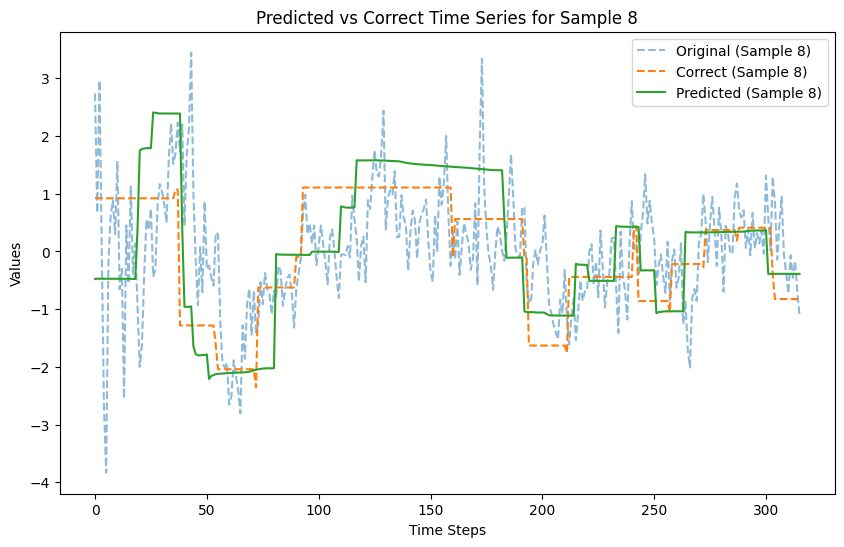

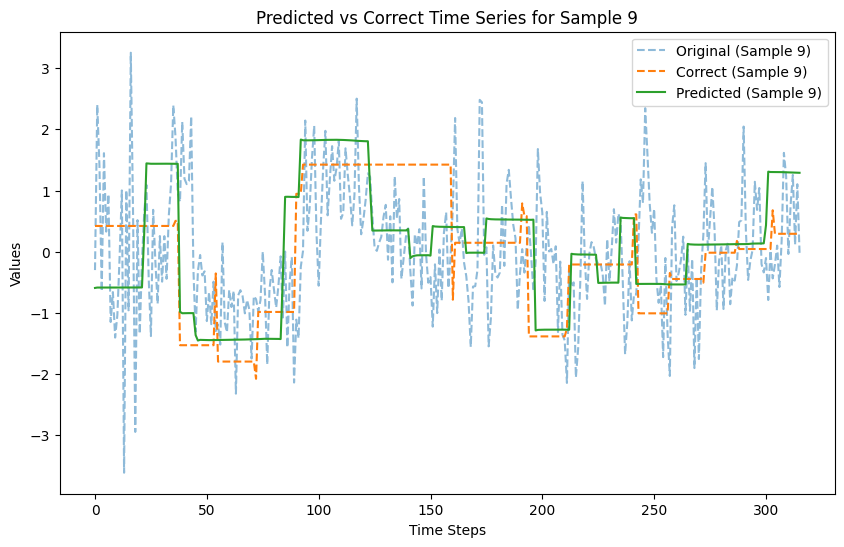

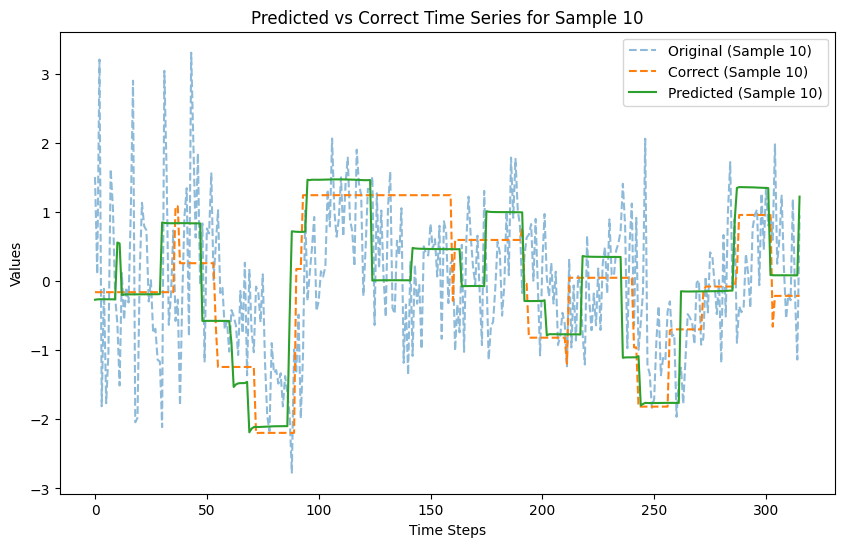

In [195]:
import matplotlib.pyplot as plt
# Assuming the model is already trained
model.eval()  # Set the model to evaluation mode

# Select one batch of test data from the loader
for X_sample, Y_sample in task_loader:
    X_sample, Y_sample = X_sample.to(device), Y_sample.to(device)
    break  # Take the first batch

for i in range(10):
    X_sample_single = X_sample[i]
    Y_sample_single = Y_sample[i]

    # Get the prediction
    with torch.no_grad():
        Y_pred_single = model(X_sample_single.unsqueeze(0))  # Add batch dimension
        Y_pred_single = Y_pred_single.squeeze(0)  # Remove batch dimension

    # Convert to numpy for plotting
    Y_sample_single = Y_sample_single.cpu().numpy()
    Y_pred_single = Y_pred_single.cpu().numpy()
    X_sample_single = X_sample_single.cpu().numpy()
    # Plot
    plt.figure(figsize=(10, 6))
    plt.plot(X_sample_single, label=f'Original (Sample {i+1})', linestyle='--',alpha=0.5)

    plt.plot(Y_sample_single, label=f'Correct (Sample {i+1})', linestyle='--')
    plt.plot(Y_pred_single, label=f'Predicted (Sample {i+1})', linestyle='-')
    plt.xlabel('Time Steps')
    plt.ylabel('Values')
    plt.title(f'Predicted vs Correct Time Series for Sample {i+1}')
    plt.legend()
    plt.show()

In [78]:
merged_bis =  xr.load_dataset("/media/RCPNAS/Data2/CS-433-ML4S/data/derivatives/dataset_EMOTION_100_subjects_normed.nc")
def custom_progress_bar(current, total, description="Processing"):
    percent = int((current / total) * 100)
    bar = f"[{'#' * (percent // 2)}{'-' * (50 - percent // 2)}] {percent}%"
    sys.stdout.write(f"\r{description}: {bar}")
    sys.stdout.flush()
def concat_data_mod(all_X_train, all_Y_train):
    """
    Concatenate the data from all subjects into one large dataset.

    Parameters:
    - all_X_train: List of tensors, each containing training data for a subject.
    - all_Y_train: List of tensors, each containing labels for a subject.

    Returns:
    - Concatenated tensors for training, validation, and test sets.
    """

    # Concatenate lists into tensors
    X_train_def = torch.cat(all_X_train, dim=0).unsqueeze(-1)
    Y_train_def = torch.cat(all_Y_train, dim=0).unsqueeze(-1)

    return X_train_def,  Y_train_def

def get_data_tensors_mod(subject_ids):

    all_X_train, all_X_val, all_X_test = [], [], []
    all_Y_train, all_Y_val, all_Y_test = [], [], []
    print("\nProcessing Train Subjects:")

    # Process train subjects
    for idx, train_subj in enumerate(subject_ids, 1):
        subject_data = merged_bis.sel(subject=train_subj)  # Extract subject data
        X_train_tensor, Y_train_tensor = preprocess_subject_data(subject_data)
        # Augment training data
        # Apply temporal scaling to the augmented data
        all_X_train.append(X_train_tensor)
        all_Y_train.append(Y_train_tensor)
        custom_progress_bar(idx, len(subject_ids))



    # Concatenate data for all subjects
    X_train_def, Y_train_def= concat_data_mod(
        all_X_train,all_Y_train)
    print()
    print("X_train",X_train_def.shape)
    print("Y_train",Y_train_def.shape)

    return X_train_def, Y_train_def


In [79]:
dataset_test=merged_bis#.sel(subject="127630_RL")
subjects_ids = dataset_test.subject.values

X_tasks, Y_tasks = get_data_tensors_mod([subjects_ids])
print(X_tasks.shape,Y_tasks.shape)

for i in range (5):
    x,y = X_tasks[-i,:],Y_tasks[-i,:]
    plt.plot(x,label="original")
    plt.plot(y,label='block')
    plt.legend()
    plt.show()
task_dataset = TensorDataset(X_tasks, Y_tasks)
task_loader = DataLoader(task_dataset, batch_size=batch_size, shuffle=True)
model.eval()
total_test_loss = 0
loss_list = []
with torch.no_grad():
    for batch_x, batch_y in task_loader:
        batch_x, batch_y = batch_x.to(device), batch_y.to(device)
        predictions = model(batch_x)
        loss = criterion(predictions, batch_y)
        #print(loss)
        total_test_loss += loss.item()
        loss_list.append(loss.item())

avg_test_loss = np.mean(loss_list)
std_test_loss = np.std(loss_list)

# Line plot of losses
plt.figure(figsize=(10, 5))
plt.plot(loss_list, marker='o', alpha=0.7, label='Test Losses')
plt.axhline(avg_test_loss, color='red', linestyle='--', label=f'Mean Loss: {avg_test_loss:.4f}')
plt.axhline(avg_test_loss + std_test_loss, color='green', linestyle='--', label=f'Mean + STD: {avg_test_loss + std_test_loss:.4f}')
plt.axhline(avg_test_loss - std_test_loss, color='blue', linestyle='--', label=f'Mean - STD: {avg_test_loss - std_test_loss:.4f}')
plt.xlabel('Batch Index')
plt.ylabel('Loss')
plt.title(f'Test Losses per Batch with Mean {avg_test_loss:.4f} and Variability STD {std_test_loss:.4f} across batches')
plt.legend()
plt.grid(True)
plt.show()
import matplotlib.pyplot as plt
# Assuming the model is already trained
model.eval()  # Set the model to evaluation mode

# Select one batch of test data from the loader
for X_sample, Y_sample in task_loader:
    X_sample, Y_sample = X_sample.to(device), Y_sample.to(device)
    break  # Take the first batch

for i in range(10):
    X_sample_single = X_sample[i]
    Y_sample_single = Y_sample[i]

    # Get the prediction
    with torch.no_grad():
        Y_pred_single = model(X_sample_single.unsqueeze(0))  # Add batch dimension
        Y_pred_single = Y_pred_single.squeeze(0)  # Remove batch dimension

    # Convert to numpy for plotting
    Y_sample_single = Y_sample_single.cpu().numpy()
    Y_pred_single = Y_pred_single.cpu().numpy()
    X_sample_single = X_sample_single.cpu().numpy()
    # Plot
    plt.figure(figsize=(10, 6))
    plt.plot(X_sample_single, label=f'Original (Sample {i+1})', linestyle='--')

    plt.plot(Y_sample_single, label=f'Correct (Sample {i+1})', linestyle='--')
    plt.plot(Y_pred_single, label=f'Predicted (Sample {i+1})', linestyle='-')
    plt.xlabel('Time Steps')
    plt.ylabel('Values')
    plt.title(f'Predicted vs Correct Time Series for Sample {i+1}')
    plt.legend()
    plt.show()


Processing Train Subjects:
Data preprocess
Remove rows with NaNs in any voxel time series


IndexError: boolean index did not match indexed array along axis 1; size of axis is 1989 but size of corresponding boolean axis is 176

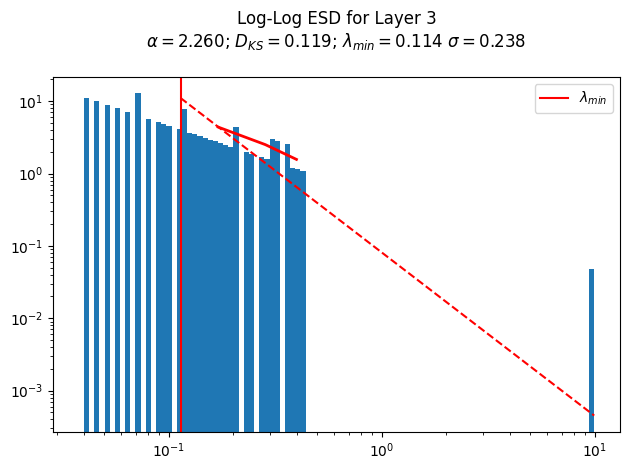

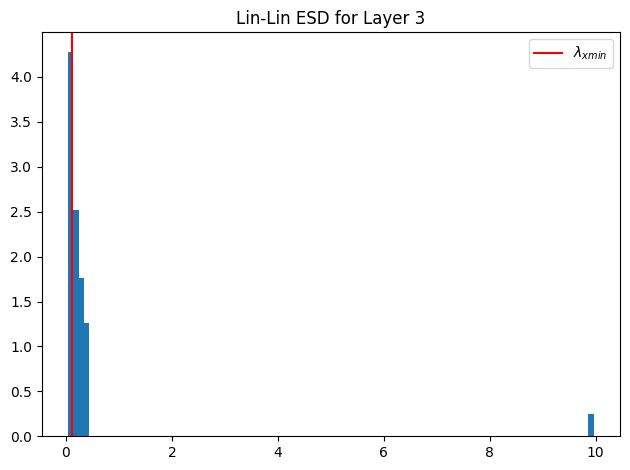

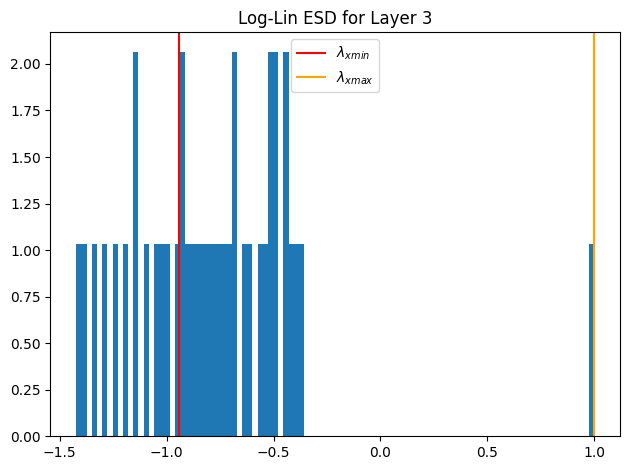

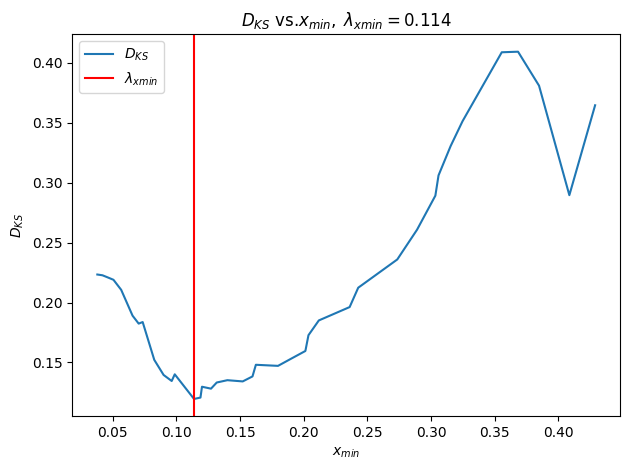

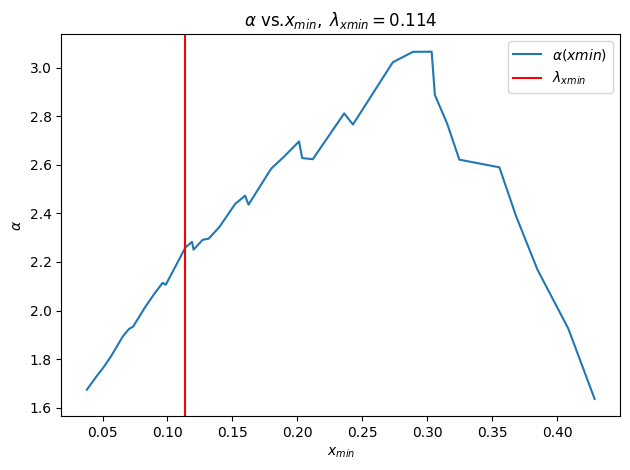

<Figure size 640x480 with 0 Axes>

In [80]:
import weightwatcher as ww
watcher = ww.WeightWatcher(model=model)
details = watcher.analyze(plot=True)

In [81]:
import pandas as pd
pd.set_option('display.max_columns', None)  # Show all columns
pd.set_option('display.max_rows', 2)     # Show all rows (optional)
pd.set_option('display.width', None)        # No limit to line width
pd.set_option('display.expand_frame_repr', True)  # Disable wrapping to multiple lines

print(details)

   layer_id    name         D   M    N    Q     alpha  alpha_weighted  \
0         3  Linear  0.119475  40  120  3.0  2.260043        2.256278   

    entropy  has_esd  lambda_max layer_type  log_alpha_norm  log_norm  \
0  0.584457     True    9.961713      dense        2.259488  1.236072   

   log_spectral_norm       longname  matrix_rank       norm  num_evals  \
0           0.998334  kernel_rnn.fc           40  17.221525         40   

   num_pl_spikes  rank_loss  rf     sigma  spectral_norm  stable_rank  \
0             28          0   1  0.238126       9.961713     1.728771   

    status    sv_max    sv_min warning  weak_rank_loss      xmax      xmin  
0  success  3.156218  0.194673                       0  9.961713  0.113849  


In [82]:
watcher.analyze()

,layer_id,name,D,M,N,Q,alpha,alpha_weighted,entropy,has_esd,lambda_max,layer_type,log_alpha_norm,log_norm,log_spectral_norm,longname,matrix_rank,norm,num_evals,num_pl_spikes,rank_loss,rf,sigma,spectral_norm,stable_rank,status,sv_max,sv_min,warning,weak_rank_loss,xmax,xmin
0,3,Linear,0.119475,40,120,3.0,2.260043,2.256278,0.584457,True,9.961713,dense,2.259488,1.236072,0.998334,kernel_rnn.fc,40,17.221525,40,28,0,1,0.238126,9.961713,1.728771,success,3.156218,0.194673,,0,9.961713,0.113849


(84,) (44,)


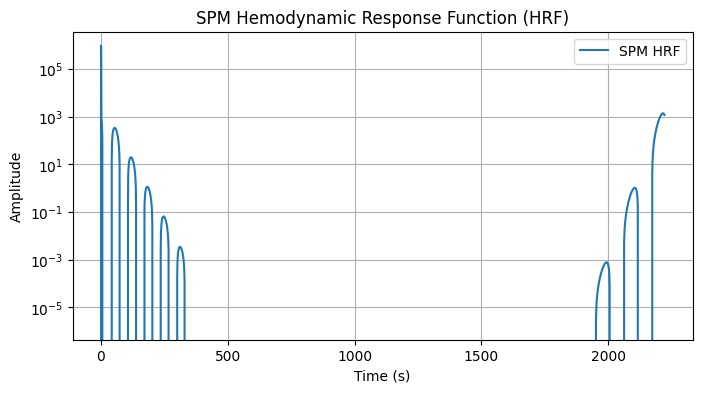

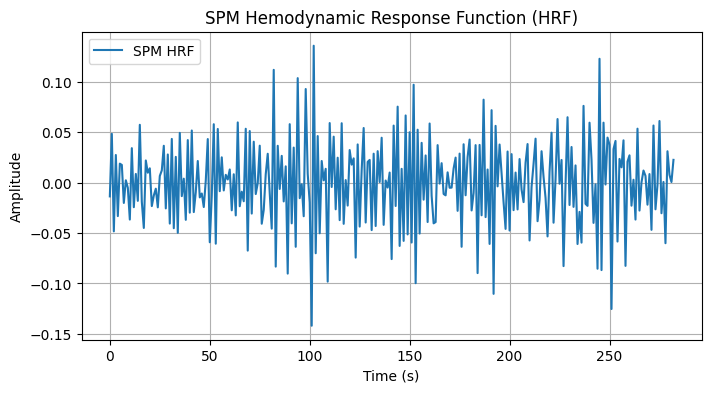

In [109]:
import numpy as np
import matplotlib.pyplot as plt
from nilearn.glm.first_level import spm_hrf

# Parameters
TR = 0.72  # Repetition time in seconds

# Compute the SPM HRF with matching sampling
hrf_original = spm_hrf(tr=TR)  # Set oversampling=1 to match the TR
import scipy.signal

def deconvolutional_kernel(B, epsilon=1e-100):
    # Fourier Transform of B
    B_fft = np.fft.fft(B)

    # Compute the inverse of FFT(B), avoiding division by zero
    B_fft_inverse = 1 / (B_fft + epsilon)

    # Inverse Fourier Transform to get the deconvolutional kernel
    kernel = np.fft.ifft(B_fft_inverse).real
    return kernel

def recover_signal(C, kernel):
    # Convolve C with the deconvolutional kernel to get A
    A = scipy.signal.convolve(C, kernel, mode='same')
    return A

# Get the deconvolutional kernel
kernel = deconvolutional_kernel(hrf_original)

# Recover the original signal A
A = recover_signal(zscore_c_blocks[40,:,0], kernel)

print(frame_times.shape,hrf.shape)
# Plot the HRF
plt.figure(figsize=(8, 4))
plt.plot(-(kernel), label='SPM HRF')  # Match lengths
plt.title('SPM Hemodynamic Response Function (HRF)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.yscale('log')
plt.grid(True)
plt.legend()
plt.show()

plt.figure(figsize=(8, 4))
plt.plot(A, label='SPM HRF')  # Match lengths
plt.title('SPM Hemodynamic Response Function (HRF)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
#plt.yscale('log')
plt.grid(True)
plt.legend()
plt.show()
